In [2006]:
source("R/docker_linseed_pipeline/simulation.R")

In [1963]:
source("R/deconvolution.R")
source("R/linseed_2_utils.R")
source("R/docker_linseed_pipeline/LinseedMetadata.R")
source("R/docker_linseed_pipeline/SinkhornNNLSLinseedC.R")
Rcpp::sourceCpp("R/docker_linseed_pipeline/pipeline.cpp")

In [313]:
options(repr.plot.width=15, repr.plot.height=6)

In [ ]:
options(warn=-1)

### Data

In [ ]:
GSE19830.em <- ExpressionMix("GSE19830", verbose=TRUE)
GSE19830.mix <- CellMix::mixedSamples(GSE19830.em)
GSE19830.props.true <- coef(GSE19830.mix)
GSE19830.data <- exprs(GSE19830.mix)

In [ ]:
simulation <- createSimulation(n_genes = 12000, n_samples = 40, n_cell_types = 3)
sim_3 <- withNoise(simulation, 3)
sim_3_data <- sim_3$data
sim_5 <- withNoise(simulation, 5)
sim_5_data <- sim_5$data
sim_65 <- withNoise(simulation, 6.5)
sim_65_data <- sim_65$data
sim_100s <- createSimulation(n_genes = 12000, n_samples = 100, n_cell_types = 3)
sim_100s_65 <- withNoise(sim_100s, 6.5)
sim_100s_2000g_65 <- createSimulation(n_genes = 2000, n_samples = 100, n_cell_types = 3)
sim_100s_2000g_65 <- withNoise(sim_100s_2000g_65, 6.5)

In [1019]:
sim_100s_2000g_65 <- createSimulation(n_genes = 2000, n_samples = 100, n_cell_types = 3)
sim_100s_2000g_65 <- withNoise(sim_100s_2000g_65, 6.5)

# 12 Jul 2022

In [1567]:
sv$v

-0.1,0.039697261,-0.277502273,0.052984727,-0.0309543017,0.8283537533,-0.1664910956,0.0476964926,-0.0696145514,0.2279426014,⋯,0.0107283140,-0.008092033,0.0126328666,-0.008177394,0.023551194,-0.011245933,0.006192626,-0.006869550,0.014110472,-0.0139760007
-0.1,0.066977192,-0.048150629,-0.038969479,-0.0584554745,-0.0864838999,-0.1338242791,-0.2310373692,-0.4713363246,-0.3871335629,⋯,-0.0185727288,0.028029570,-0.0178073521,-0.016676233,0.024759444,0.002030019,-0.011432651,-0.007049350,0.001010333,-0.0371144371
-0.1,0.018584871,-0.039226139,-0.034335088,-0.0106888004,0.0169576458,-0.0034745576,-0.0161630326,0.0116589727,0.0031652971,⋯,0.0159482586,-0.015697110,0.0556594414,-0.042876611,-0.059530646,0.059682659,0.010081740,0.018021726,-0.066113420,-0.0101273673
-0.1,0.002482451,0.025369625,0.042334053,0.0628558645,-0.0069366569,-0.0084608370,-0.0656022229,-0.0031505863,-0.0031266357,⋯,0.0942770547,-0.034220817,-0.0379254153,0.033070352,0.030900473,0.029659652,-0.083088239,0.071108380,0.036450669,-0.0016846987
-0.1,0.014288653,-0.001752040,0.029404879,0.0226804783,-0.0002278116,-0.0009259277,-0.0405527905,-0.0063965604,-0.0088839456,⋯,-0.0155028473,-0.107027809,0.0581832898,0.197606628,-0.214873966,-0.467111351,0.504734135,-0.425085768,-0.055736569,-0.0118918233
-0.1,0.016832429,0.074764274,-0.054450590,0.0953669251,0.0134976536,0.1103751853,-0.0268524938,-0.0054100362,0.0524348134,⋯,0.0177897797,0.015657310,0.0133442769,0.008825684,-0.024534308,-0.006907681,0.008070788,-0.021036722,0.046328830,-0.0234467767
-0.1,-0.152932050,-0.283721919,-0.086609846,-0.1198071816,-0.0129402092,0.0198850105,0.1350995377,0.0454458113,0.0521343875,⋯,0.0181842577,-0.012029606,0.0070583695,0.006345470,-0.002991825,-0.002340733,0.011317069,0.010771758,0.003431487,-0.0219115344
-0.1,0.000349567,-0.024144327,-0.029844319,-0.0241848149,-0.0093769409,-0.0204727948,-0.0355689032,-0.0408315891,-0.0413018815,⋯,0.1214396927,-0.076674246,-0.0013041257,0.031708195,-0.028208392,0.048370029,-0.016024379,-0.004586102,0.002215140,0.0023195292
-0.1,0.020567219,0.044650390,0.013544438,0.0014018295,0.0051752252,0.0498204205,-0.0118726549,0.0207089986,-0.0188723495,⋯,0.2362684045,0.056248627,0.0738912760,-0.376560262,0.453379679,0.171666529,0.219581859,-0.118769624,-0.012761089,-0.0251454640
-0.1,-0.941846264,0.101637867,-0.033977934,0.0900430805,0.0469882957,-0.1716273347,-0.0068964552,0.0517981154,-0.0469377778,⋯,-0.0120513544,0.013438332,0.0131951938,-0.014987652,0.001990016,-0.003371195,0.020303626,0.005863146,0.007328921,0.0046479723
-0.1,0.003648640,-0.025575574,-0.017666901,-0.0011316142,-0.0166507181,-0.0317593849,0.0129815717,-0.0454762279,0.0403041199,⋯,0.0040845559,-0.071358033,-0.0625223959,-0.076139502,0.001021073,-0.087838899,-0.054553580,-0.065776656,0.056637271,-0.0977961643


In [1566]:
svd_lo2$V_row

,sample_1,sample_2,sample_3,sample_4,sample_5,sample_6,sample_7,sample_8,sample_9,sample_10,⋯,sample_91,sample_92,sample_93,sample_94,sample_95,sample_96,sample_97,sample_98,sample_99,sample_100
gene_10880,0.011704151,0.006463298,0.014670068,0.004182363,0.005121629,0.006692571,0.011594677,0.014750501,0.0024006876,0.010638159,⋯,0.0030425816,0.014101156,0.011306950,0.0102672647,0.010048213,0.010221804,0.011205332,0.008278499,0.013638459,0.009893678
gene_6712,0.003237963,0.011867437,0.002401882,0.021892045,0.021280054,0.013374913,0.005637351,0.003050676,0.0269446276,0.006063279,⋯,0.0252723501,0.003122141,0.004479483,0.0126209429,0.006843810,0.011926474,0.007065638,0.012724104,0.007209441,0.011435023
gene_9514,0.020487954,0.005410448,0.019578909,0.005496791,0.008420823,0.010122888,0.002924067,0.007678459,0.0046585869,0.012995638,⋯,0.0006881577,0.017026347,0.012162631,0.0007165091,0.018506693,0.013200325,0.015642989,0.008444614,0.026482709,0.003141420
gene_9420,0.003761645,0.007551560,0.009995427,0.003585919,0.002741322,0.003902411,0.018985763,0.020564945,0.0011934212,0.008433923,⋯,0.0057946562,0.011200554,0.010344916,0.0186873217,0.002555455,0.007670818,0.007202180,0.008271310,0.002210529,0.015842345
gene_5921,0.005902954,0.010728588,0.005534069,0.018158292,0.018064365,0.012237583,0.006126143,0.004940984,0.0218035625,0.007280289,⋯,0.0202052700,0.005788089,0.006047257,0.0112156692,0.008331248,0.011832082,0.008381379,0.011769723,0.009809072,0.010468098
gene_647,0.020706832,0.005298480,0.019826320,0.005192224,0.008161105,0.010029911,0.002936129,0.007803581,0.0042438672,0.013087095,⋯,0.0002876100,0.017232381,0.012281268,0.0005749335,0.018631379,0.013187227,0.015745561,0.008358984,0.026701440,0.003041055
gene_7208,0.010566808,0.006670742,0.013910134,0.004322911,0.005010900,0.006411923,0.012480356,0.015360243,0.0025463306,0.010294420,⋯,0.0036738883,0.013587646,0.011103566,0.0113892427,0.009034256,0.009910493,0.010632456,0.008331643,0.012073286,0.010684606
gene_5704,0.004011090,0.007519273,0.010133501,0.003630629,0.002832980,0.003998330,0.018735065,0.020381695,0.0012552071,0.008499201,⋯,0.0057242778,0.011290410,0.010367245,0.0184109392,0.002794640,0.007753381,0.007326730,0.008273545,0.002575588,0.015646787
gene_941,0.006474005,0.010316780,0.006203469,0.017354893,0.017379438,0.011995361,0.006226375,0.005340363,0.0207125061,0.007539882,⋯,0.0191222682,0.006357035,0.006381262,0.0109112630,0.008650931,0.011812051,0.008662940,0.011565248,0.010367466,0.010277729
gene_11157,0.003384329,0.011804664,0.002560551,0.021719333,0.021136842,0.013329648,0.005638625,0.003121808,0.0267084552,0.006126372,⋯,0.0250283667,0.003254176,0.004555811,0.0125312758,0.006934088,0.011929032,0.007137632,0.012679419,0.007362597,0.011372804


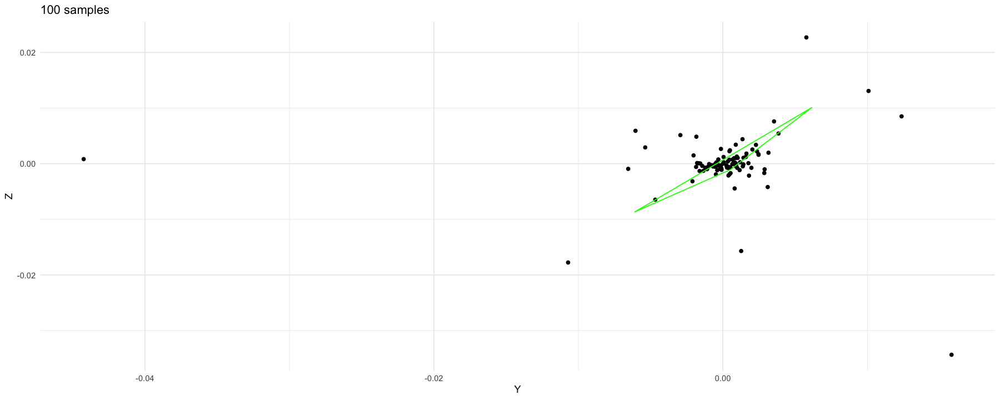

In [1573]:
toPlotOmega <- as.data.frame(t(t(sv$u[, 4:5]) %*% svd_lo2$V_column))
colnames(toPlotOmega) <- c("Y","Z")
ggplot(toPlotOmega, aes(x=Y, y=Z)) +
    geom_point() + 
    geom_polygon(data=as.data.frame(t(Omega)), fill=NA, color = "green") +
    theme_minimal() +
    ggtitle(paste(nrow(toPlotOmega), "samples"))

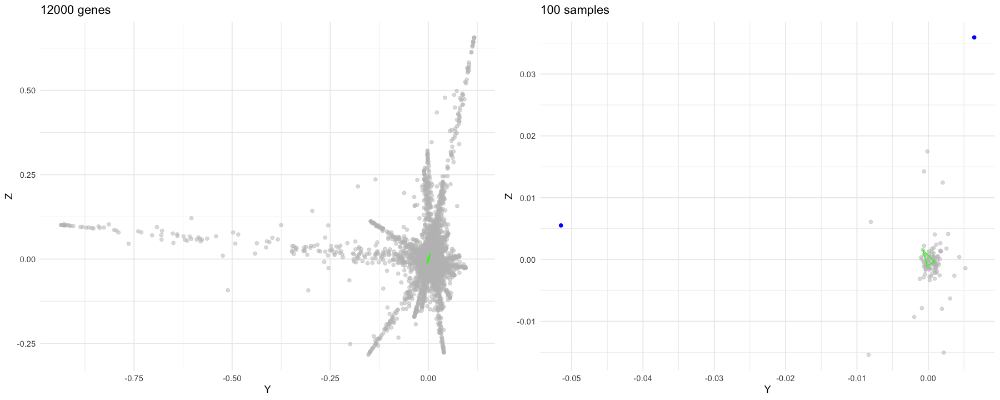

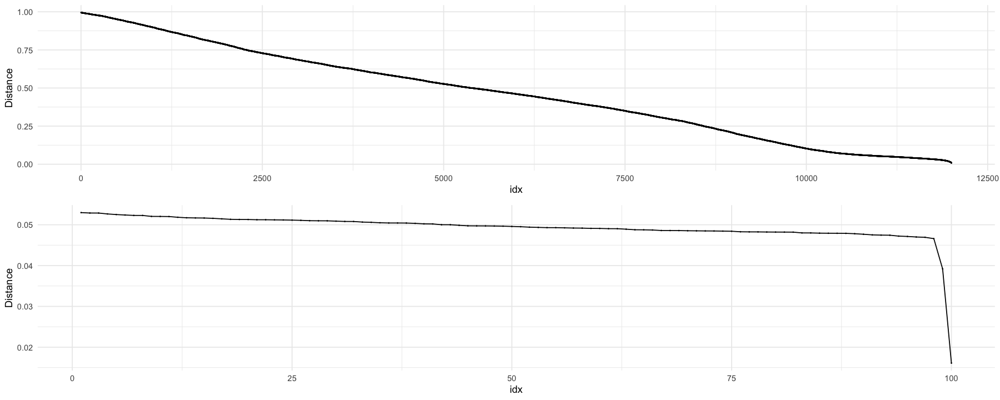

In [1518]:
svd_lo2 <- init_lo2(sim_100s_65_data, top_genes = 12000)

In [1530]:
all.equal(svd_lo2$V_column * 12000/100, svd_lo2$V_row)

[1] TRUE

In [1520]:
sv <- svd(svd_lo2$V_row)

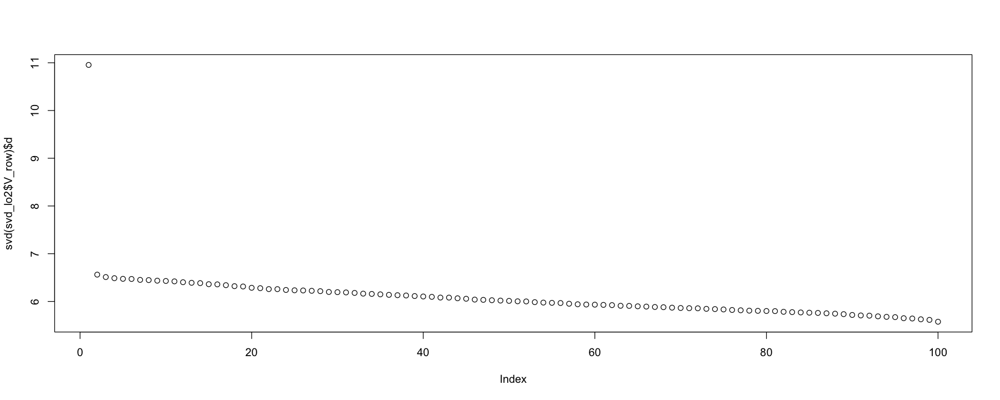

In [1563]:
plot(svd(svd_lo2$V_row)$d)

In [1561]:
-svd(svd_lo2$V_row)$u

0.009128709,3.798059e-04,0.0021116113,7.318603e-04,8.889156e-04,3.076282e-05,0.0004861357,-0.0001455751,-6.558197e-05,5.470486e-05,⋯,3.279762e-04,-0.0004034765,7.915799e-04,-0.0002479692,2.568673e-04,-5.470284e-05,0.0004940442,-2.203249e-05,-4.484841e-05,-6.709685e-04
0.009128709,-1.081251e-03,-0.0035307028,-1.654603e-03,-2.039699e-03,3.709709e-04,-0.0006984468,0.0004590208,1.384500e-04,7.345664e-05,⋯,-5.265769e-04,0.0008053097,-1.372274e-03,0.0005896063,-3.132417e-04,-1.502713e-04,-0.0013614944,6.054388e-05,1.151334e-04,1.308852e-03
0.009128709,4.633673e-04,0.0006813052,2.325091e-04,2.021243e-04,-2.852704e-03,-0.0007370378,0.0003457027,-6.630845e-04,-3.356070e-05,⋯,4.943367e-04,0.0001778747,9.332624e-04,-0.0012504171,-2.849197e-04,-5.146337e-04,0.0006176316,1.213945e-03,4.159410e-04,-5.585274e-04
0.009128709,2.610186e-04,0.0031839862,1.093495e-03,1.397870e-03,2.561526e-03,0.0015174811,-0.0005555045,4.633682e-04,1.314733e-04,⋯,1.604697e-04,-0.0008828443,6.010538e-04,0.0006466982,7.113811e-04,3.453745e-04,0.0003368314,-1.102623e-03,-4.463381e-04,-7.085484e-04
0.009128709,-7.561582e-04,-0.0024327850,-1.180044e-03,-1.464254e-03,2.932917e-05,-0.0005516100,0.0003781675,4.780083e-05,6.928133e-05,⋯,-3.264385e-04,0.0005908779,-8.844585e-04,0.0003133238,-2.390997e-04,-1.719800e-04,-0.0009457981,1.610197e-04,1.231596e-04,8.877112e-04
0.009128709,4.922407e-04,0.0007663848,2.685747e-04,2.465364e-04,-2.879362e-03,-0.0007238817,0.0003393669,-6.751937e-04,-2.878066e-05,⋯,4.423651e-04,0.0001886414,9.763693e-04,-0.0012756334,-2.991442e-04,-5.216224e-04,0.0006499141,1.224056e-03,4.053718e-04,-5.995313e-04
0.009128709,3.461900e-04,0.0021818122,7.503796e-04,9.187409e-04,3.639253e-04,0.0006055879,-0.0001911986,5.063581e-06,6.485188e-05,⋯,2.979410e-04,-0.0004510675,7.372852e-04,-0.0001187931,3.092663e-04,-3.432349e-06,0.0004510416,-1.622544e-04,-9.647251e-05,-6.488088e-04
0.009128709,2.637552e-04,0.0031438753,1.079151e-03,1.377373e-03,2.478753e-03,0.0014818845,-0.0005399418,4.448494e-04,1.275847e-04,⋯,1.646763e-04,-0.0008655238,6.043448e-04,0.0006179756,6.966048e-04,3.318046e-04,0.0003407367,-1.067198e-03,-4.329908e-04,-7.049770e-04
0.009128709,-6.857581e-04,-0.0021995204,-1.080276e-03,-1.342465e-03,-4.586162e-05,-0.0005235850,0.0003546163,1.573459e-05,5.879000e-05,⋯,-2.762355e-04,0.0005494675,-7.714089e-04,0.0002555174,-2.244843e-04,-1.794681e-04,-0.0008723313,1.748627e-04,1.032245e-04,7.968424e-04
0.009128709,-1.065803e-03,-0.0034819349,-1.633361e-03,-2.014284e-03,3.470043e-04,-0.0006943913,0.0004564820,1.325195e-04,7.358476e-05,⋯,-5.178842e-04,0.0007898013,-1.346411e-03,0.0005731296,-3.103368e-04,-1.520912e-04,-0.0013407906,7.268716e-05,1.162177e-04,1.288625e-03
0.009128709,4.815915e-04,0.0007633389,2.666901e-04,2.432234e-04,-2.836716e-03,-0.0007135095,0.0003335963,-6.615812e-04,-3.262361e-05,⋯,5.024773e-04,0.0001619530,9.636103e-04,-0.0012400589,-2.781632e-04,-5.033020e-04,0.0006287811,1.209478e-03,4.197280e-04,-5.824136e-04


In [1559]:
-svd(svd_lo2$V_row)$v

0.1,-0.039697260,0.277502270,-0.052984724,0.030954320,-0.828353753,0.1664910966,-0.0476964974,0.0696145558,-0.2279426009,⋯,-0.0107283140,0.008092033,-0.0126328666,0.008177394,-0.023551194,0.011245933,-0.006192626,0.006869550,-0.014110472,0.0139760007
0.1,-0.066977192,0.048150629,0.038969480,0.058455472,0.086483902,0.1338242801,0.2310373671,0.4713363220,0.3871335665,⋯,0.0185727288,-0.028029570,0.0178073521,0.016676233,-0.024759444,-0.002030019,0.011432651,0.007049350,-0.001010333,0.0371144371
0.1,-0.018584871,0.039226138,0.034335088,0.010688801,-0.016957646,0.0034745579,0.0161630326,-0.0116589723,-0.0031652974,⋯,-0.0159482586,0.015697110,-0.0556594414,0.042876611,0.059530646,-0.059682659,-0.010081740,-0.018021726,0.066113420,0.0101273673
0.1,-0.002482451,-0.025369625,-0.042334054,-0.062855865,0.006936656,0.0084608378,0.0656022228,0.0031505867,0.0031266353,⋯,-0.0942770547,0.034220817,0.0379254153,-0.033070352,-0.030900473,-0.029659652,0.083088239,-0.071108380,-0.036450669,0.0016846987
0.1,-0.014288653,0.001752041,-0.029404879,-0.022680478,0.000227811,0.0009259282,0.0405527905,0.0063965606,0.0088839454,⋯,0.0155028473,0.107027809,-0.0581832897,-0.197606628,0.214873966,0.467111350,-0.504734135,0.425085768,0.055736569,0.0118918233
0.1,-0.016832429,-0.074764274,0.054450589,-0.095366925,-0.013497655,-0.1103751852,0.0268524951,0.0054100369,-0.0524348139,⋯,-0.0177897797,-0.015657310,-0.0133442769,-0.008825684,0.024534308,0.006907681,-0.008070788,0.021036722,-0.046328830,0.0234467767
0.1,0.152932049,0.283721917,0.086609848,0.119807183,0.012940211,-0.0198850102,-0.1350995374,-0.0454458149,-0.0521343871,⋯,-0.0181842577,0.012029606,-0.0070583695,-0.006345470,0.002991825,0.002340733,-0.011317069,-0.010771758,-0.003431487,0.0219115344
0.1,-0.000349567,0.024144327,0.029844319,0.024184815,0.009376941,0.0204727951,0.0355689029,0.0408315888,0.0413018816,⋯,-0.1214396927,0.076674246,0.0013041257,-0.031708195,0.028208392,-0.048370029,0.016024379,0.004586102,-0.002215140,-0.0023195292
0.1,-0.020567219,-0.044650390,-0.013544439,-0.001401829,-0.005175225,-0.0498204203,0.0118726558,-0.0207089985,0.0188723492,⋯,-0.2362684048,-0.056248626,-0.0738912763,0.376560262,-0.453379679,-0.171666529,-0.219581859,0.118769624,0.012761089,0.0251454640
0.1,0.941846264,-0.101637867,0.033977934,-0.090043080,-0.046988297,0.1716273344,0.0068964539,-0.0517981151,0.0469377780,⋯,0.0120513544,-0.013438332,-0.0131951938,0.014987652,-0.001990016,0.003371195,-0.020303626,-0.005863146,-0.007328921,-0.0046479723
0.1,-0.003648640,0.025575574,0.017666901,0.001131614,0.016650718,0.0317593846,-0.0129815726,0.0454762279,-0.0403041195,⋯,-0.0040845560,0.071358033,0.0625223959,0.076139502,-0.001021073,0.087838899,0.054553580,0.065776656,-0.056637271,0.0977961643


In [1552]:
a <- scaleDataset(matrix(rnorm(600),nrow=6), 2000)$V_row
svd(a)

-0.011914425,-0.26004657,0.9084733224,0.088980527,-0.30378892,-0.08188291
0.994008272,-0.10676210,-0.0103187328,-0.008861531,0.01625276,0.01001275
-0.001112043,-0.03484814,-0.0001502668,0.951621608,0.26949725,0.14342907
-0.022009760,-0.06572657,0.3181162613,-0.273612970,0.89809371,0.11207708
-0.009643977,-0.01858946,0.0366975509,-0.100892654,-0.16760301,0.97976764
0.105957205,0.95660739,0.2683748457,0.037106201,-0.01250214,0.01082329
-0.254025932,-0.288106181,-0.110656096,0.161164410,-0.246779325,0.13258550
-0.039183655,0.043182219,-0.004977890,-0.073035750,-0.024927687,0.11097198
0.001716534,0.014357378,0.004018812,0.021331666,0.016595656,0.09709494
-0.008733124,0.014505010,0.007290878,0.029103302,0.010694171,0.09706573
0.044398873,-0.054808176,-0.003045364,0.098423696,-0.002223567,0.09385345


In [ ]:
ggplot(as.data.frame(sv$v[,2:3]), aes(x=V1, y=V2)) + geom_point()

## Clustering

In [1967]:
s <- createSimulation(n_genes = 12000, n_samples = 100, n_cell_types = 3) %>% addNoise(5)

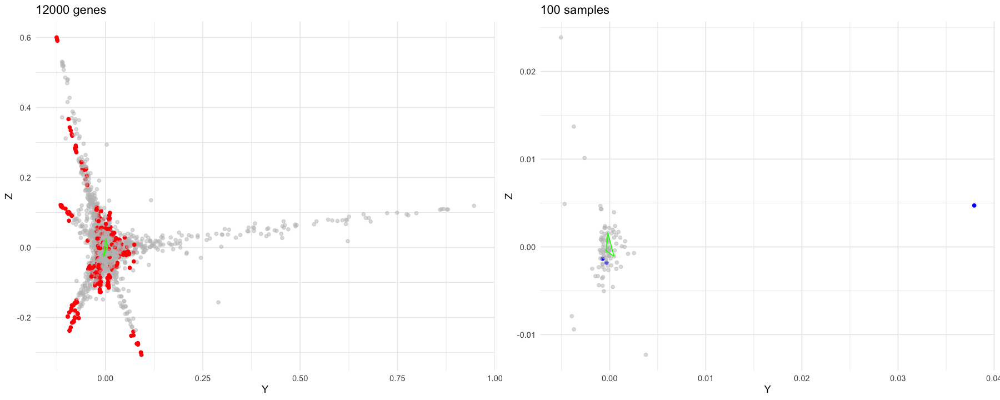

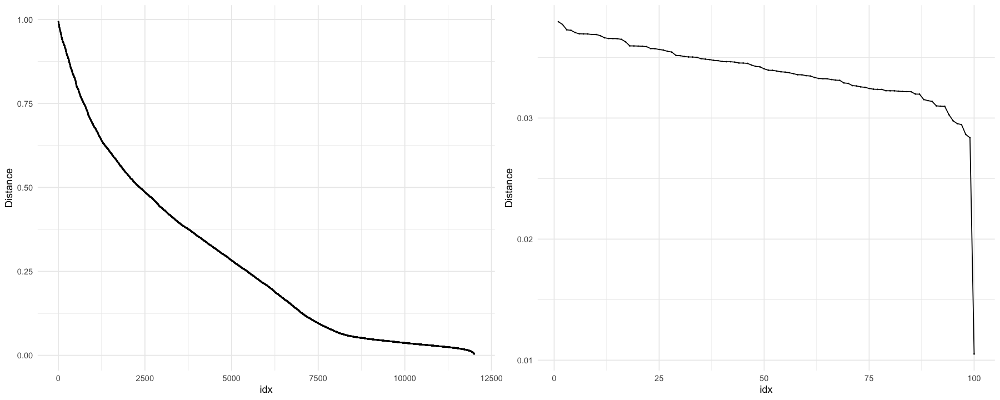

In [1970]:
dbs_lo2 <- init_lo2(s$data, top_genes = 12000)

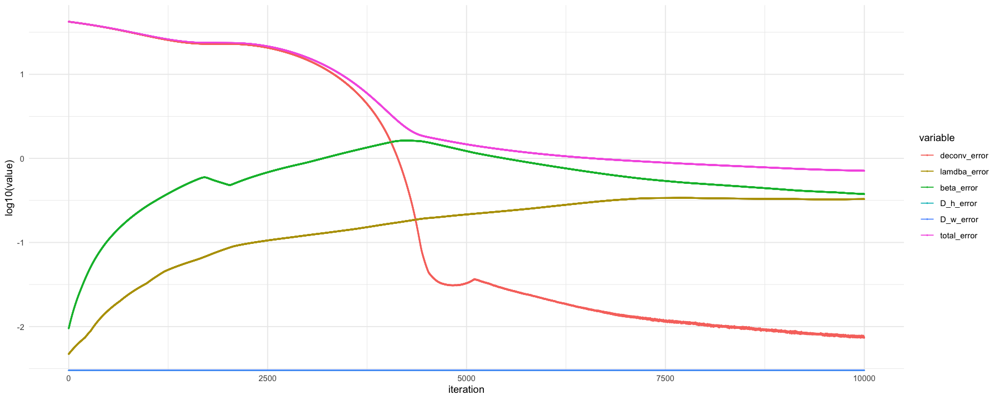

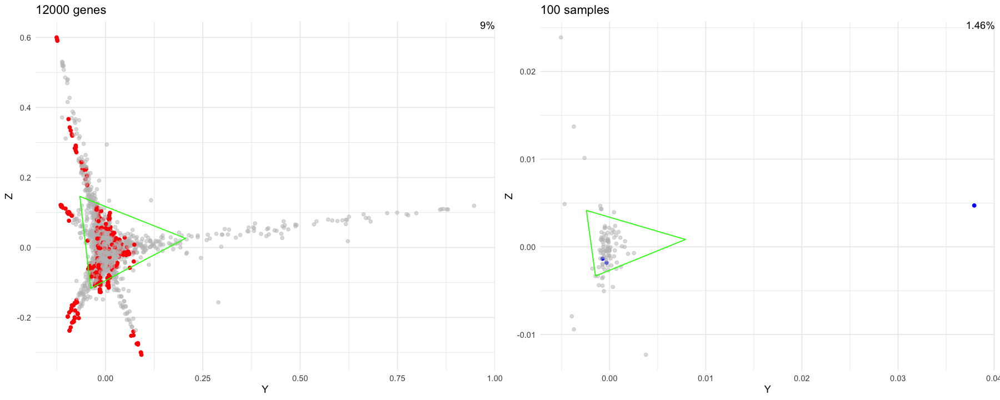

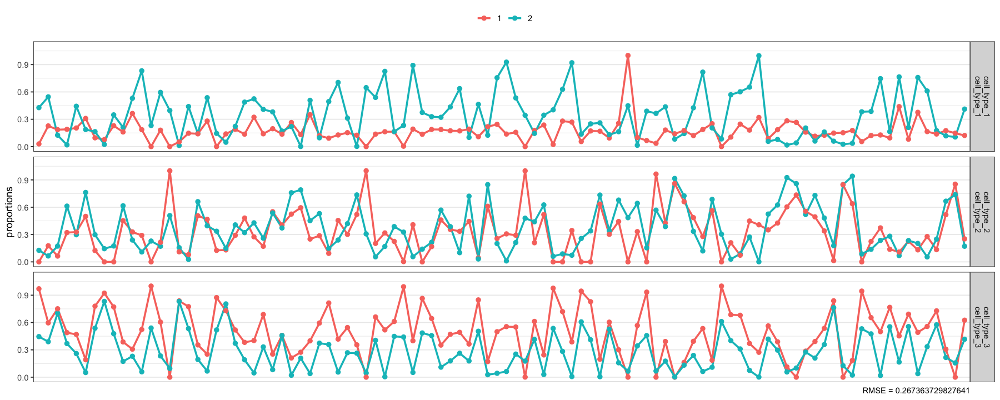

In [1998]:
run_block(dbs_lo2, true_props = s$proportions, iterations = 10000)

In [1971]:
dbs <- function(self, dims = seq_len(3)) {
    svd_ <- svd(self$V_row)
    S <- t(svd_$u[, dims])
    R <- t(svd_$v[, dims])
    S[1,] <- -S[1,]
    R[1,] <- -R[1,]

    toPlotOmega <- as.data.frame(t(S %*% self$V_column))[, seq_len(length(dims))]
    colnames(toPlotOmega) <- paste0("dim_", dims)
    
    toPlotX <- as.data.frame(self$V_row %*% t(R))[, seq_len(length(dims))]
    colnames(toPlotX) <- paste0("dim_", dims)
    
    list(toPlotX, toPlotOmega)
}

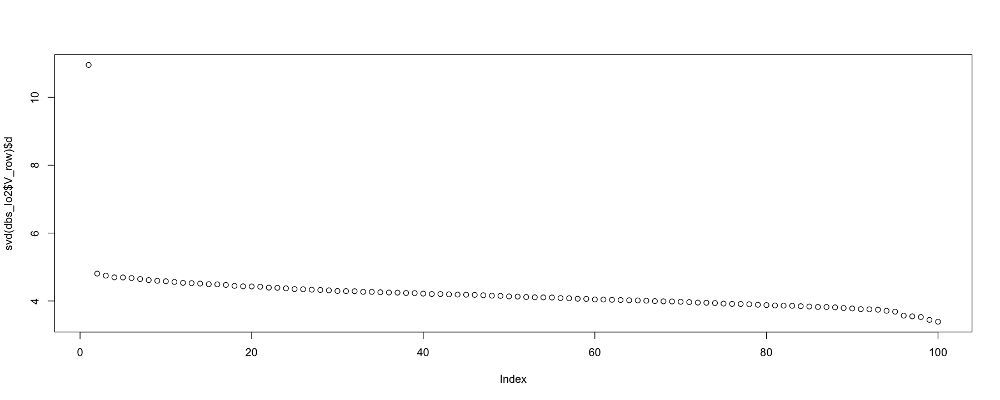

In [1972]:
plot(svd(dbs_lo2$V_row)$d)

In [2000]:
dat <- dbs(dbs_lo2, 1:5)[[1]]
cl_o <- dbscan::optics(dat, minPts = 40)

In [2001]:
cl <- dbscan::extractDBSCAN(cl_o, eps_cl = 0.002)
data_2d <- dbs(dbs_lo2, 1:3)[[1]]
col_X <- colnames(data_2d)[2]
col_Y <- colnames(data_2d)[3]

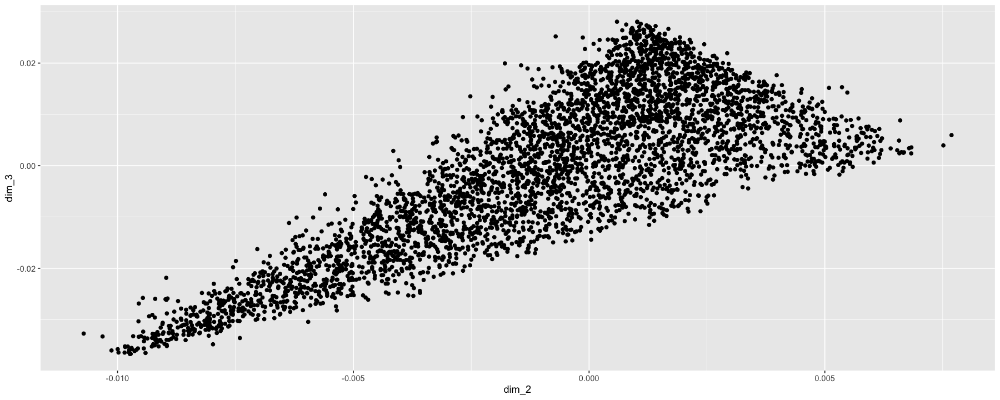

In [1976]:
ggplot(data_2d[cl$cluster == 1, ], aes_string(x=col_X, y=col_Y)) + geom_point()

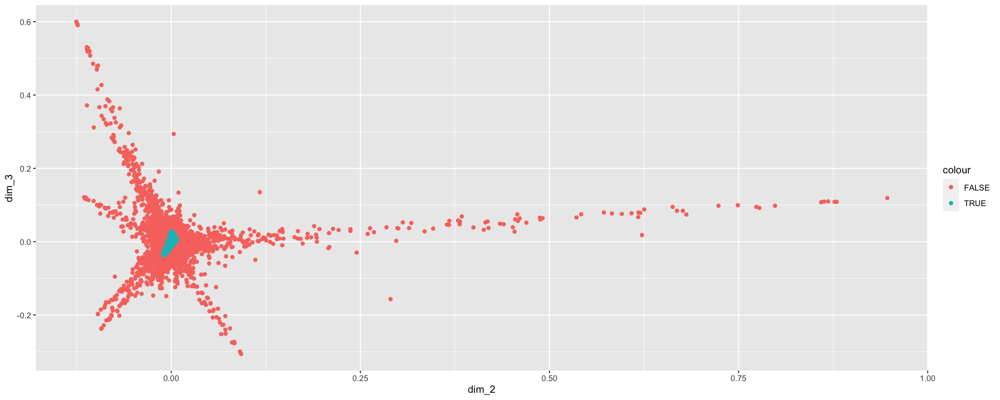

In [1977]:
ggplot(
    data_2d[order(cl$cluster == 1, decreasing = F),],
    aes_string(x=col_X, y=col_Y, col=as.factor(cl$cluster[order(cl$cluster == 1, decreasing = F)] == 1))
) + geom_point()

In [1978]:
keep_genes <- rownames(data_2d[cl$cluster == 1, ])

In [1979]:
dat <- dbs(dbs_lo2, 1:5)[[2]]
cl_o <- dbscan::optics(dat, minPts = 20)

In [1980]:
cl <- dbscan::extractDBSCAN(cl_o, eps_cl = 0.00137)
data_2d <- dbs(dbs_lo2, 1:3)[[2]]
col_X <- colnames(data_2d)[2]
col_Y <- colnames(data_2d)[3]

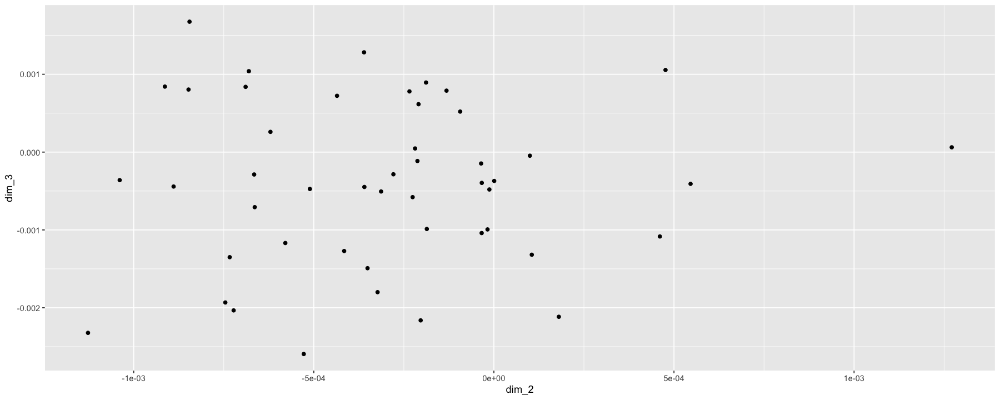

In [1981]:
ggplot(data_2d[cl$cluster == 1, ], aes_string(x=col_X, y=col_Y)) + geom_point()

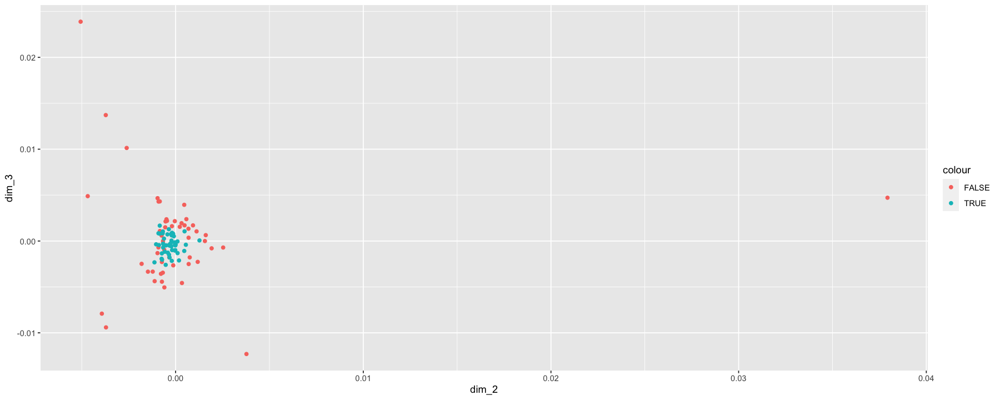

In [1982]:
ggplot(
    data_2d[order(cl$cluster == 1, decreasing = F),],
    aes_string(x=col_X, y=col_Y, col=as.factor(cl$cluster[order(cl$cluster == 1, decreasing = F)] == 1))
) + geom_point()

In [1983]:
keep_samples <- rownames(data_2d[cl$cluster == 1, ])

In [2009]:
s1 <- createSimulation(12000, 100, 3, with_marker_genes = T) %>%
withBasisSamples() %>% withPureSamples(samples_per_cell_type = 3) %>% withNoise(5)

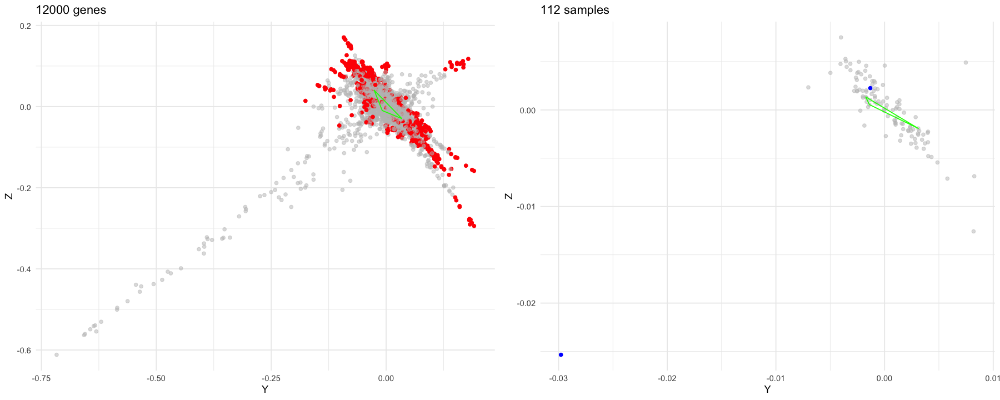

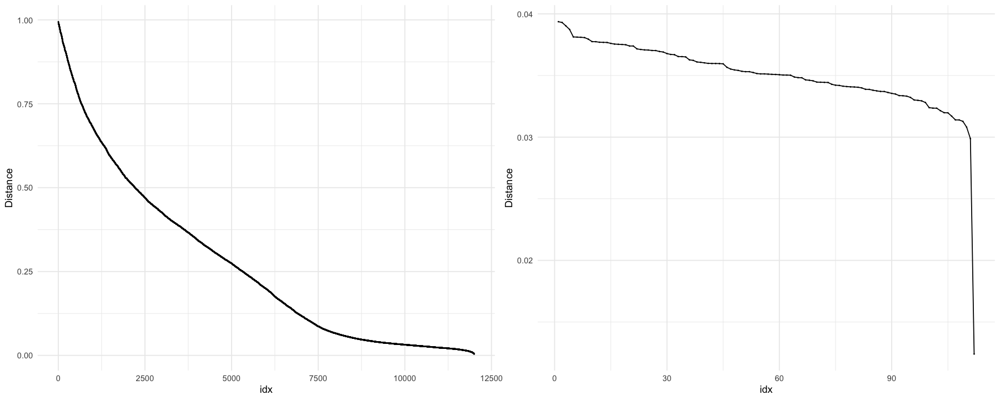

In [2012]:
a <- init_lo2(s1$data, top_genes = 12000)

In [1986]:
db_flt_data <- s$data[keep_genes, keep_samples]

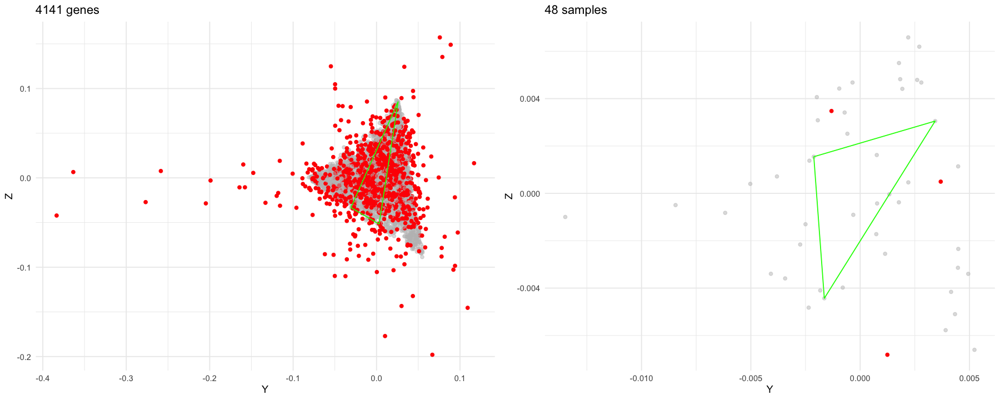

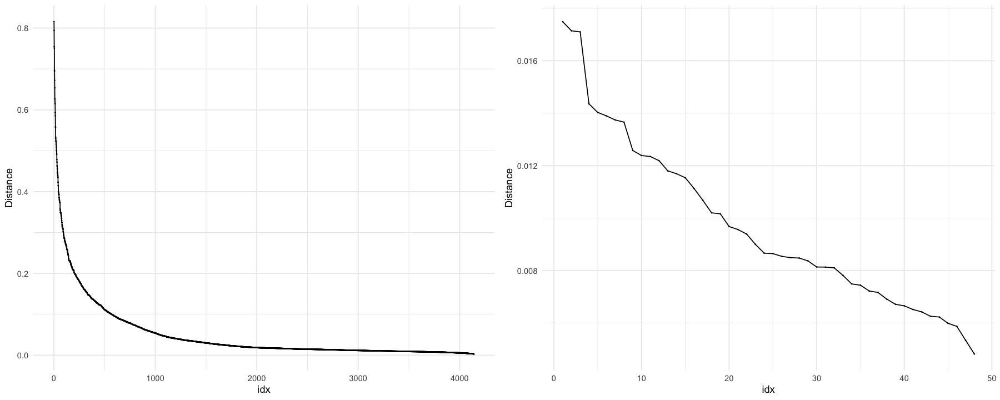

In [1987]:
db_lo2_flt <- init_lo2(db_flt_data, top_genes = nrow(db_flt_data))

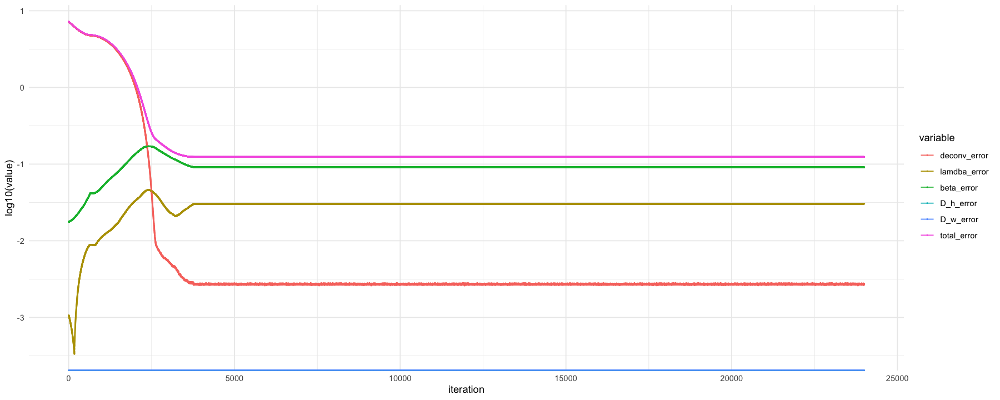

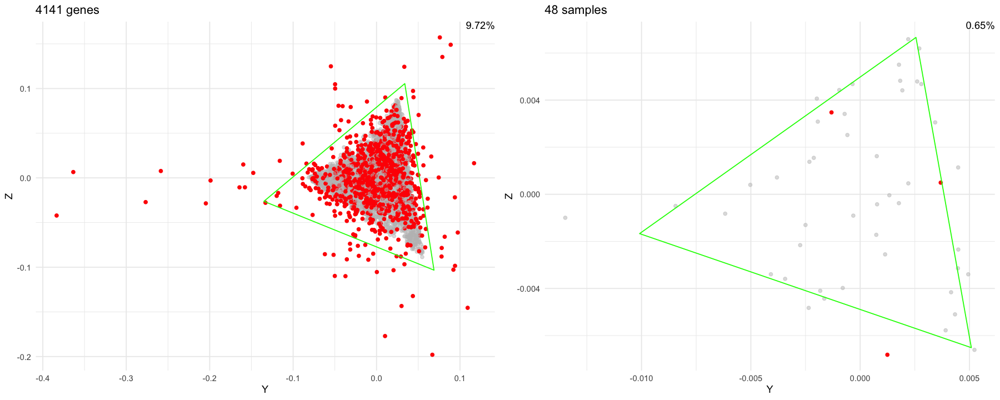

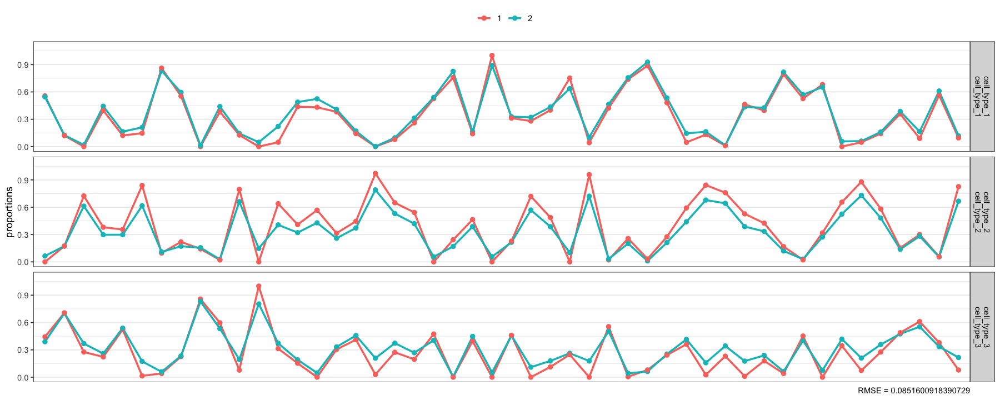

In [1995]:
run_block(db_lo2_flt, true_props = s$proportions[, keep_samples], iterations = 12000)

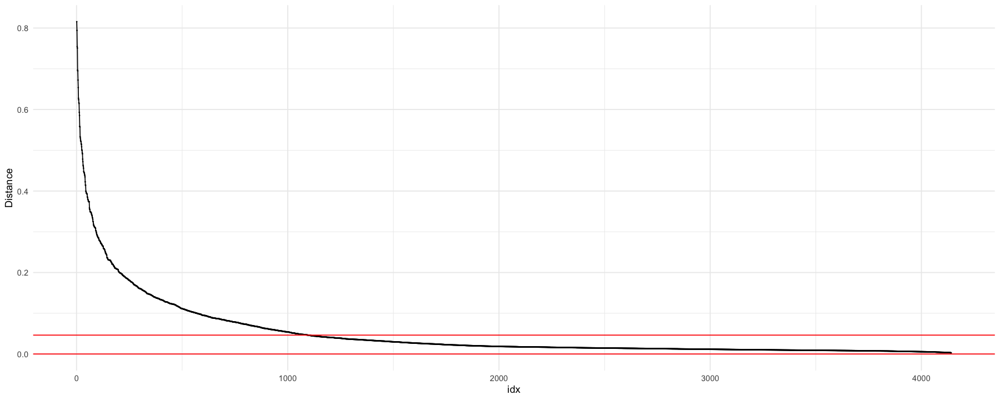

In [1992]:
keep_genes_2 <- do_mad_cutoff(db_lo2_flt, samples = F)

In [1993]:
db_flt_data_2 <- s$data[keep_genes_2, keep_samples]

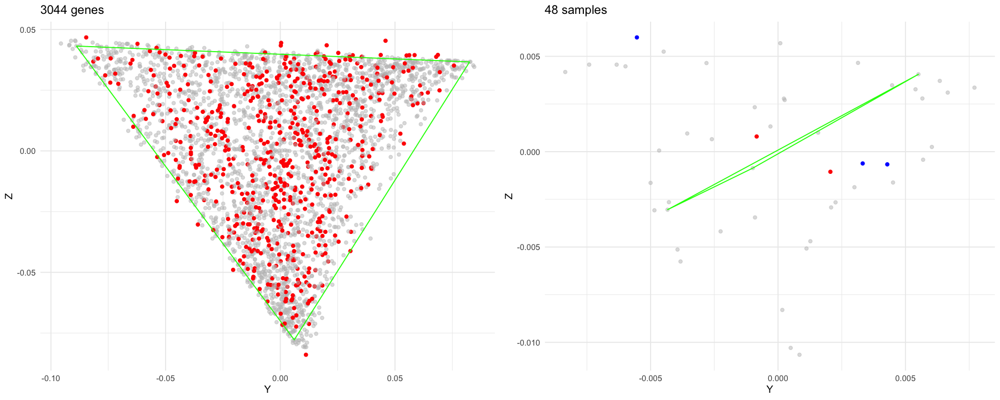

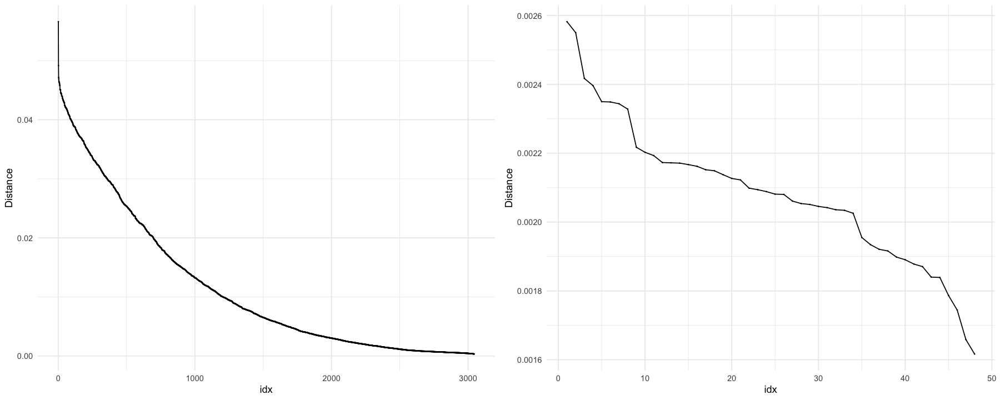

In [1994]:
db_lo2_flt2 <- init_lo2(db_flt_data_2, top_genes = nrow(db_flt_data_2))

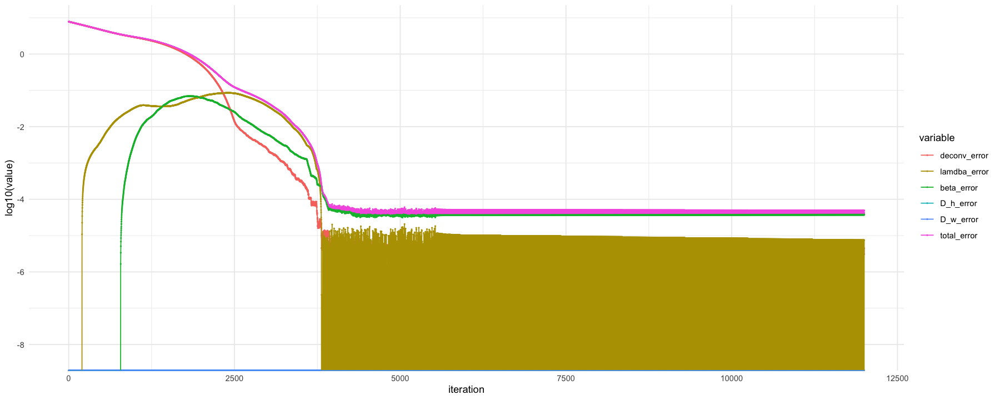

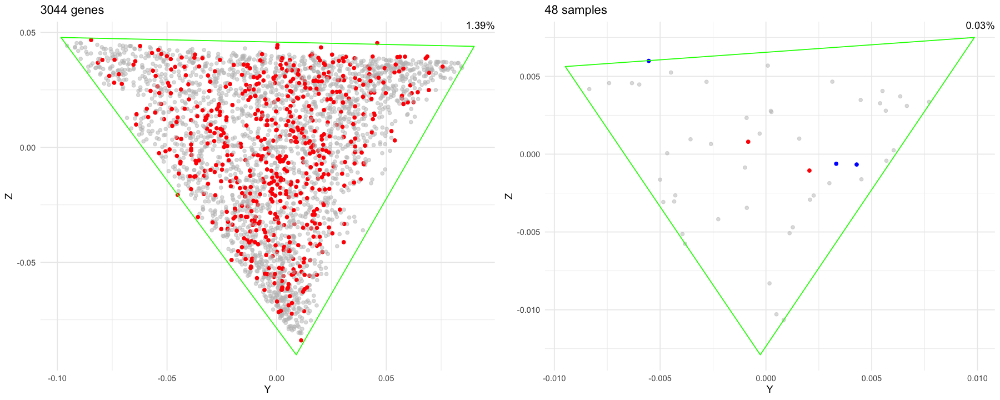

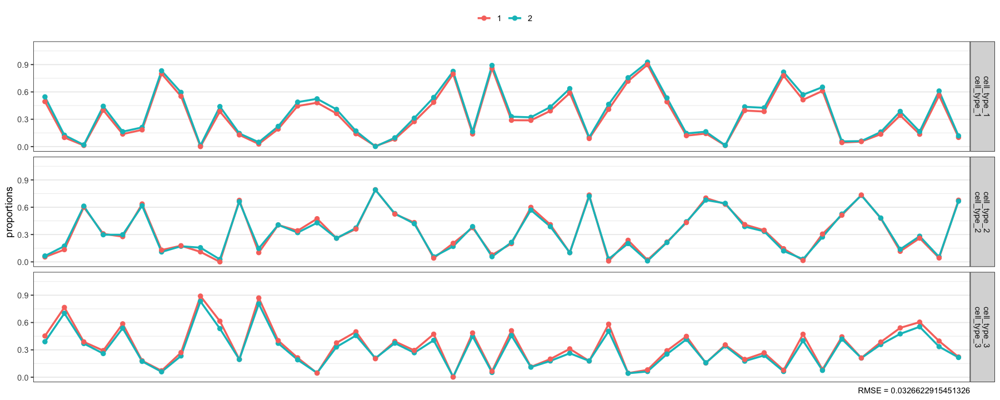

In [1997]:
run_block(db_lo2_flt2, true_props = s$proportions[, keep_samples], iterations = 12000)

# 11 Jul 2022

## Same numbers as filtered, but initially

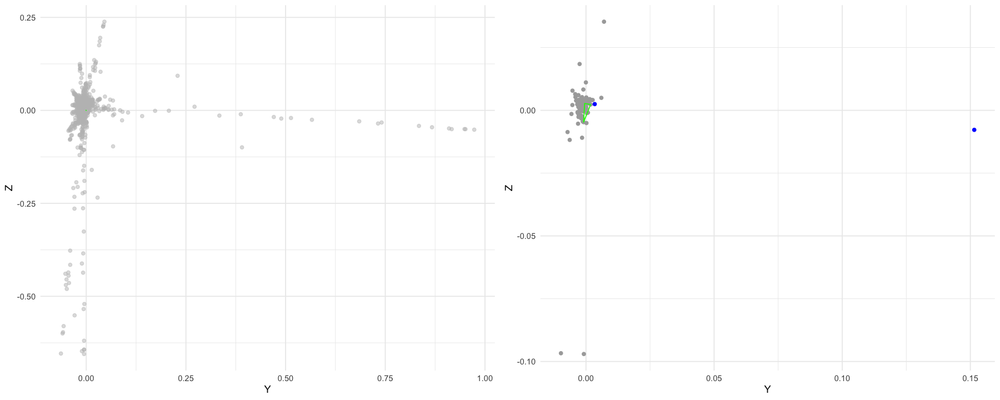

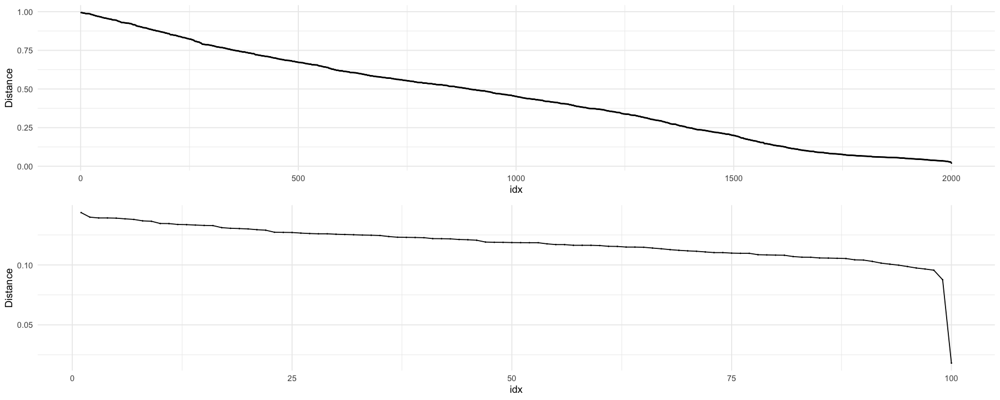

In [1029]:
sim_100s_2000g_65_lo2 <- init_lo2(sim_100s_2000g_65$data, top_genes = 2000)

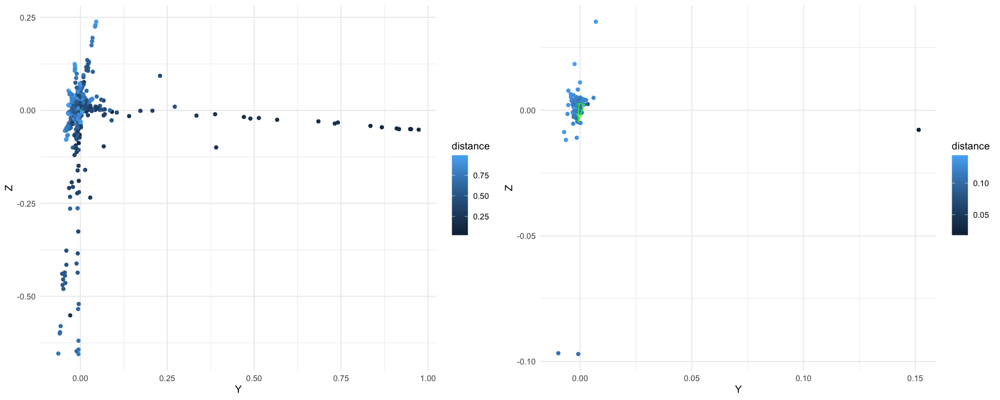

In [1030]:
do.call("grid.arrange", c(sim_100s_2000g_65_lo2$plotPoints2D(), nrow=1))

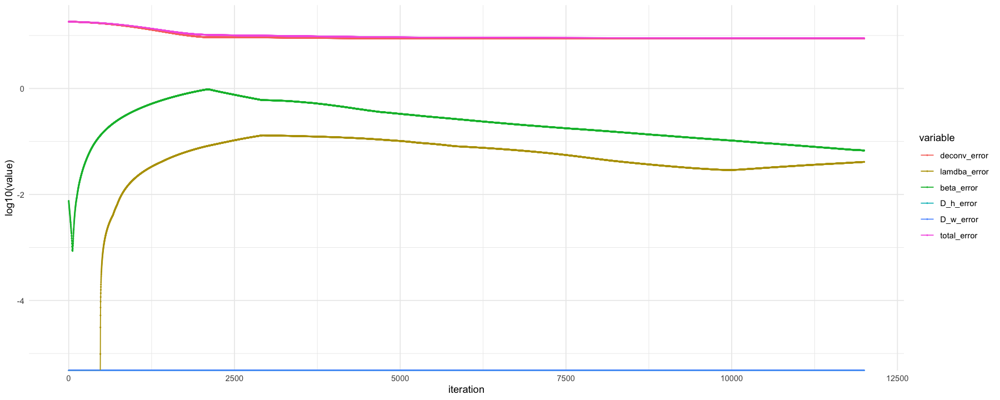

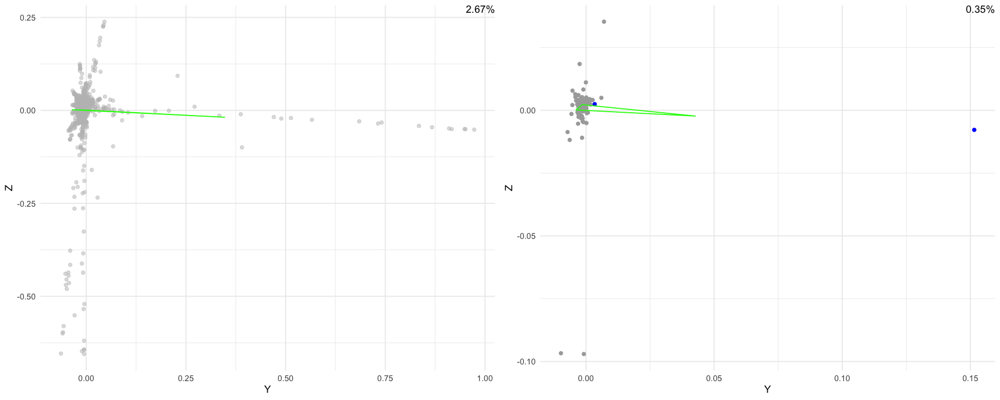

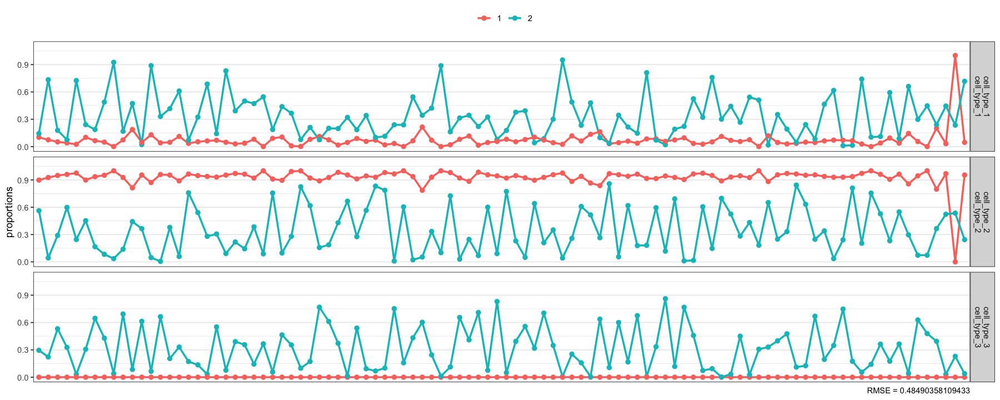

In [1034]:
run_block(sim_100s_2000g_65_lo2, true_props = sim_100s_2000g_65$proportions, iterations = 12000, startWithInit = T)

## Filter step by step

### Run at once

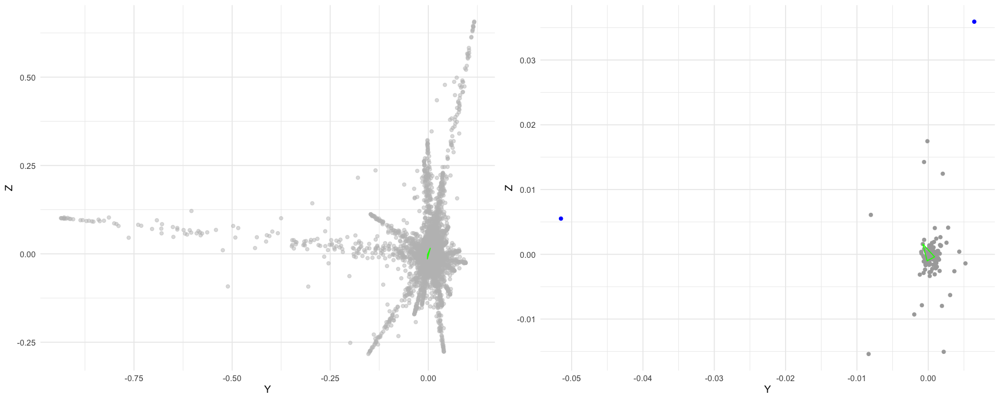

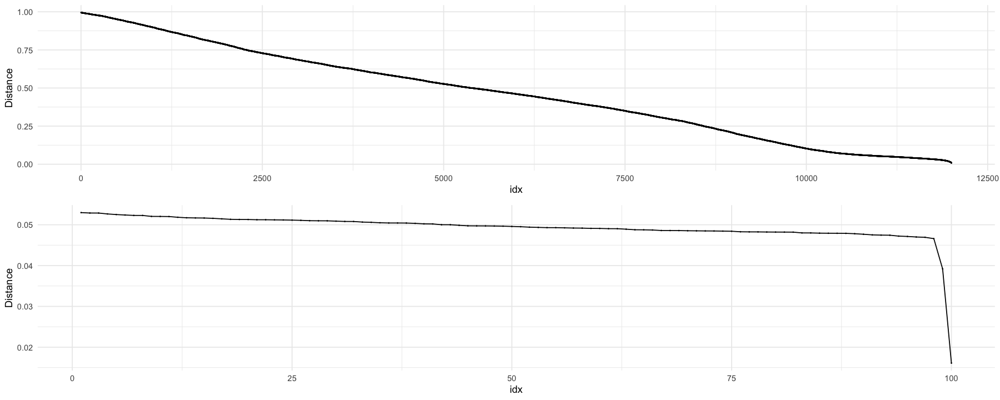

In [1017]:
sim_100s_65_lo2_at_once <- init_lo2(sim_100s_65_data, top_genes = 12000)

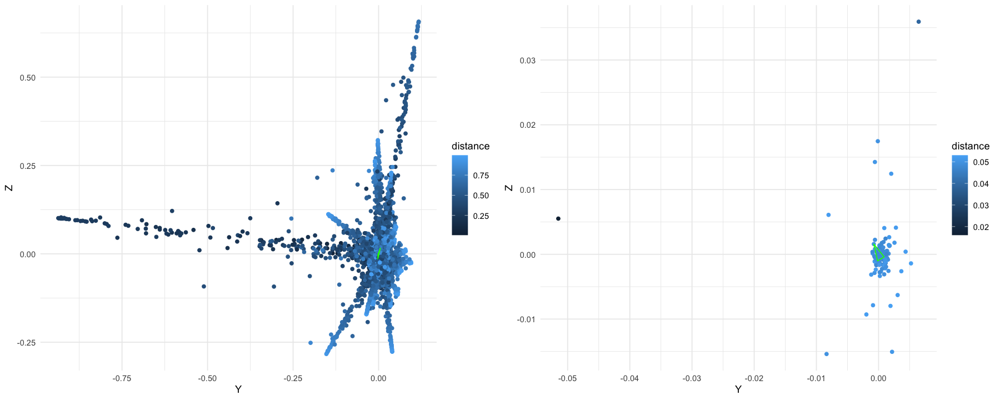

In [1023]:
do.call("grid.arrange", c(sim_100s_65_lo2_at_once$plotPoints2D(), nrow=1))

In [1028]:
sim_100s_65_lo2_at_once$filterByDistance(10000)


Scaling dataset [>---------------------------]   2% eta: 17s

Scaling dataset [>---------------------------]   3% eta: 23s

Scaling dataset [>---------------------------]   4% eta: 26s

Scaling dataset [>---------------------------]   5% eta: 28s

Scaling dataset [=>--------------------------]   6% eta: 29s

Scaling dataset [=>--------------------------]   7% eta: 29s

Scaling dataset [=>--------------------------]   8% eta: 30s

Scaling dataset [==>-------------------------]   9% eta: 30s

Scaling dataset [==>-------------------------]  10% eta: 29s

Scaling dataset [==>-------------------------]  11% eta: 29s

Scaling dataset [==>-------------------------]  12% eta: 29s

Scaling dataset [===>------------------------]  13% eta: 29s

Scaling dataset [===>------------------------]  14% eta: 28s

Scaling dataset [===>------------------------]  15% eta: 28s

Scaling dataset [===>------------------------]  16% eta: 28s

Scaling dataset [====>-----------------------]  17% eta: 28s

Scaling

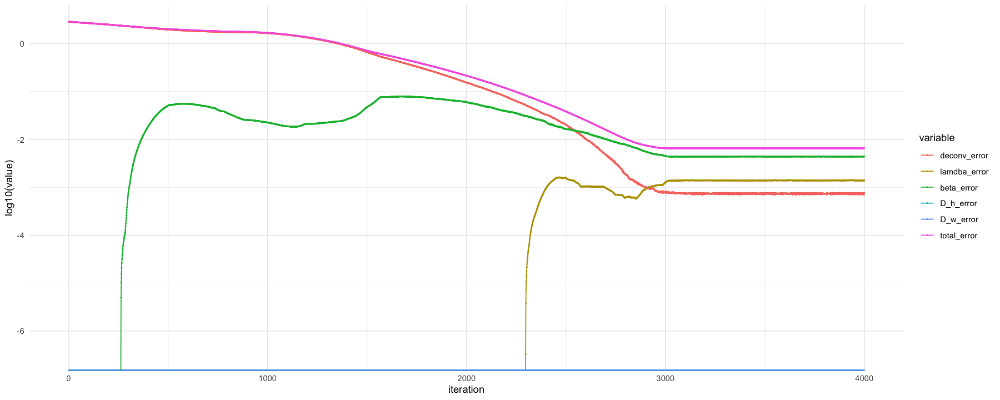

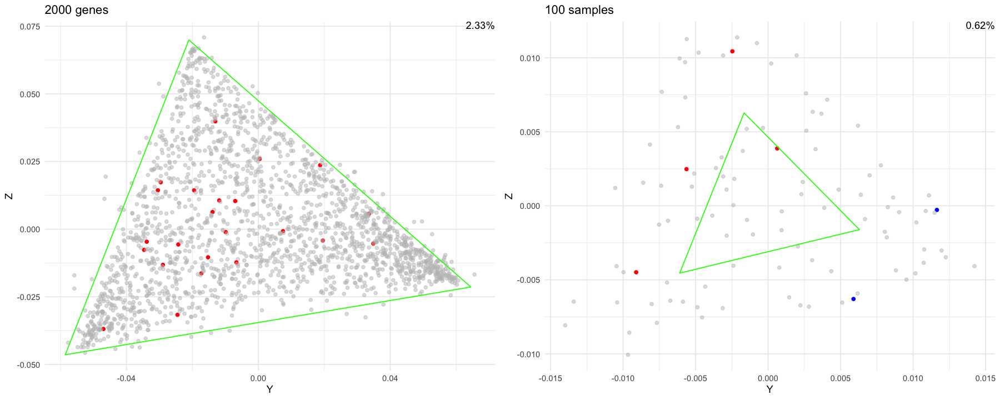

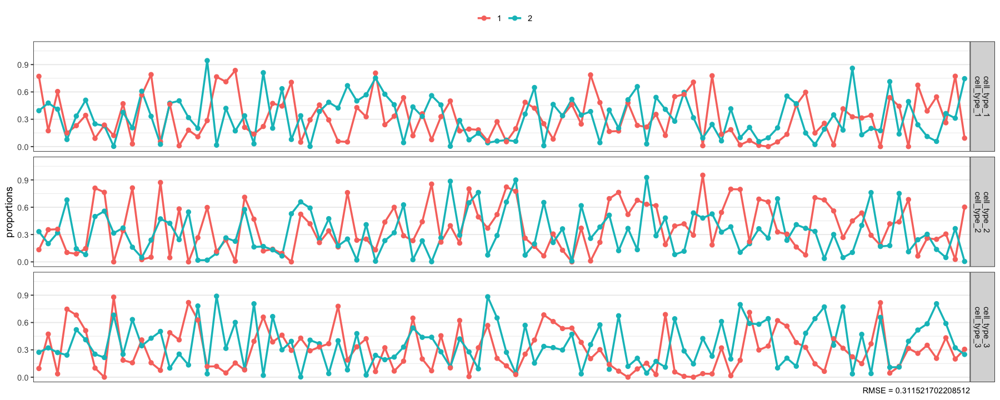

In [1282]:
run_block(sim_100s_65_lo2_at_once, true_props = sim_100s_65$proportions, iterations = 4000, startWithInit = T)

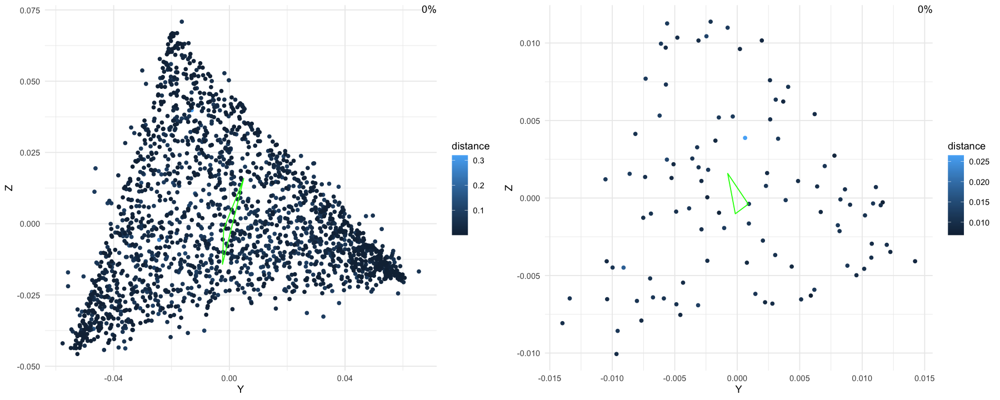

In [1045]:
do.call("grid.arrange", c(sim_100s_65_lo2_at_once$plotPoints2D(), nrow=1))

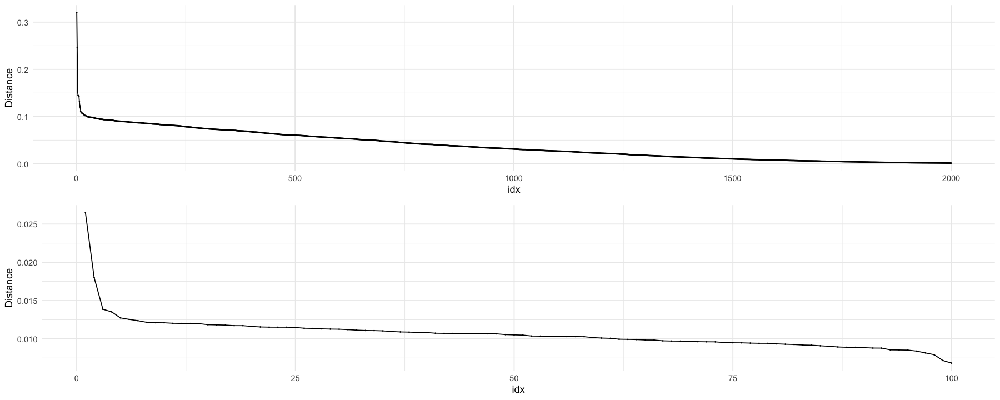

In [1046]:
do.call("grid.arrange", sim_100s_65_lo2_at_once$plotDistances())

### Run step by step

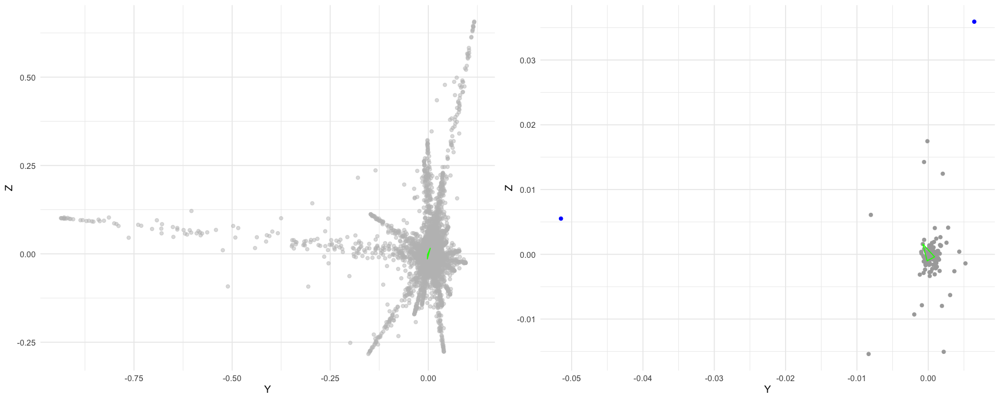

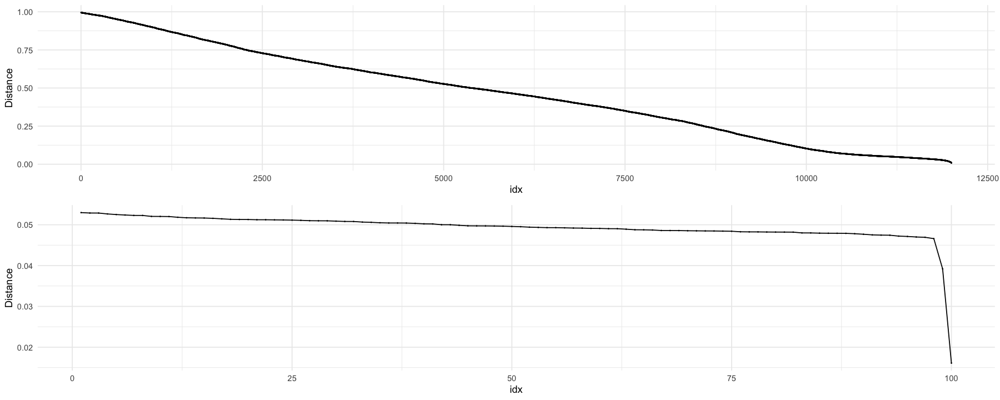

In [1071]:
sim_100s_65_lo2_stages <- init_lo2(sim_100s_65_data, top_genes = 12000)

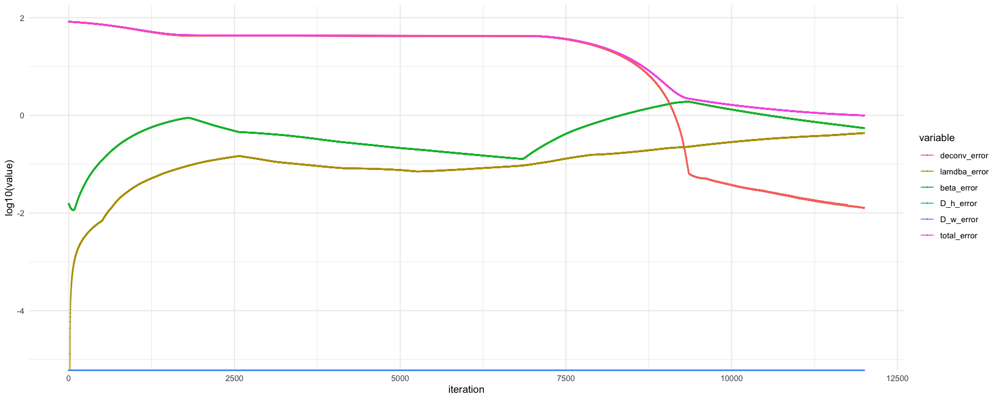

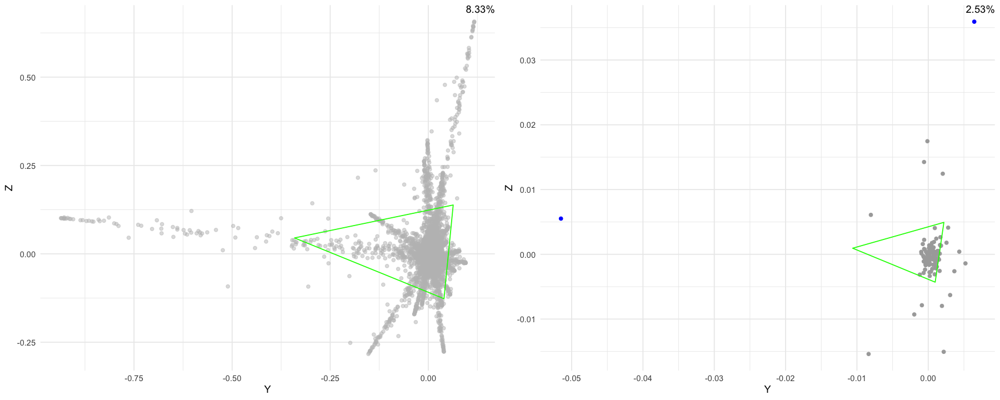

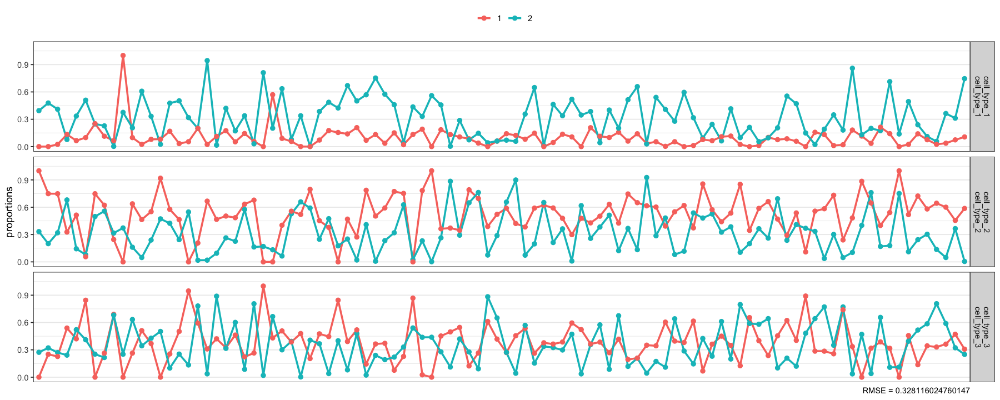

In [1072]:
run_block(lo2 = sim_100s_65_lo2_stages, true_props = sim_100s_65$proportions, iterations = 12000, startWithInit = T)

In [1085]:
stages_list <- list()
stages_list[[1]] <- sim_100s_65_lo2_stages$clone(deep=T)

Iteration 3



TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


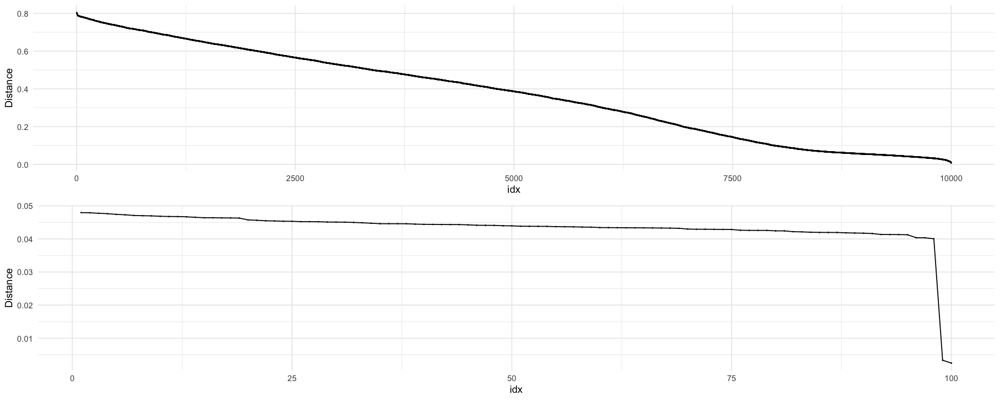

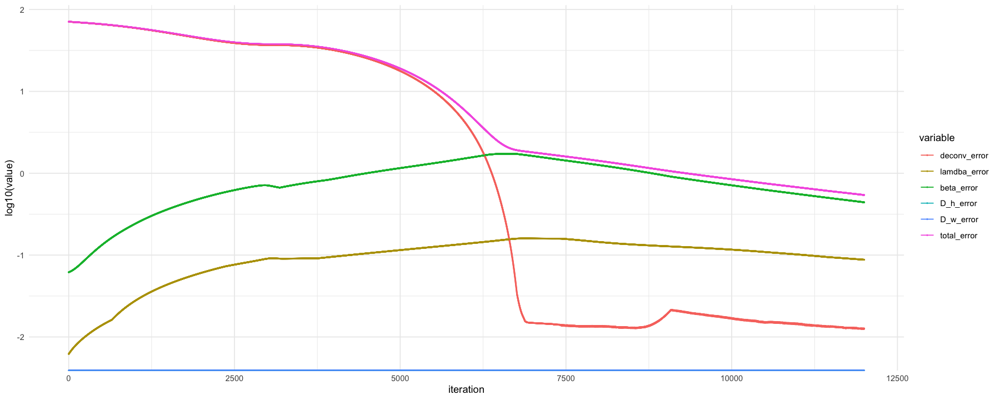

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 4



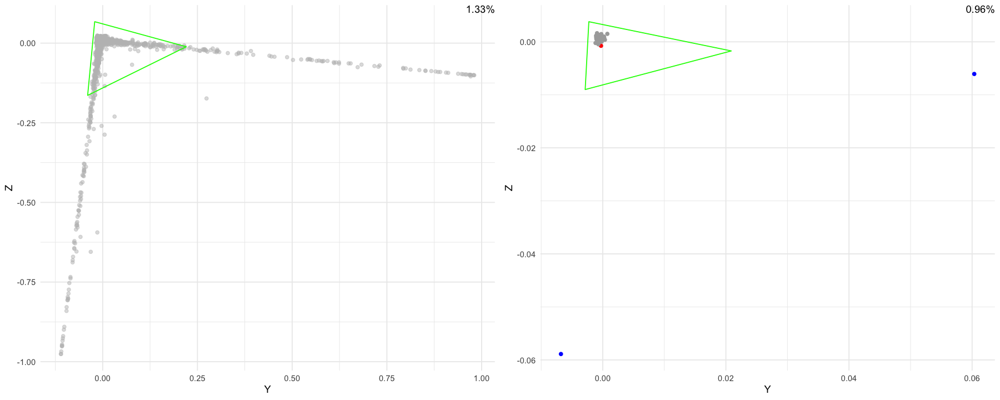

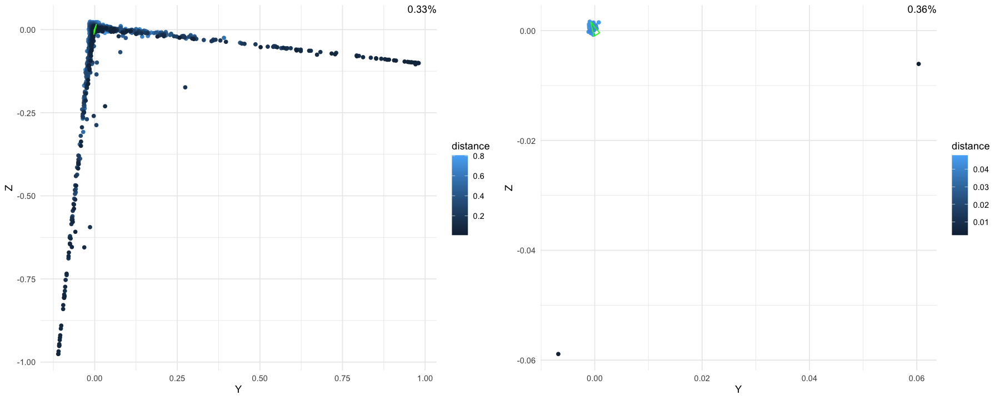

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


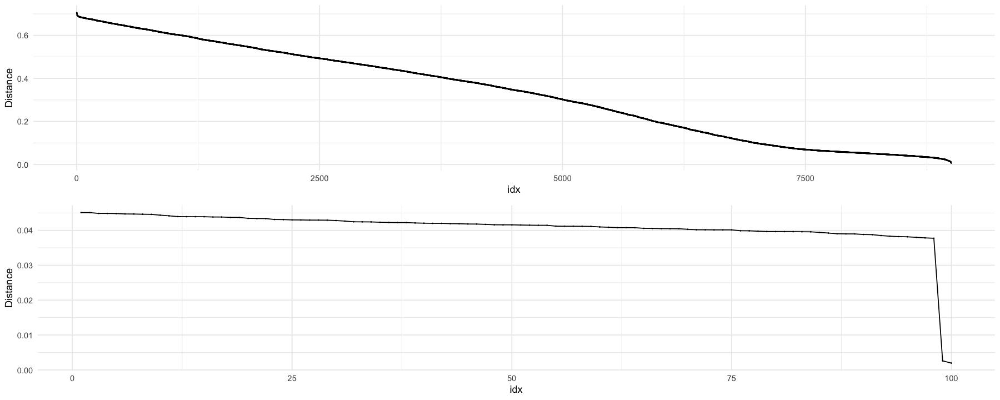

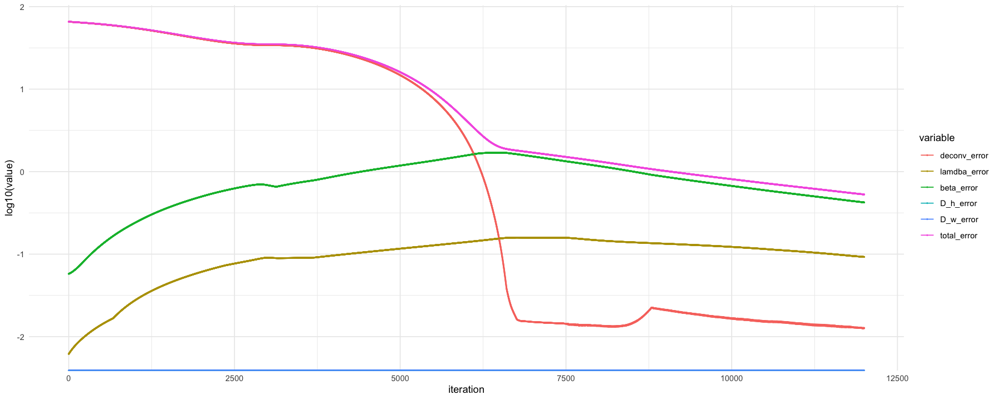

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 5



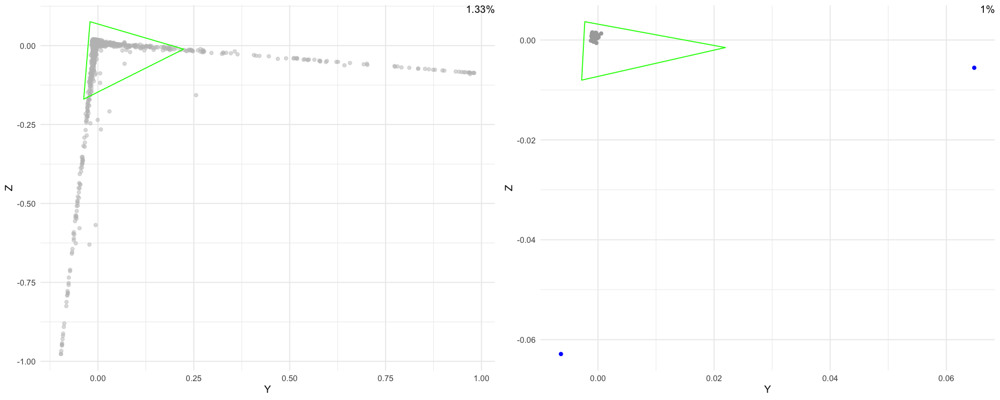

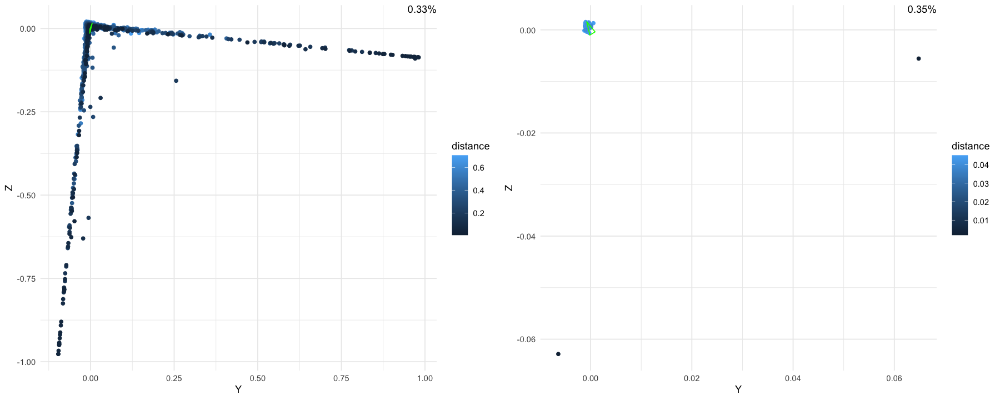

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


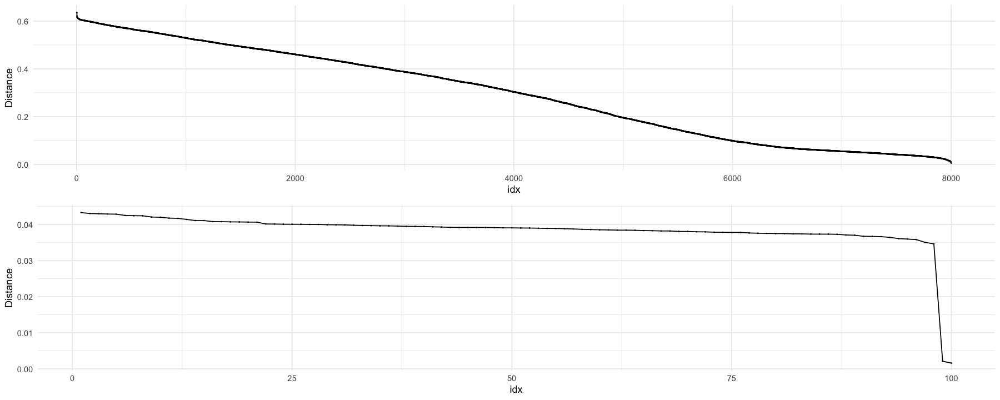

Error while calculating proportions, ignoring



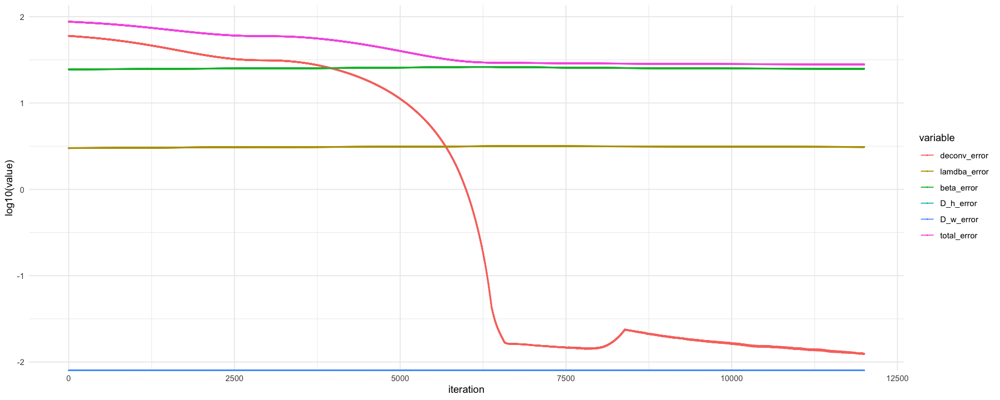

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 6



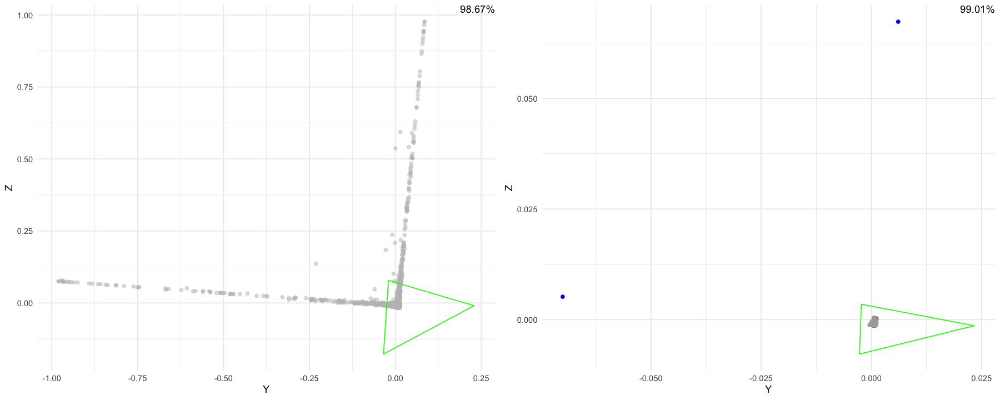

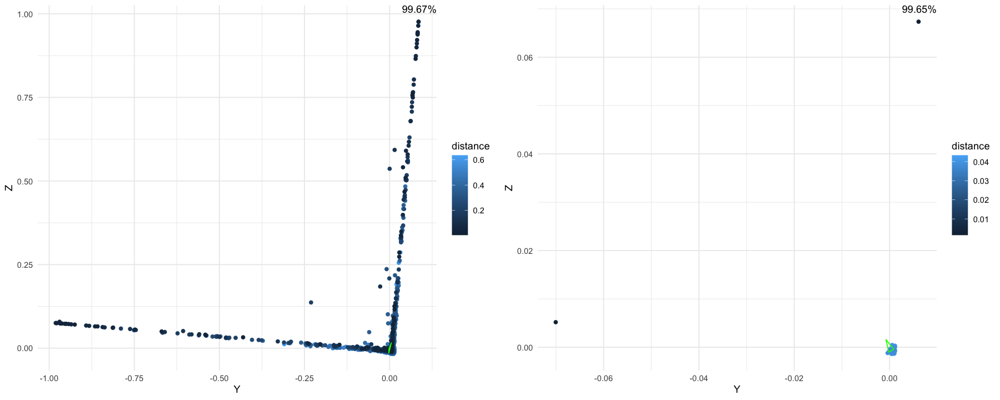

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


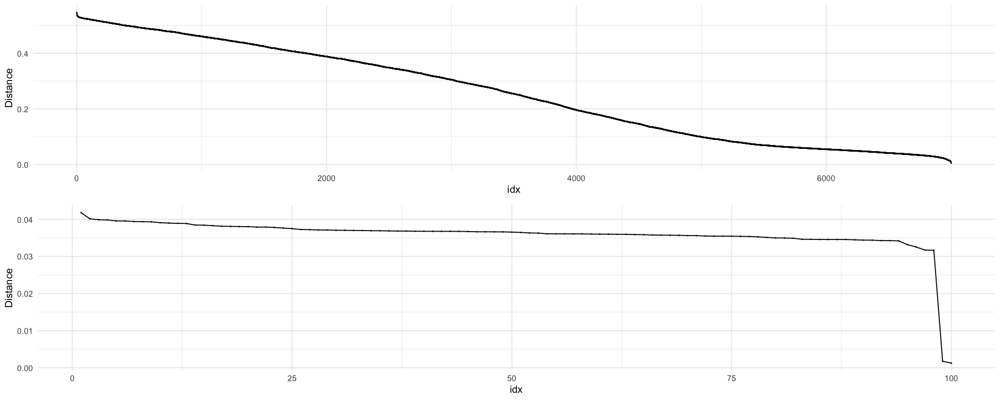

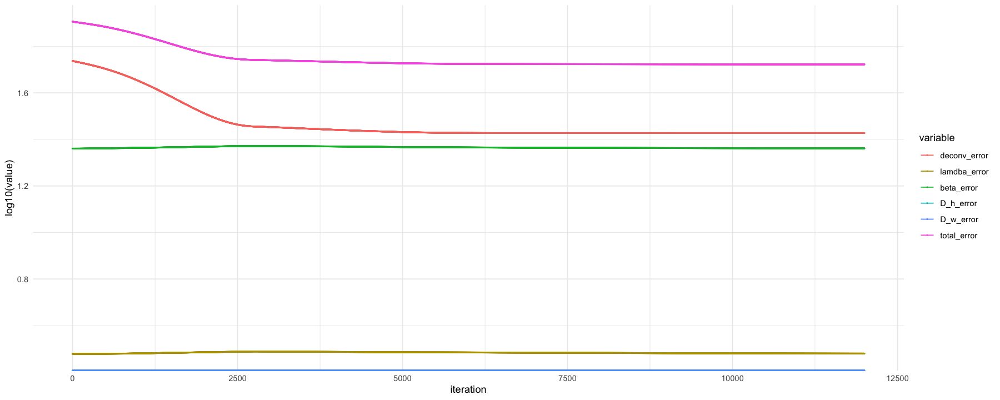

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 7



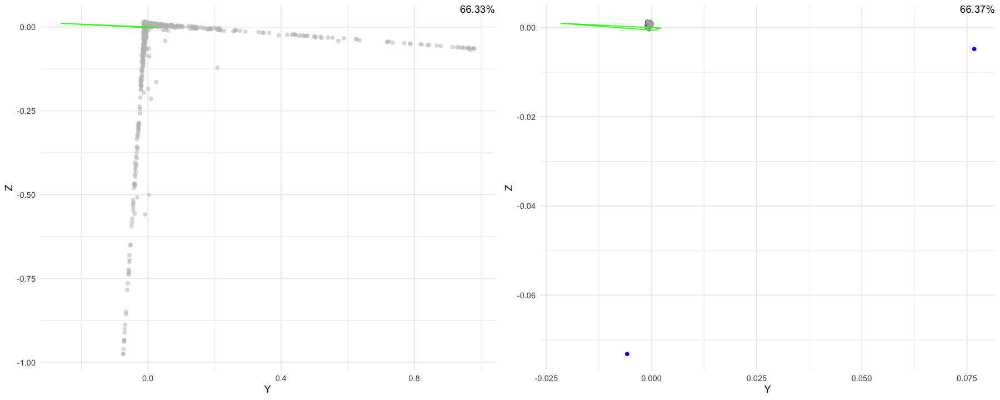

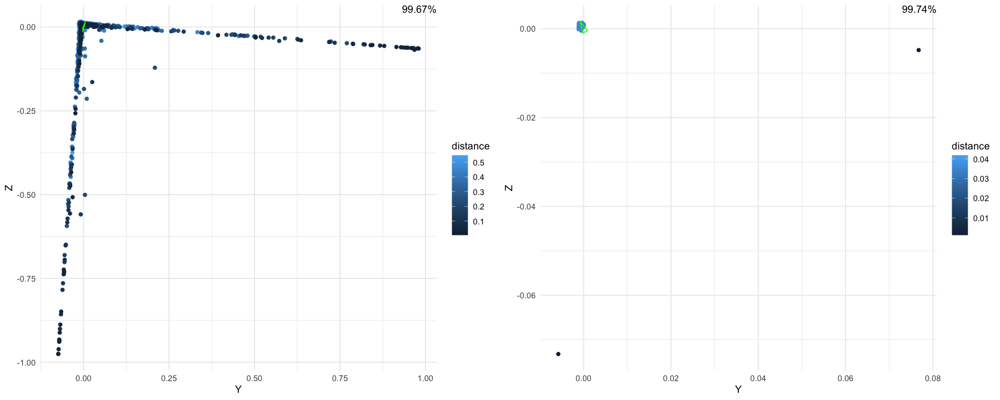

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


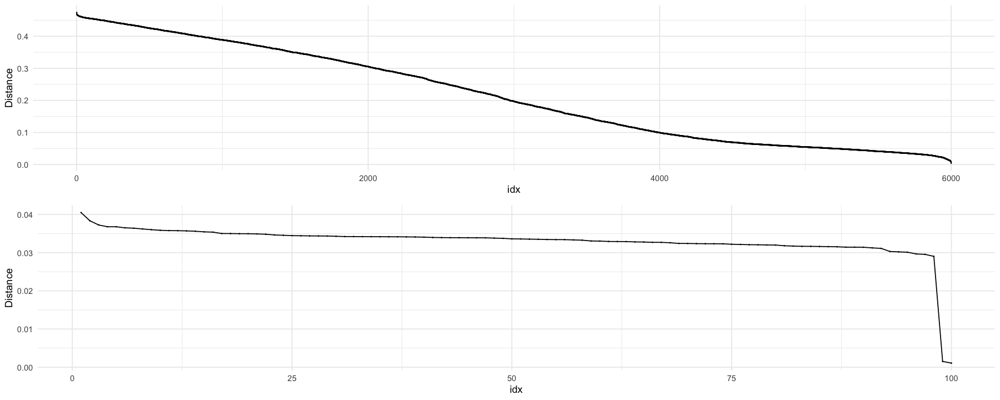

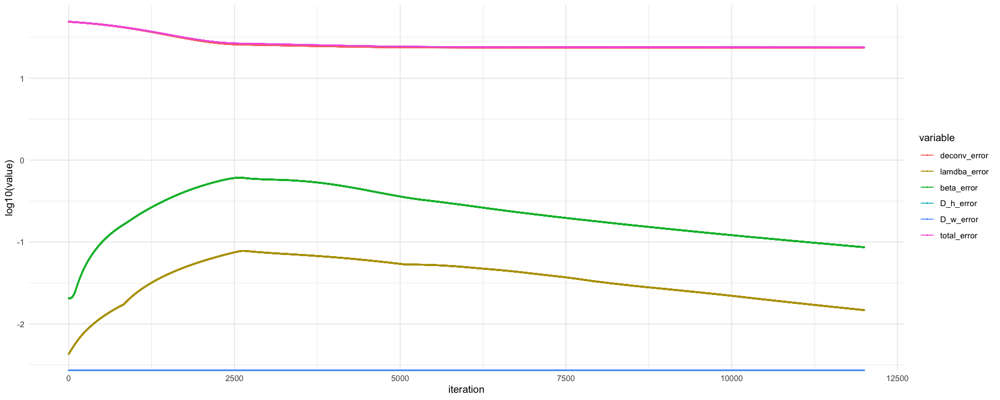

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 8



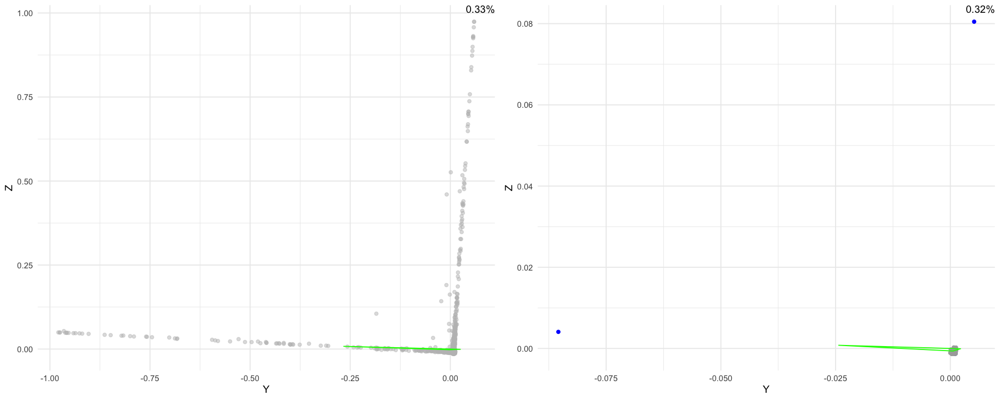

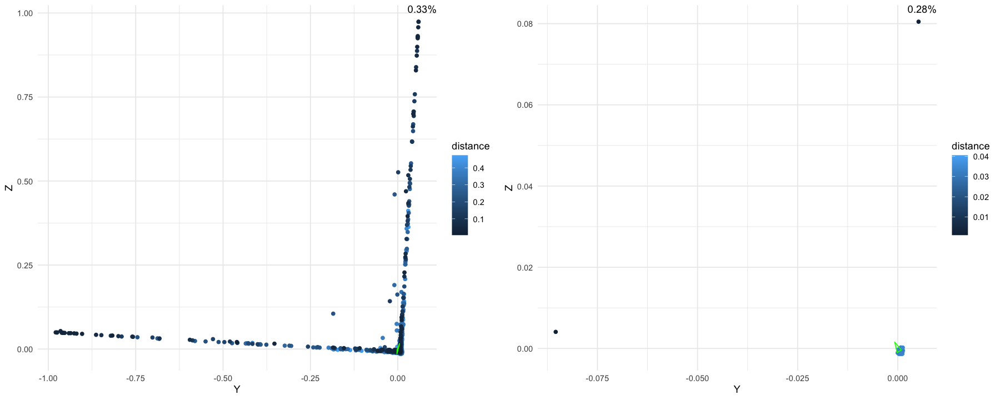

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


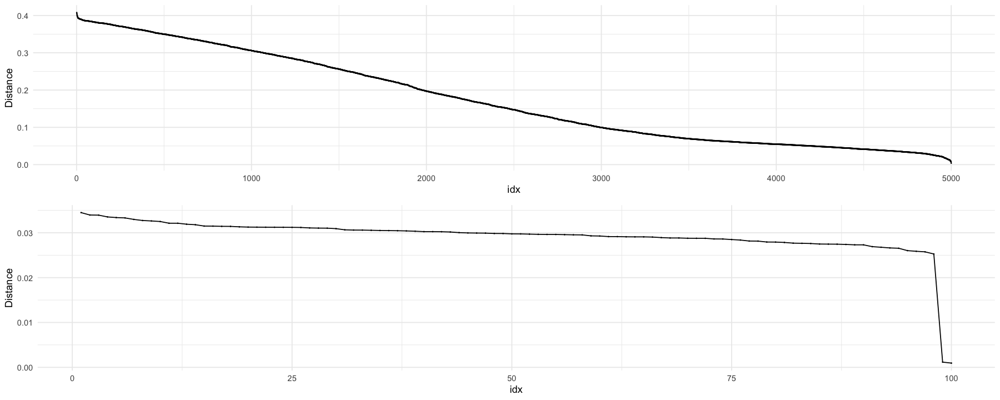

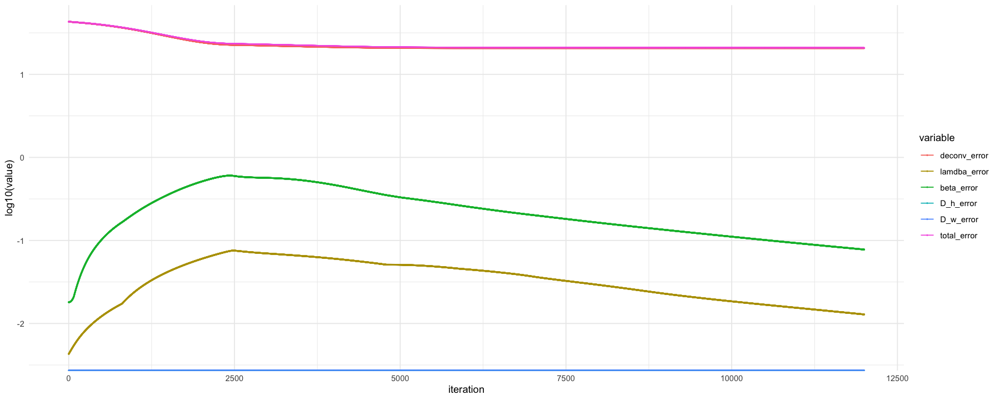

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 9



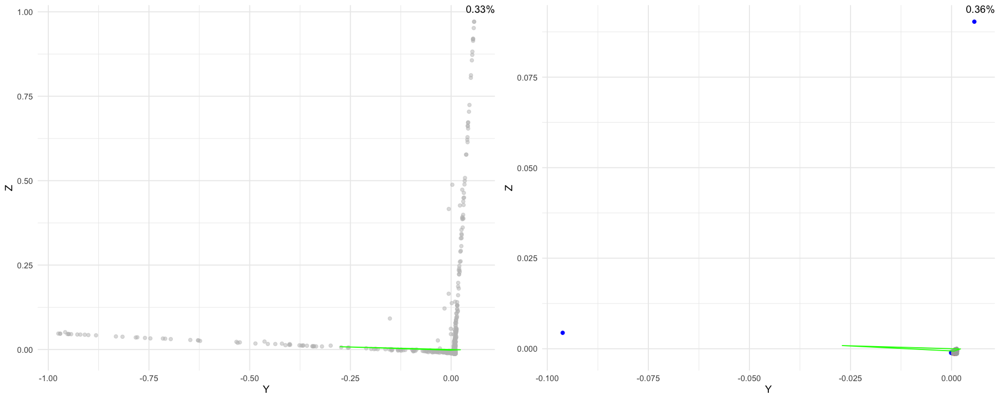

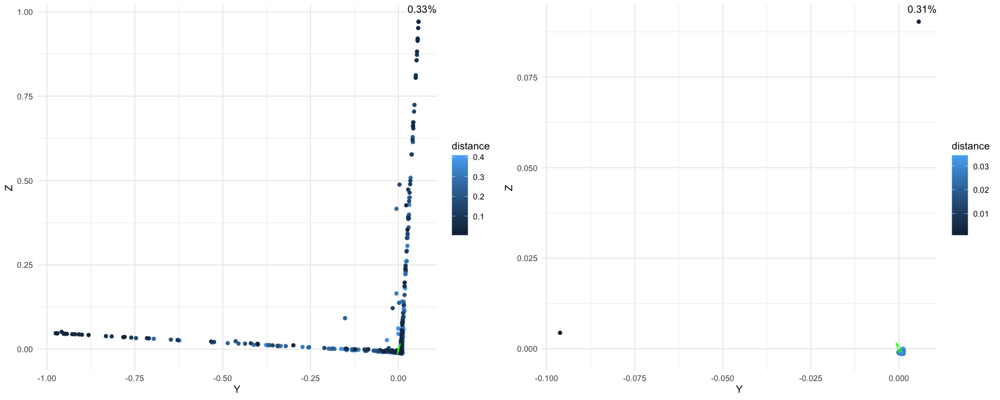

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


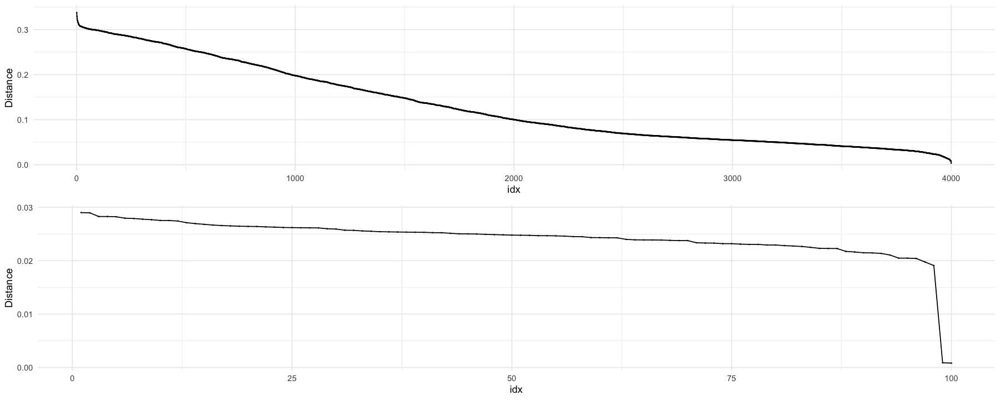

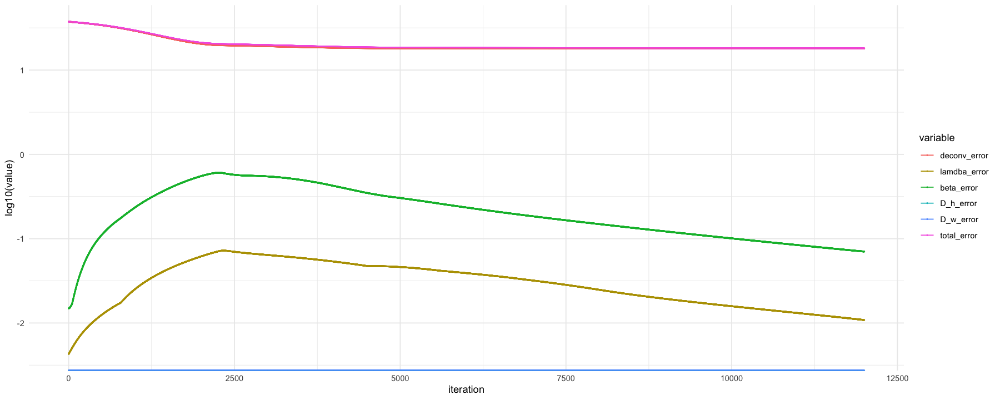

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 10



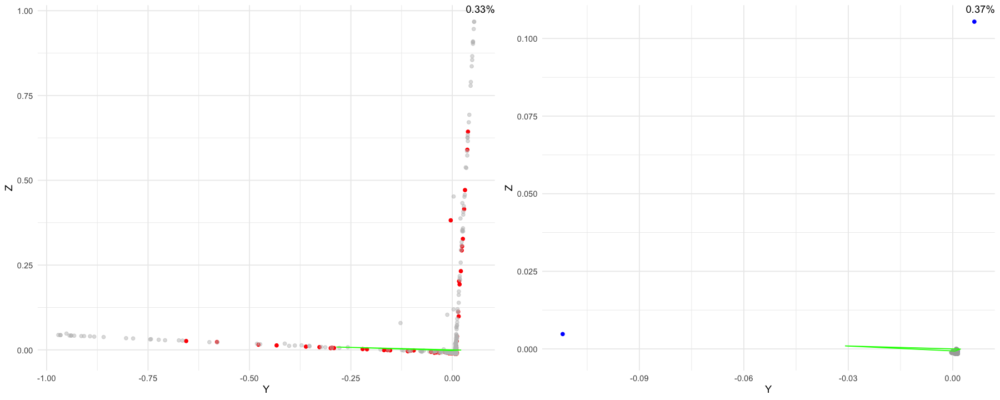

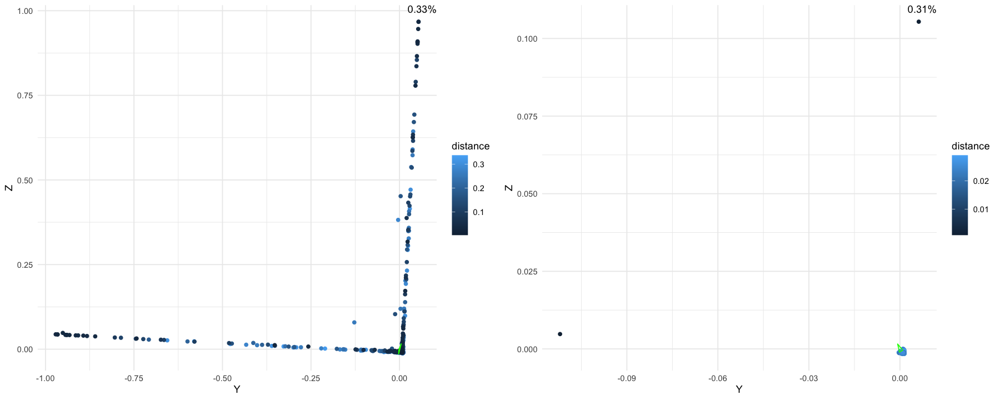

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


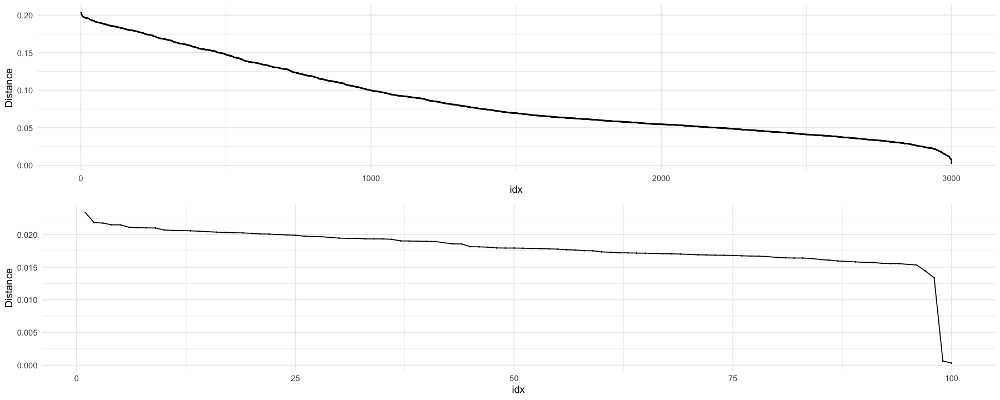

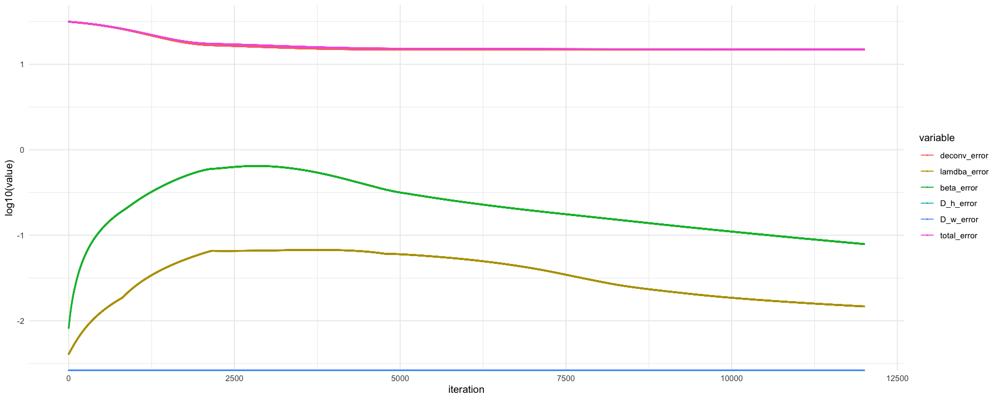

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


Iteration 11



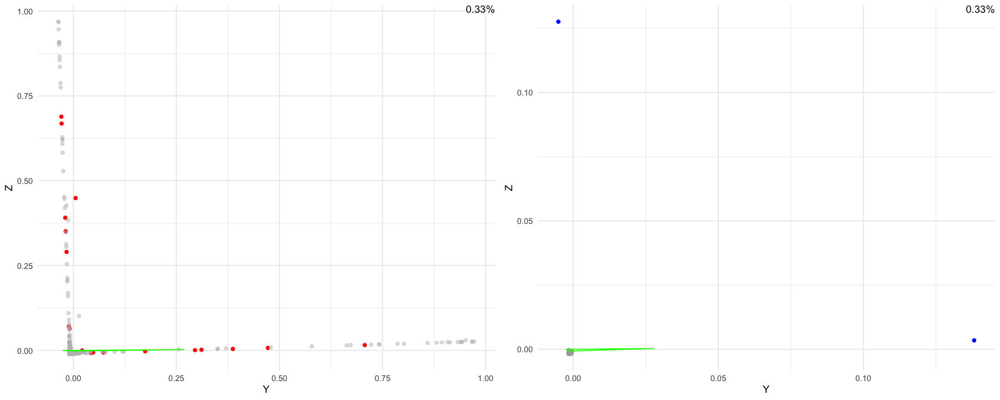

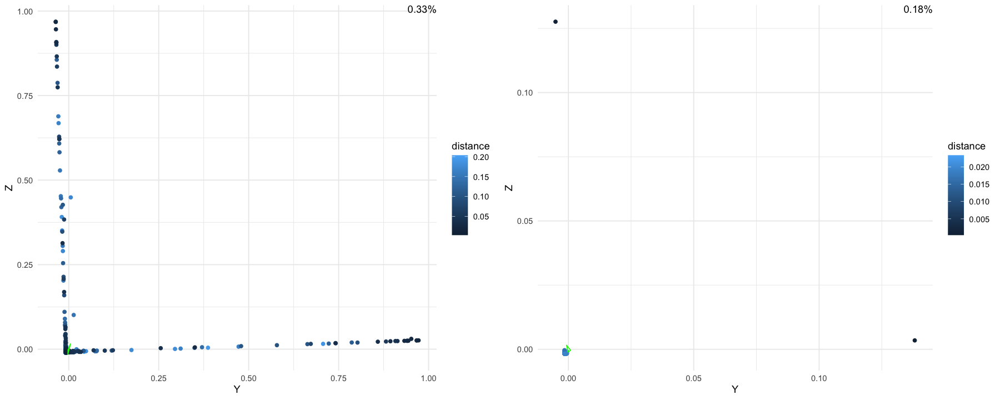

TableGrob (2 x 1) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (2-2,1-1) arrange gtable[layout]


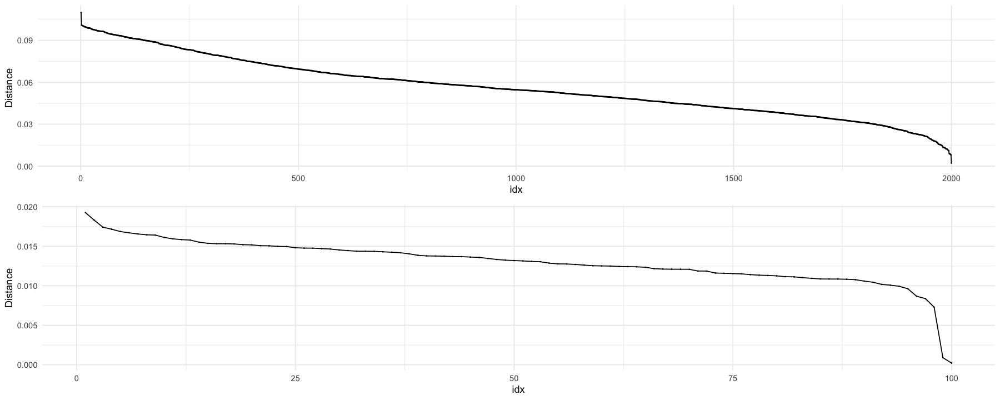

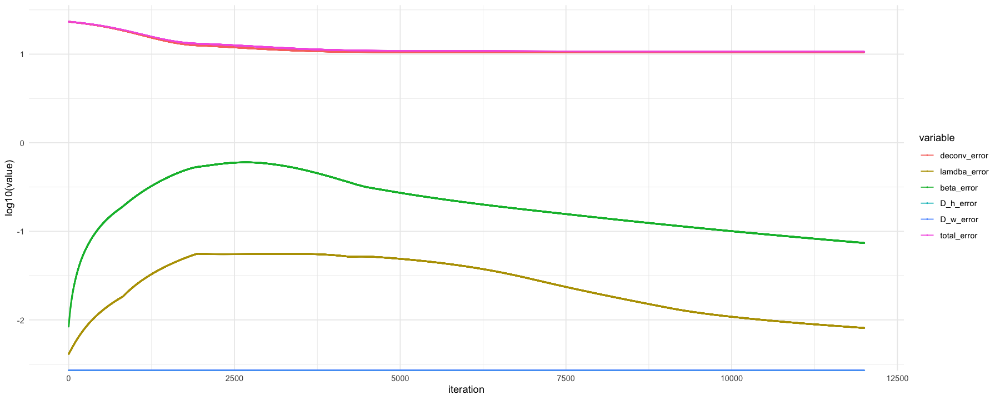

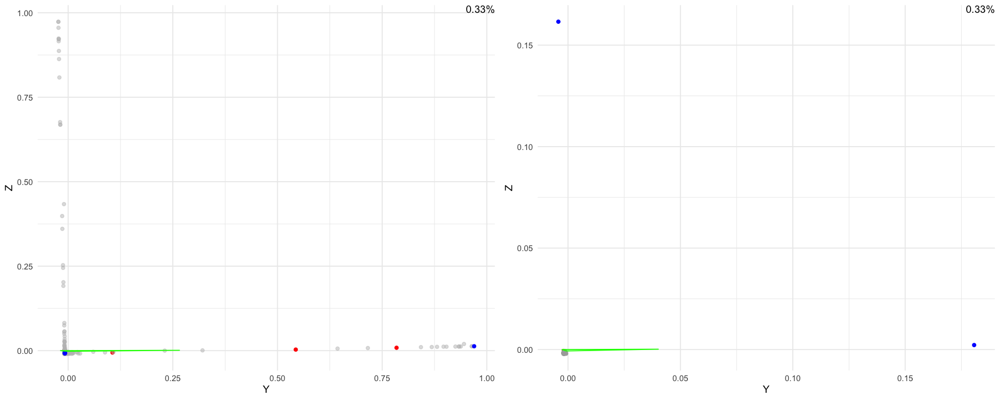

TableGrob (1 x 2) "arrange": 2 grobs
  z     cells    name           grob
1 1 (1-1,1-1) arrange gtable[layout]
2 2 (1-1,2-2) arrange gtable[layout]


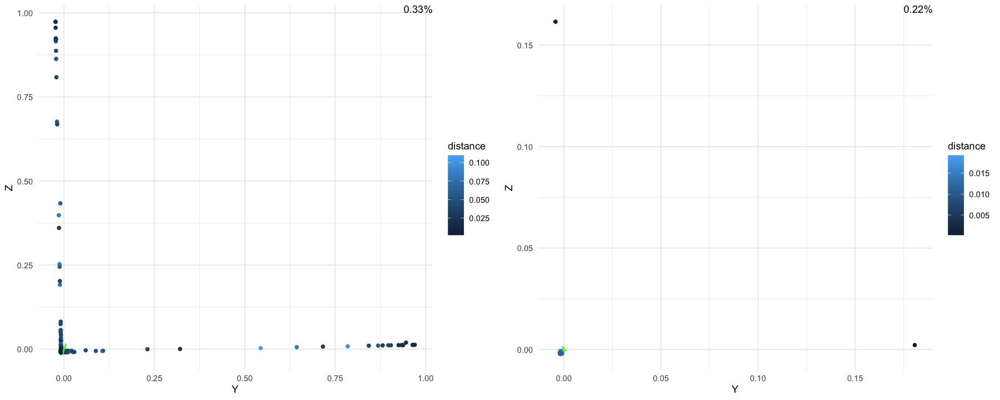

In [1104]:
i = length(stages_list)
while (i <= 10) {
    i = i + 1
    message(paste("Iteration", i))
    sim_100s_65_lo2_stages$filterByDistance(1000)
    sim_100s_65_lo2_stages$calculateDistances()
    stages_list[[i]] <- sim_100s_65_lo2_stages$clone(deep=T)
    show(do.call("grid.arrange", c(sim_100s_65_lo2_stages$plotDistances(), ncol=1)))
    run_block(lo2 = sim_100s_65_lo2_stages, true_props = sim_100s_65$proportions, iterations = 12000, startWithInit = T)
    show(do.call("grid.arrange", c(sim_100s_65_lo2_stages$plotPoints2D(), nrow=1)))
}

[[1]]

[[2]]


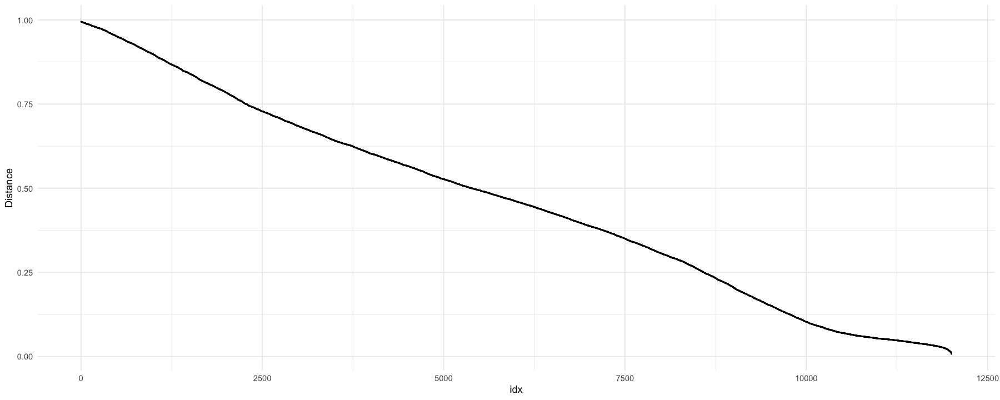

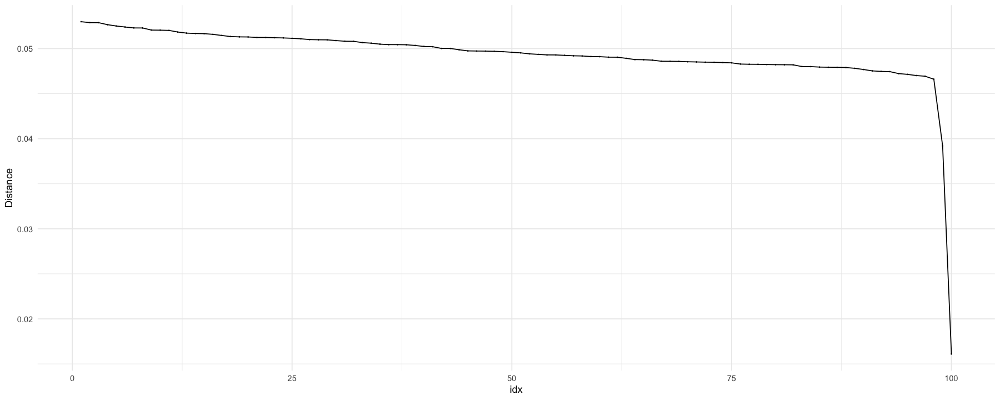

In [1555]:
stages_list[[1]]$plotDistances()

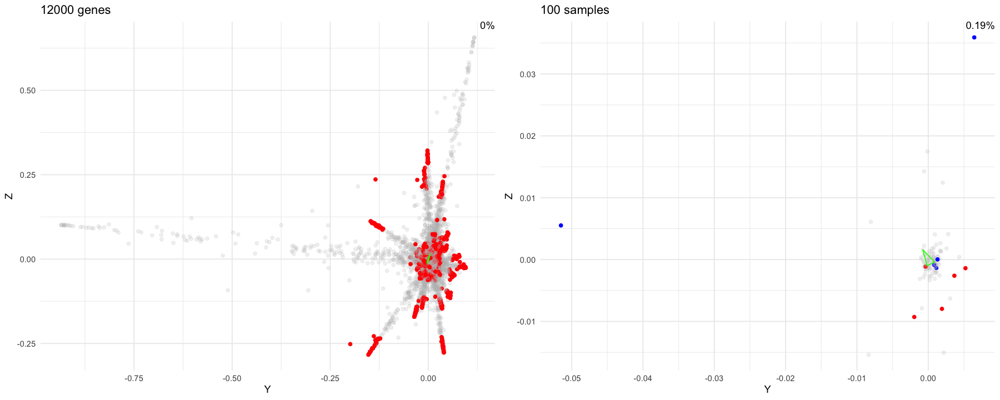

In [1302]:
plotPointsColored(stages_list[[1]], genes_borders = c(1, 10000), samples_borders = c(6, 95), mid_alpha = 0.2)

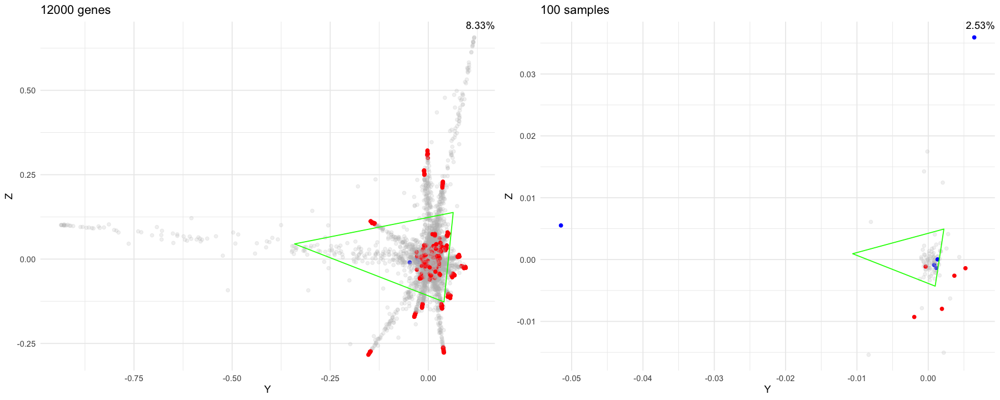

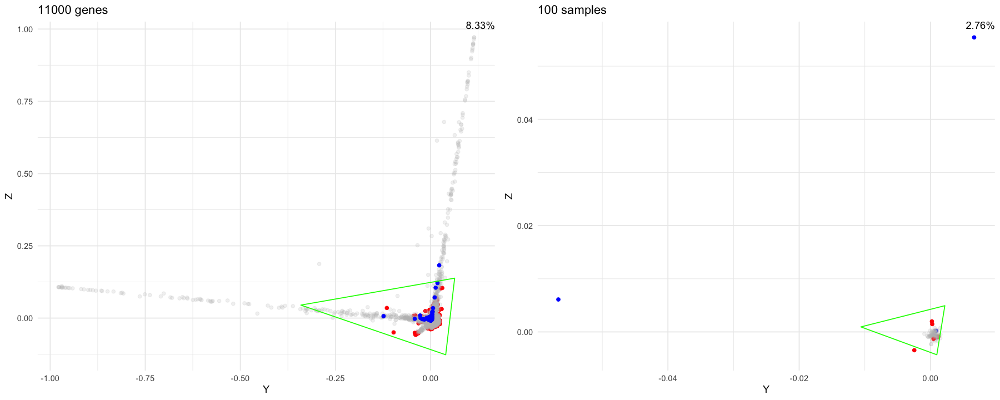

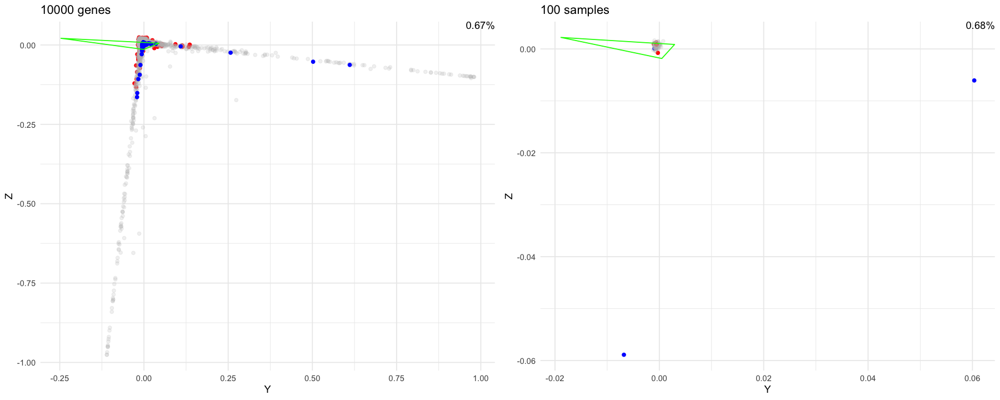

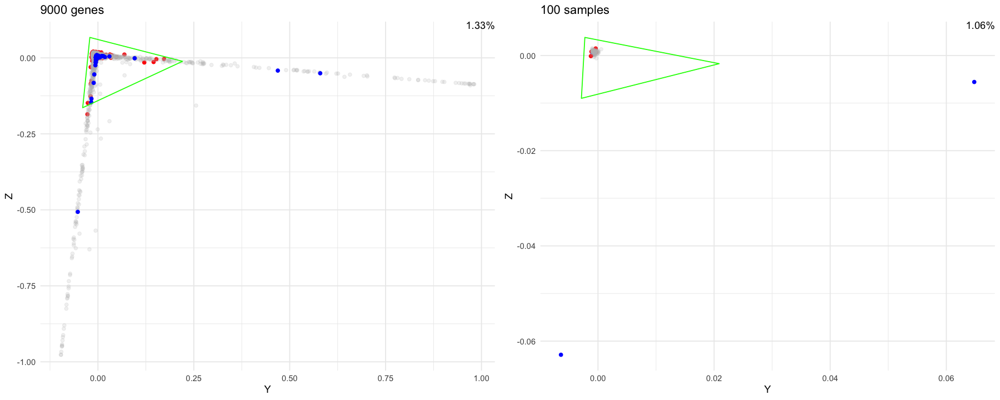

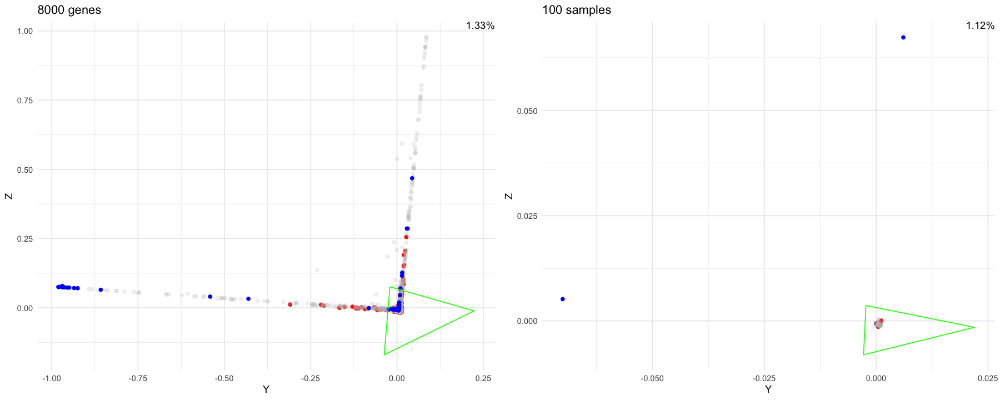

...

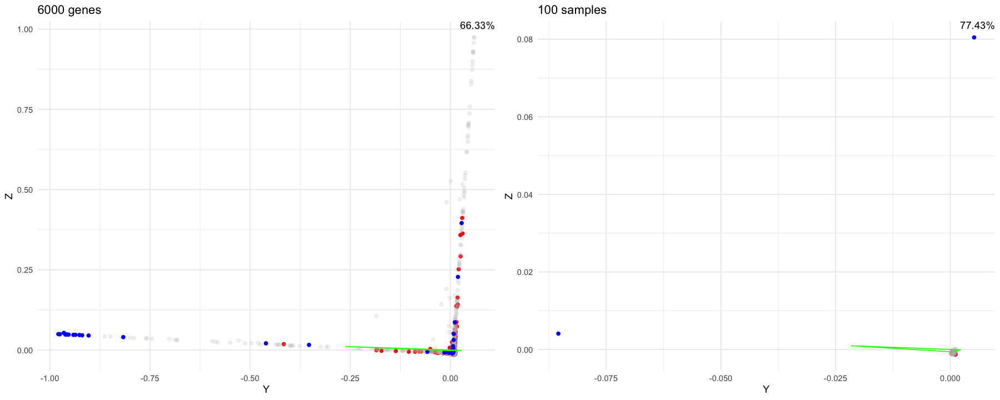

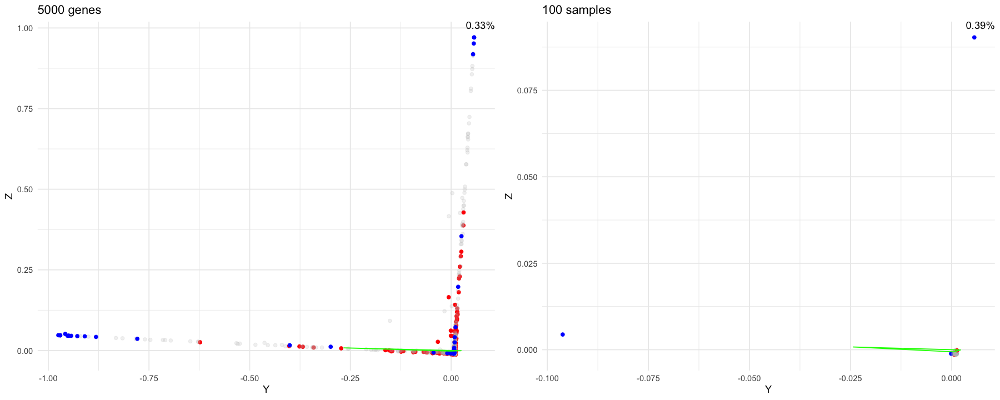

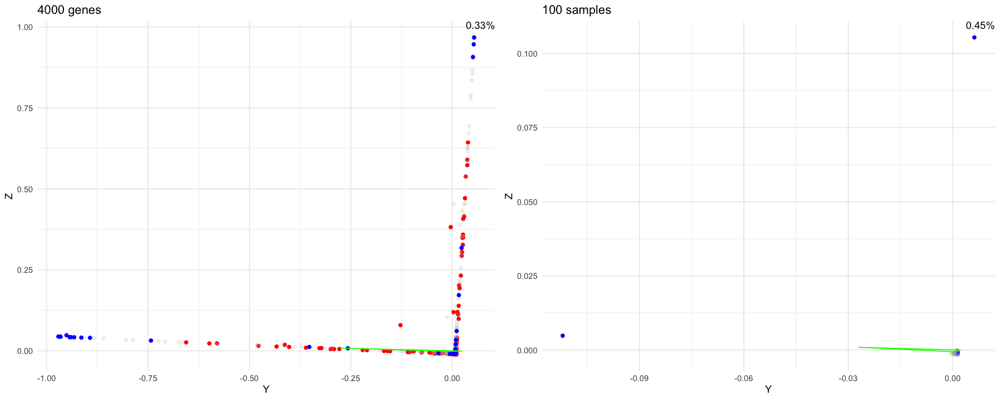

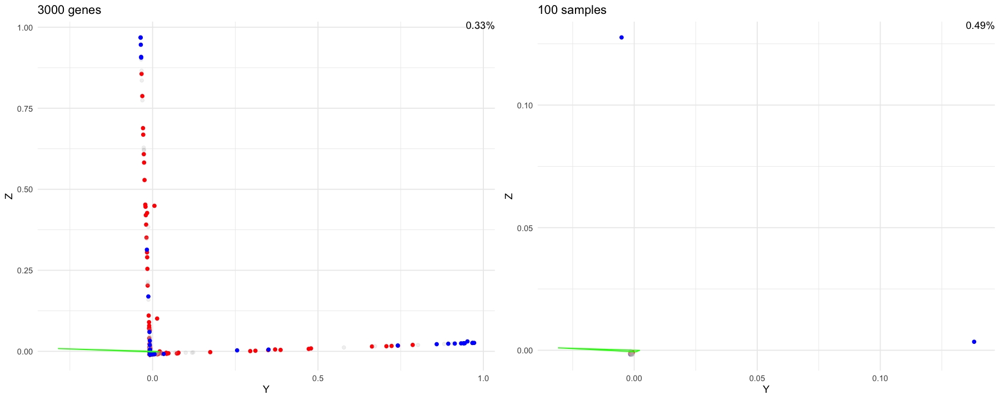

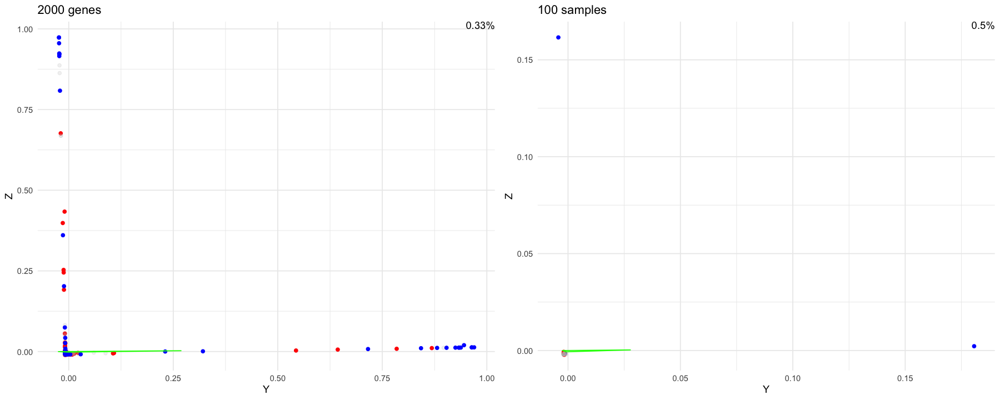

In [1304]:
for (i in seq_len(11)) {
    genes_borders <- c(500, length(stages_list[[i]]$distance_genes) - 1000)
    plotPointsColored(stages_list[[i]], "current", genes_borders = genes_borders, samples_borders = c(6, 95), mid_alpha = 0.2)
}

[[1]]

[[2]]


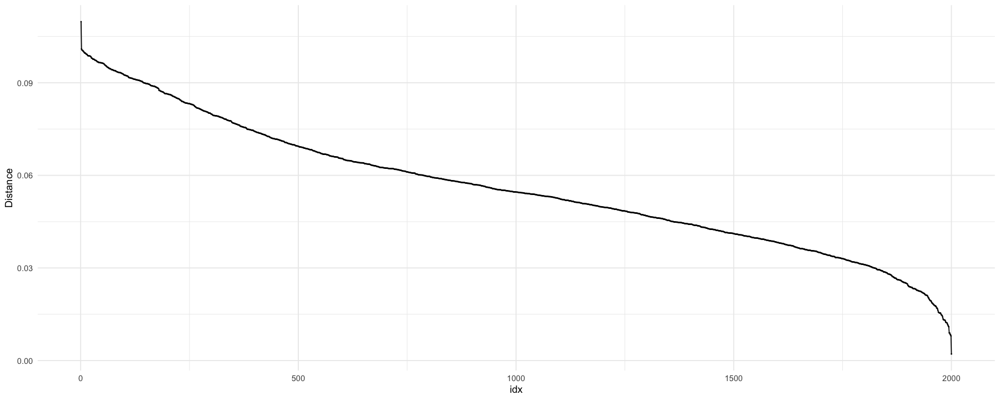

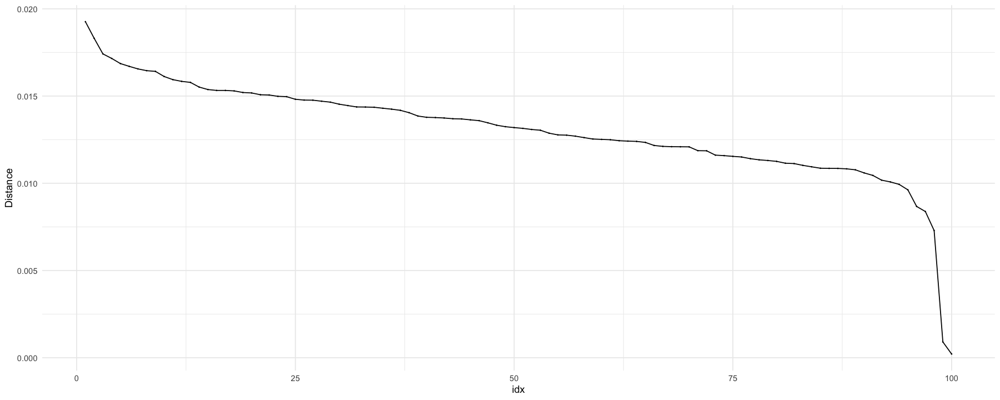

In [1554]:
stages_list[[11]]$plotDistances()

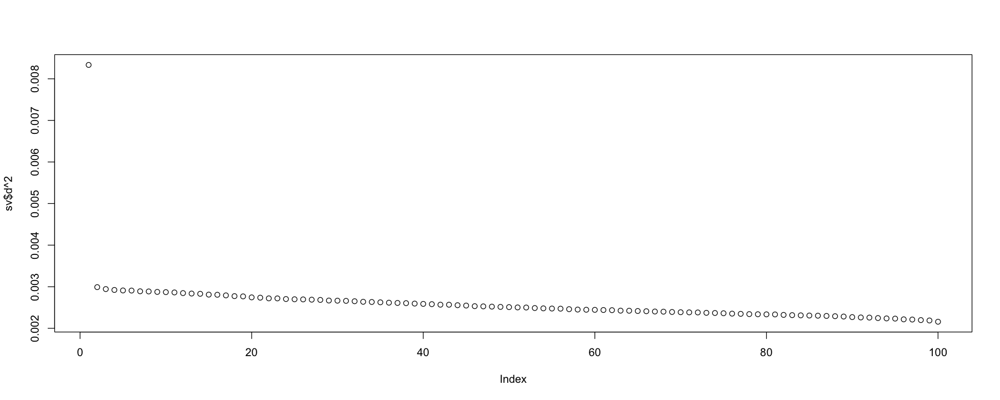

In [1556]:
sv <- svd(stages_list[[1]]$V_row)
plot(sv$d^2)

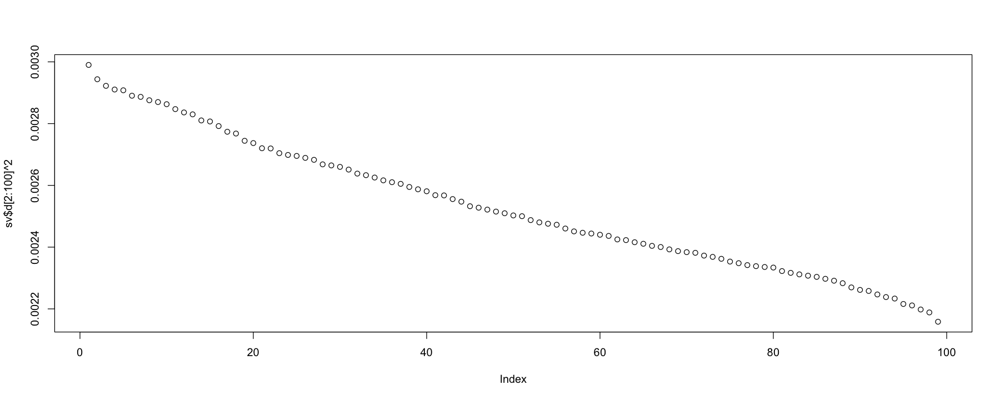

In [1558]:
plot(sv$d[2:100]^2)

# 07 Jul 2022

## Filter by distance

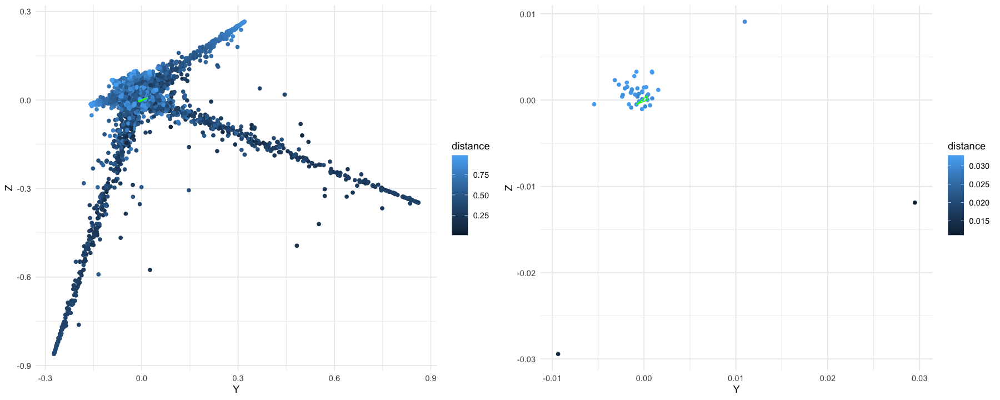

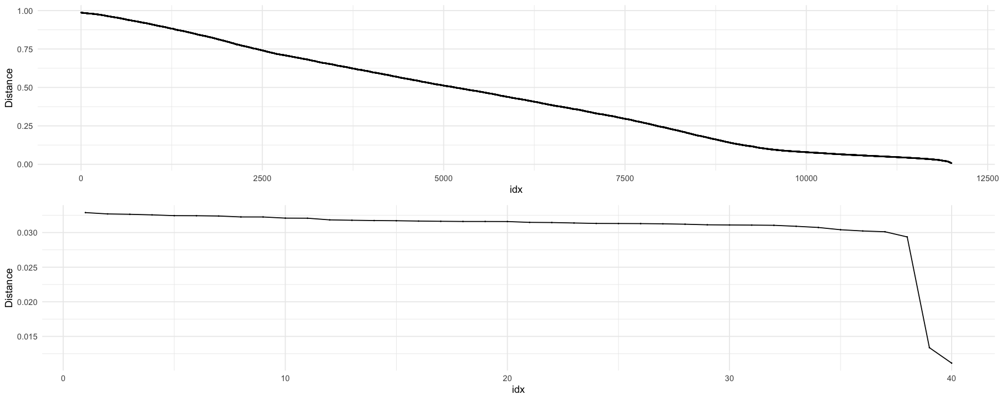

In [511]:
sim_65_lo2_dst <- init_lo2(sim_65$data, top_genes = 12000)

In [512]:
sim_65_lo2_dst$filterByDistance(10000)


Scaling dataset [>---------------------------]   3% eta:  9s

Scaling dataset [>---------------------------]   4% eta: 10s

Scaling dataset [>---------------------------]   5% eta: 10s

Scaling dataset [=>--------------------------]   6% eta: 11s

Scaling dataset [=>--------------------------]   7% eta: 11s

Scaling dataset [=>--------------------------]   8% eta: 11s

Scaling dataset [==>-------------------------]   9% eta: 11s

Scaling dataset [==>-------------------------]  10% eta: 11s

Scaling dataset [==>-------------------------]  11% eta: 11s

Scaling dataset [==>-------------------------]  12% eta: 11s

Scaling dataset [===>------------------------]  13% eta: 11s

Scaling dataset [===>------------------------]  14% eta: 11s

Scaling dataset [===>------------------------]  15% eta: 11s

Scaling dataset [===>------------------------]  16% eta: 10s

Scaling dataset [====>-----------------------]  17% eta: 10s

Scaling dataset [====>-----------------------]  18% eta: 10s

Scaling

In [513]:
sim_65_lo2_dst$calculateDistances()

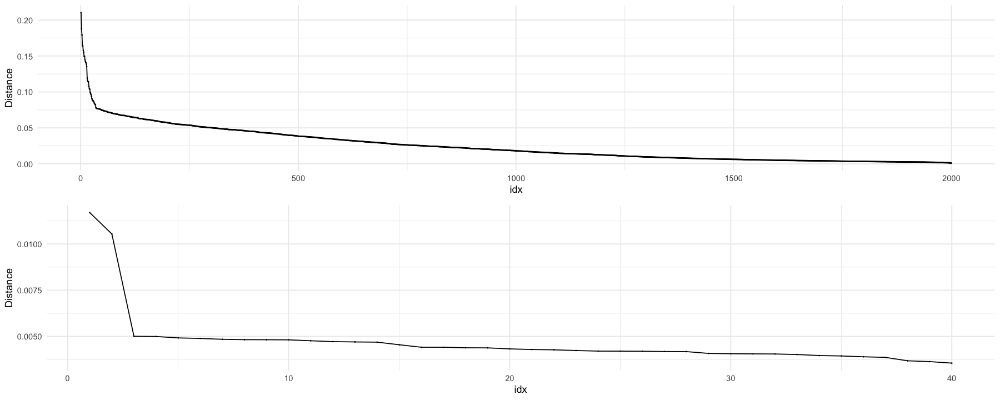

In [514]:
do.call("grid.arrange", c(sim_65_lo2_dst$plotDistances(), ncol = 1))

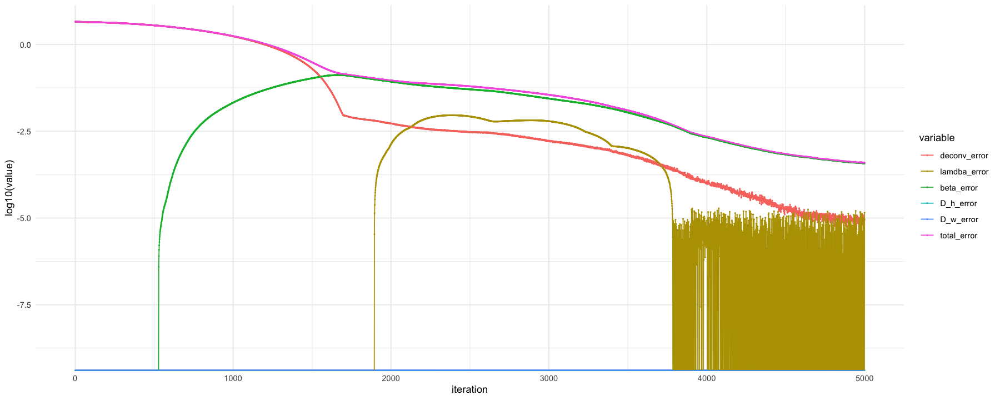

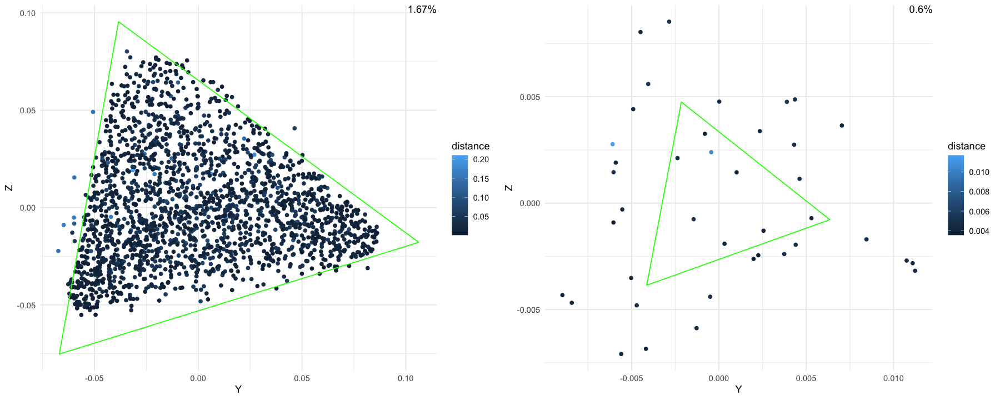

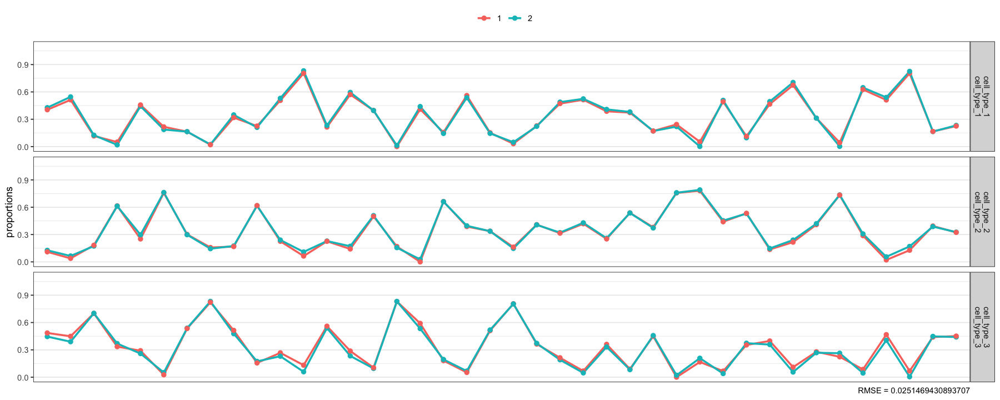

In [546]:
run_block(sim_65_lo2_dst, sim_65$proportions, iterations = 5000, startWithInit = T, coef_hinge_W = 1)

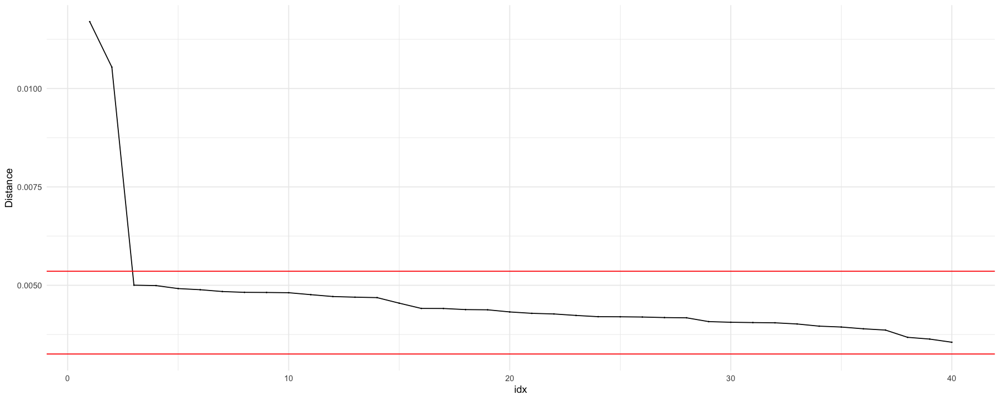

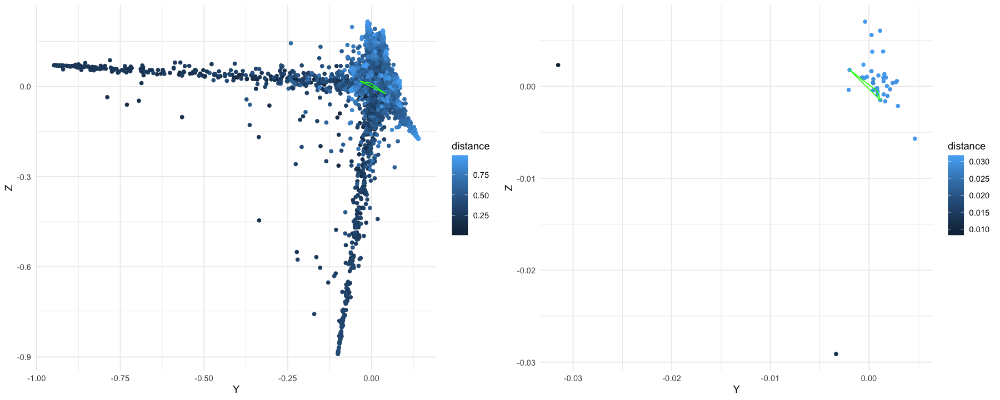

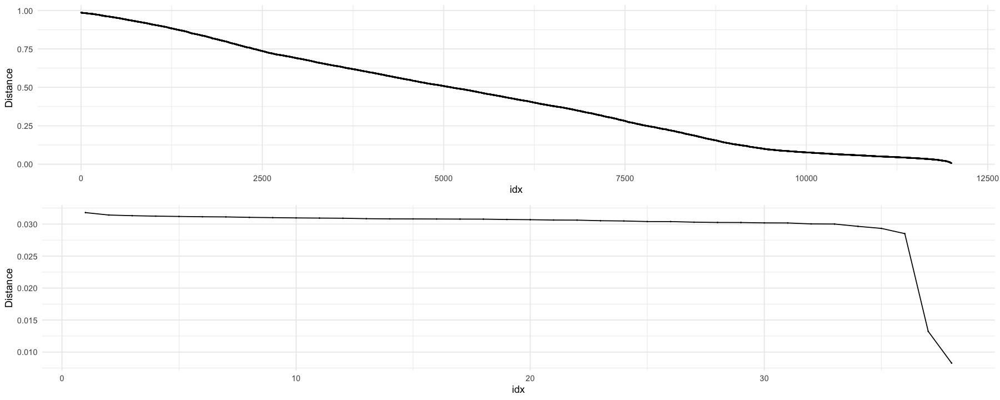

In [552]:
sim_65_samples_flt1 <- mad_cutoff(sim_65_lo2_dst, samples = T)
sim_65_data_flt1 <- sim_65_data[, colnames(sim_65_data) %in% sim_65_samples_flt1]
sim_65_lo2_flt1 <- init_lo2(sim_65_data_flt1, 12000)

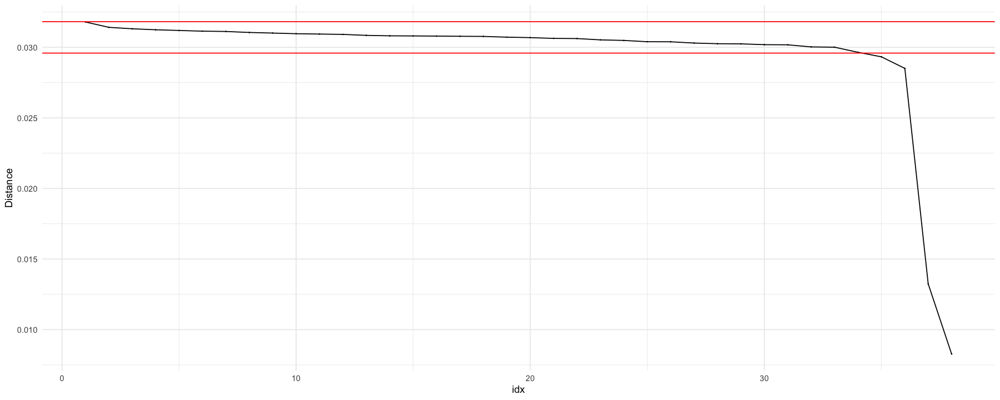

In [553]:
sim_65_samples_flt2 <- mad_cutoff(sim_65_lo2_flt1, samples = T)

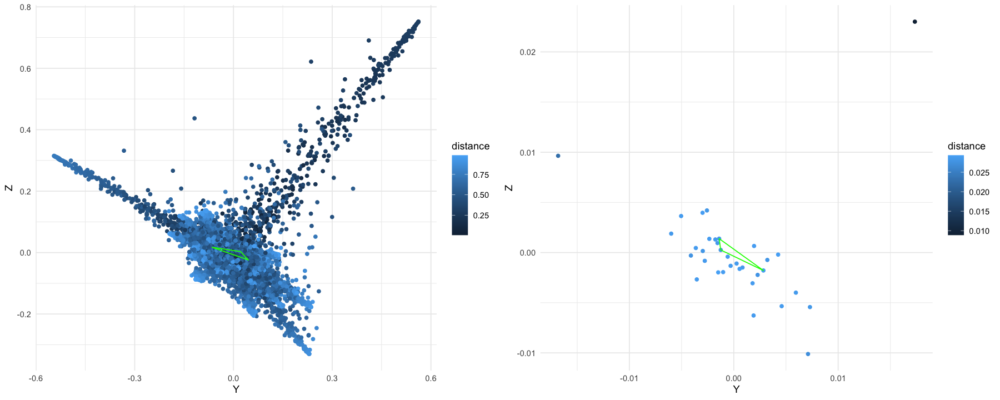

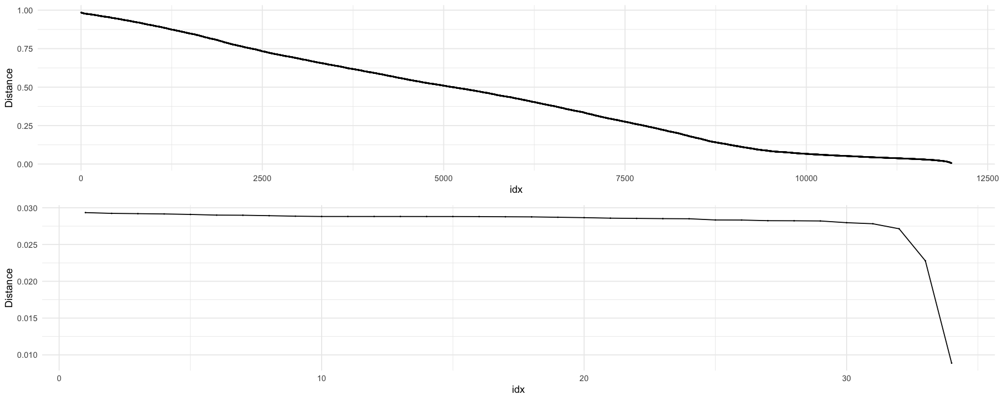

In [554]:
sim_65_data_flt2 <- sim_65_data_flt1[, colnames(sim_65_data_flt1) %in% sim_65_samples_flt2]
sim_65_lo2_flt2 <- init_lo2(sim_65_data_flt2, 12000)

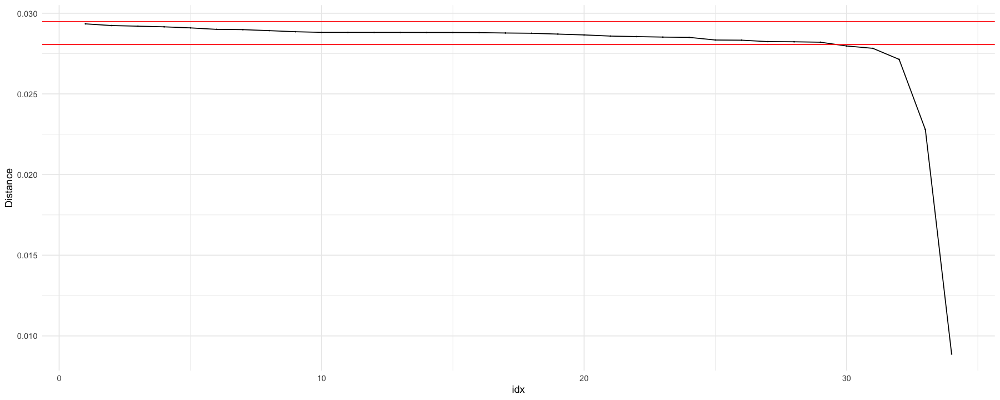

In [555]:
sim_65_samples_flt3 <- mad_cutoff(sim_65_lo2_flt2, samples = T)

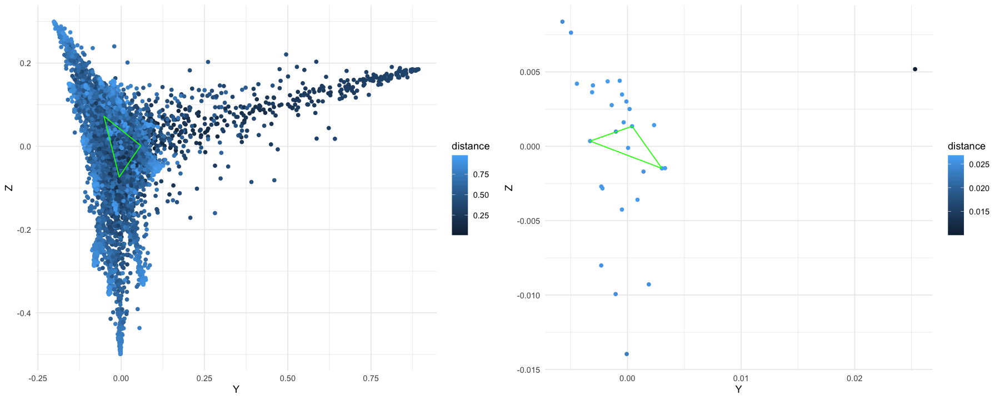

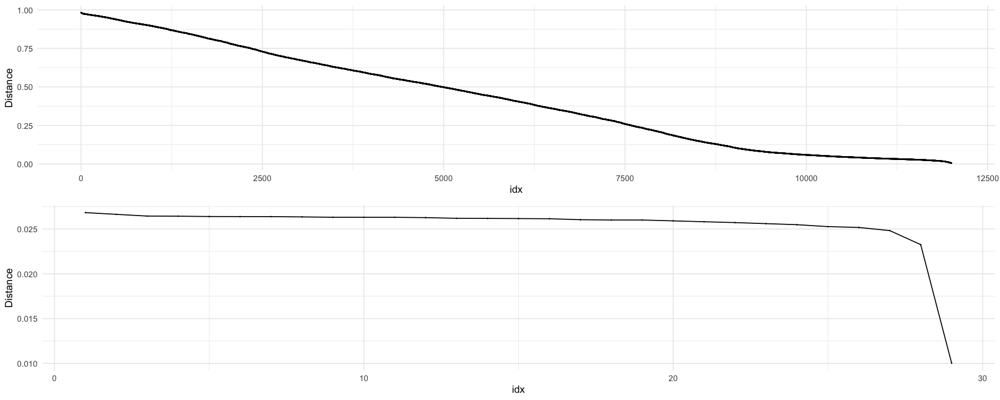

In [556]:
sim_65_data_flt3 <- sim_65_data_flt2[, colnames(sim_65_data_flt2) %in% sim_65_samples_flt3]
sim_65_lo2_flt3 <- init_lo2(sim_65_data_flt3, 12000)

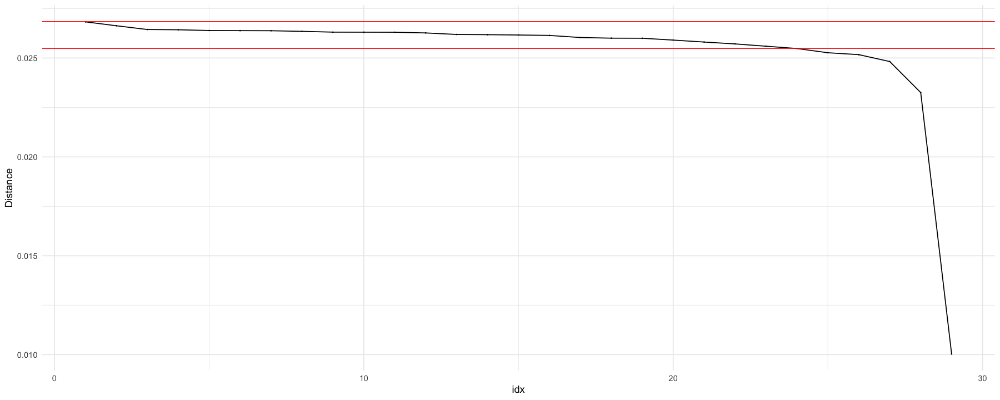

In [557]:
sim_65_samples_flt4 <- mad_cutoff(sim_65_lo2_flt3, samples = T)

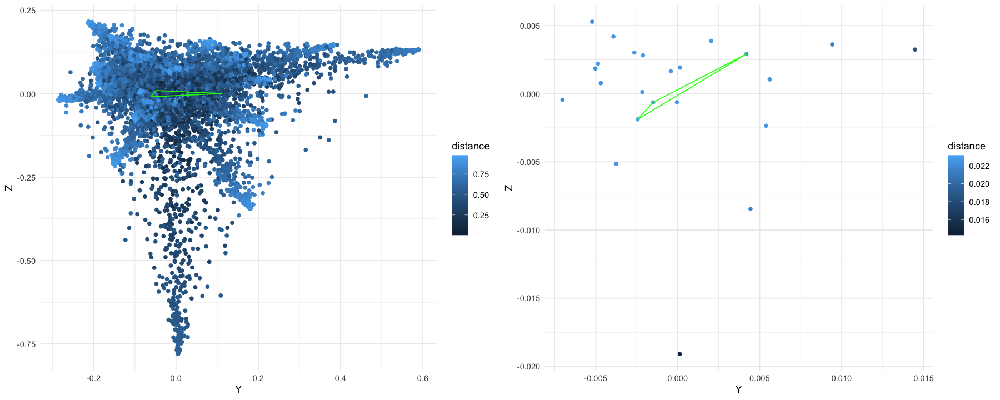

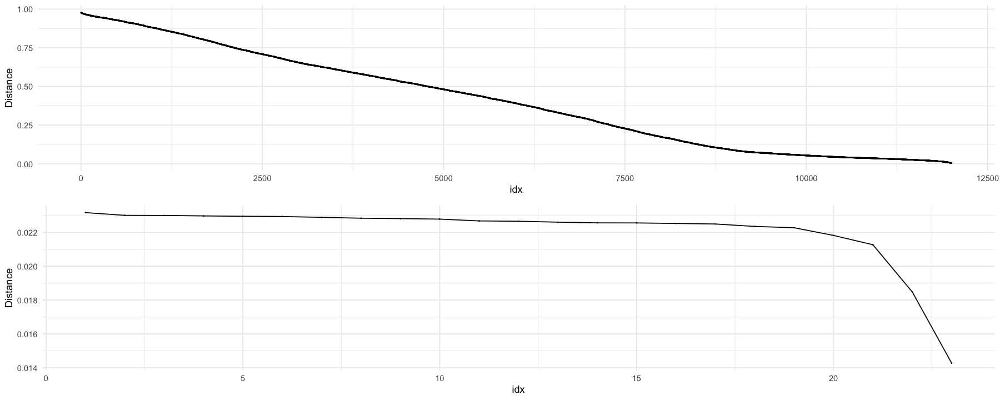

In [558]:
sim_65_data_flt4 <- sim_65_data_flt3[, colnames(sim_65_data_flt3) %in% sim_65_samples_flt4]
sim_65_lo2_flt4 <- init_lo2(sim_65_data_flt4, 12000)

In [563]:
sim_65_lo2_flt4$filterByDistance(7000)


Scaling dataset [>---------------------------]   2% eta: 13s

Scaling dataset [>---------------------------]   3% eta: 17s

Scaling dataset [>---------------------------]   4% eta: 19s

Scaling dataset [>---------------------------]   5% eta: 20s

Scaling dataset [=>--------------------------]   6% eta: 21s

Scaling dataset [=>--------------------------]   7% eta: 21s

Scaling dataset [=>--------------------------]   8% eta: 21s

Scaling dataset [==>-------------------------]   9% eta: 21s

Scaling dataset [==>-------------------------]  10% eta: 21s

Scaling dataset [==>-------------------------]  11% eta: 21s

Scaling dataset [==>-------------------------]  12% eta: 21s

Scaling dataset [===>------------------------]  13% eta: 21s

Scaling dataset [===>------------------------]  14% eta: 21s

Scaling dataset [===>------------------------]  15% eta: 21s

Scaling dataset [===>------------------------]  16% eta: 21s

Scaling dataset [====>-----------------------]  17% eta: 21s

Scaling

In [565]:
sim_65_lo2_flt4$calculateDistances()

[[1]]

[[2]]


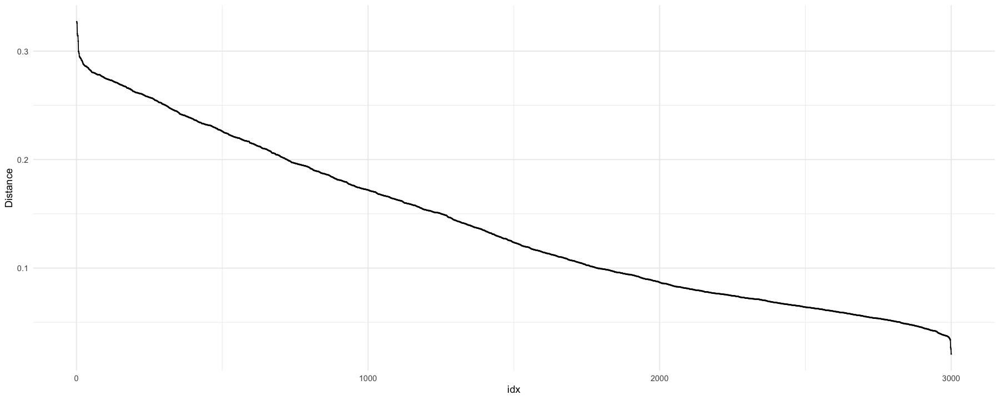

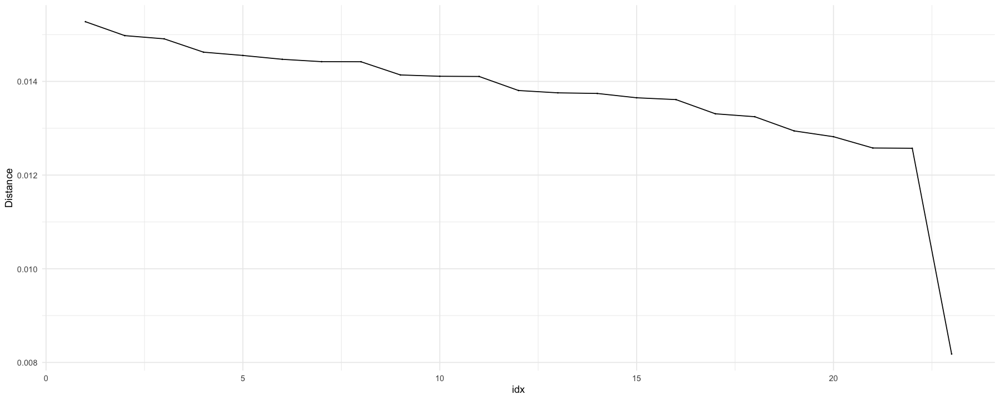

In [566]:
sim_65_lo2_flt4$plotDistances()

[[1]]

[[2]]


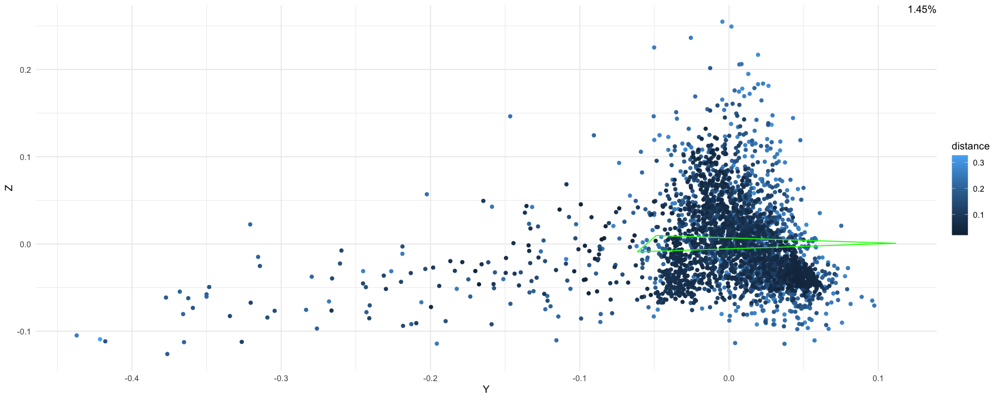

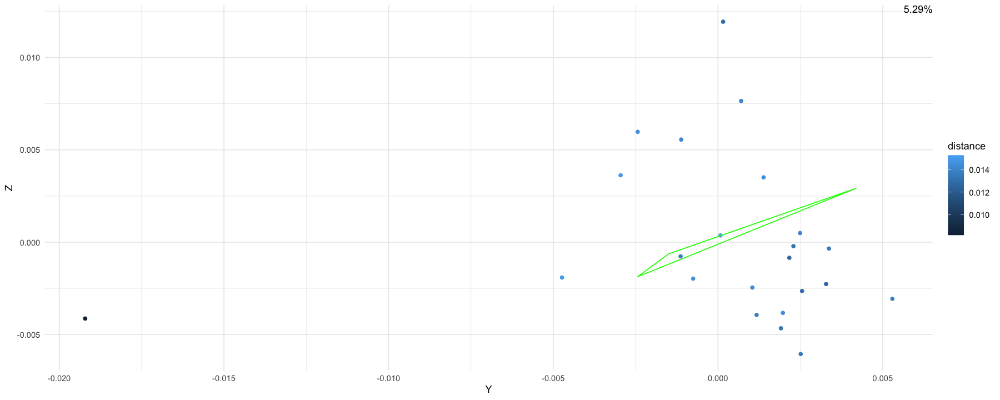

In [567]:
sim_65_lo2_flt4$plotPoints2D()

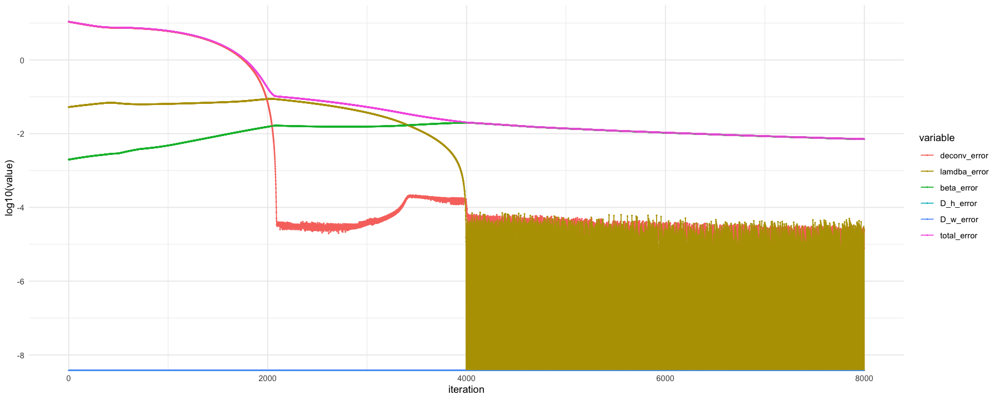

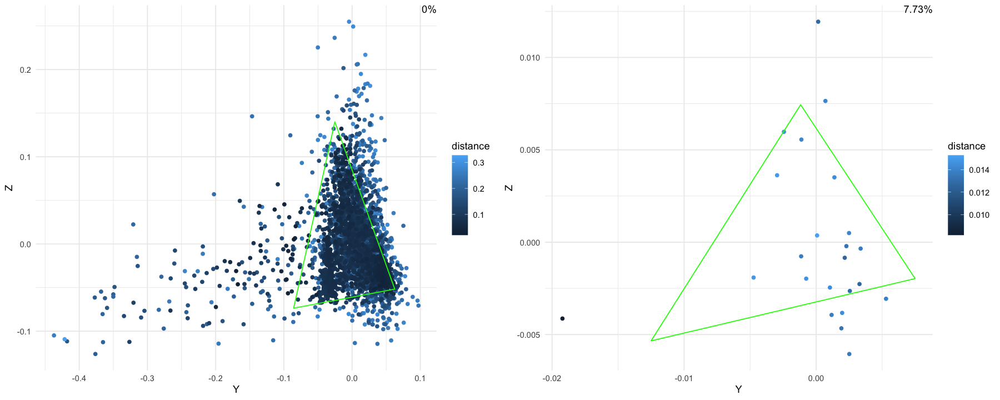

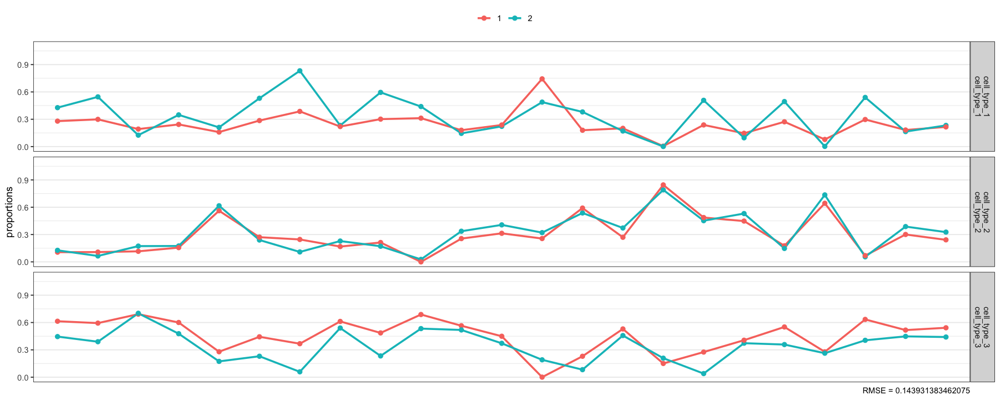

In [571]:
run_block(sim_65_lo2_flt4, sim_65$proportions[, colnames(sim_65_data_flt4)], iterations = 8000, startWithInit = T, coef_hinge_W = 0.1)


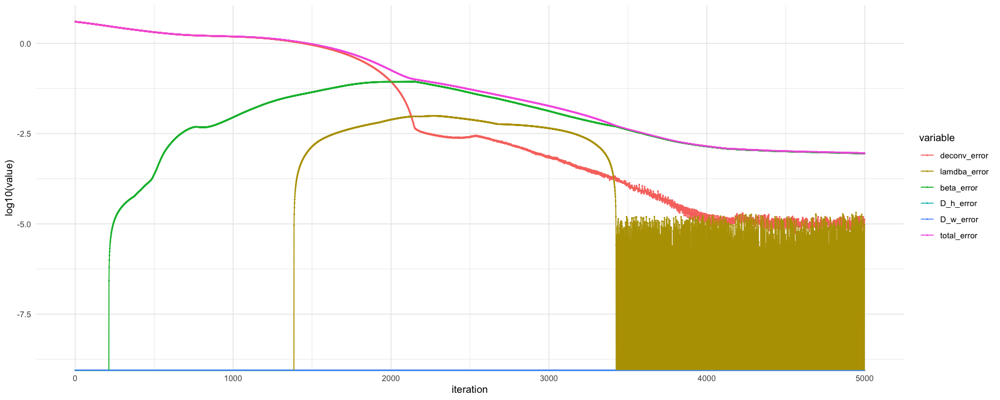

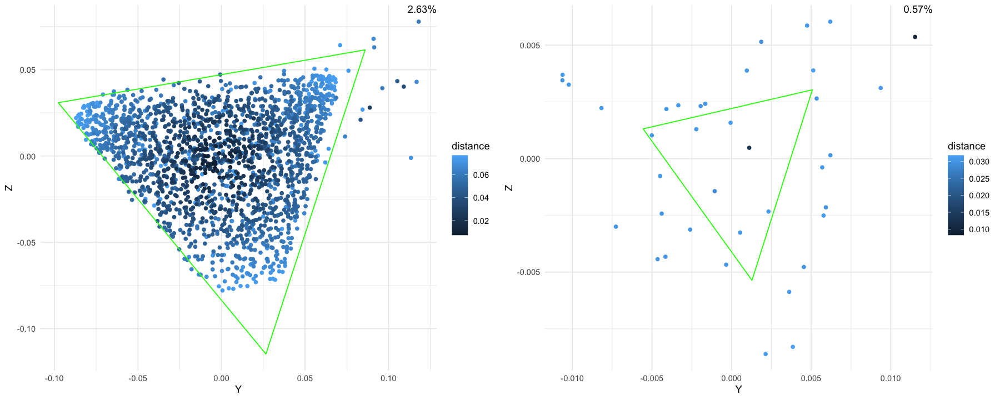

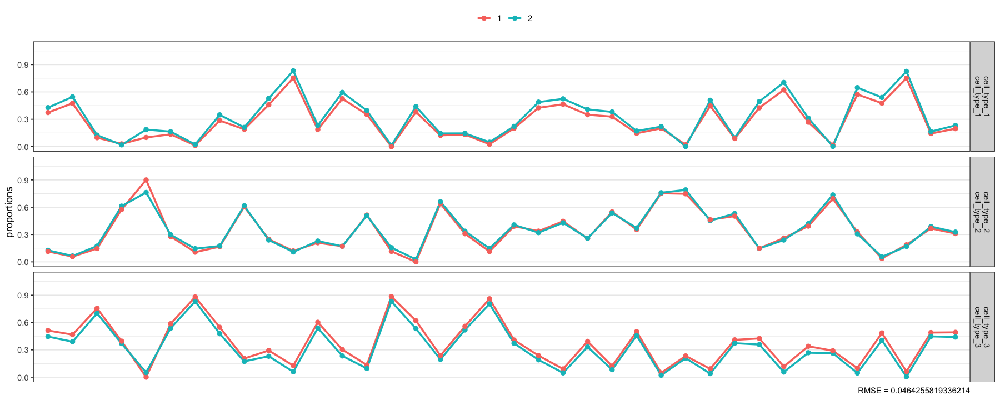

In [551]:
run_block(sim_65_lo2_flt1, sim_65$proportions[, colnames(sim_65_data_flt1)], iterations = 5000, startWithInit = T, coef_hinge_W = 1)



## Add more samples

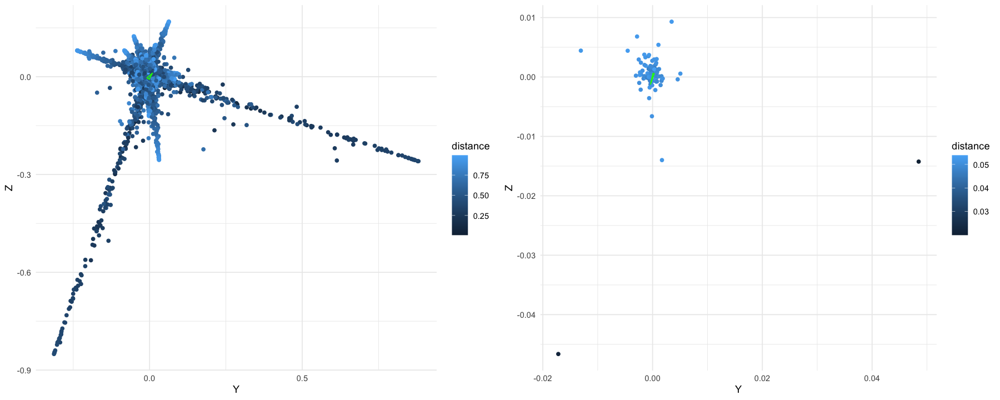

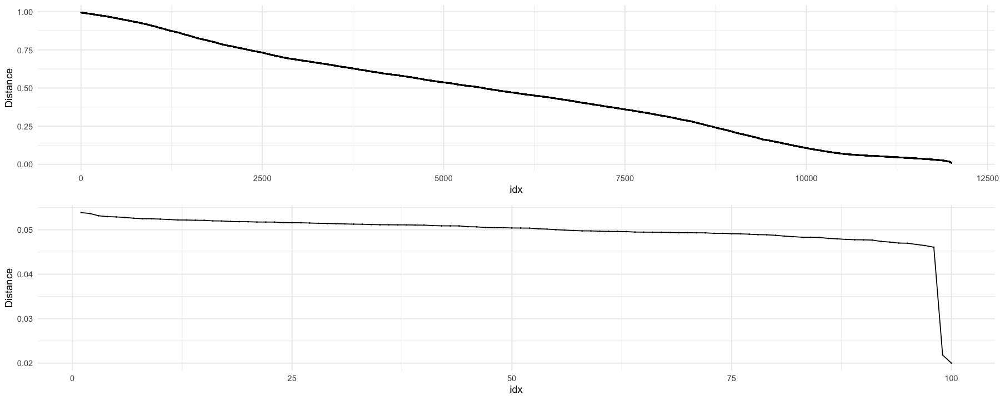

In [517]:
sim_100s_65_lo2 <- init_lo2(sim_100s_65$data, top_genes = 12000)

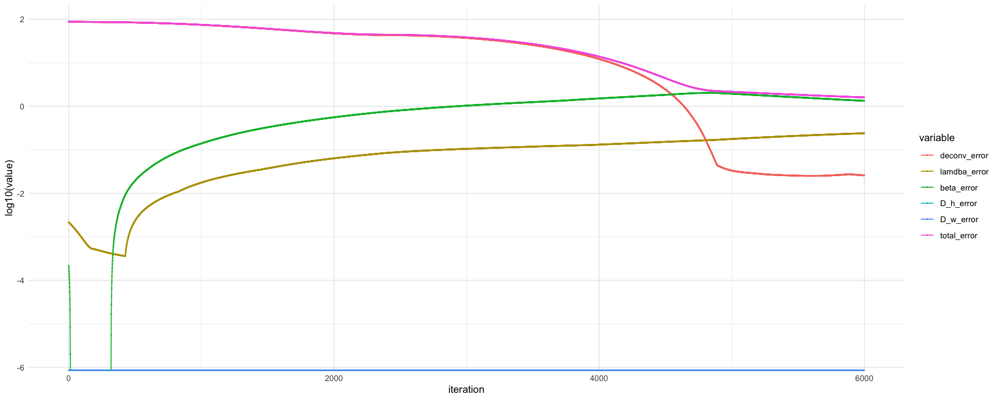

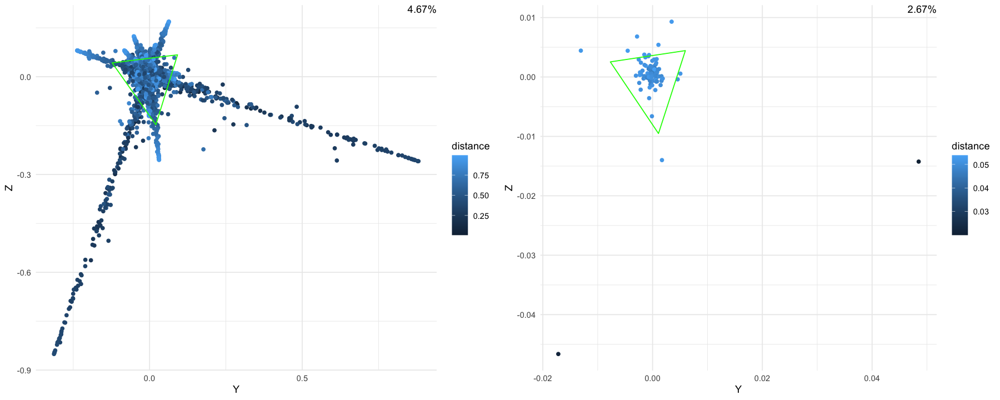

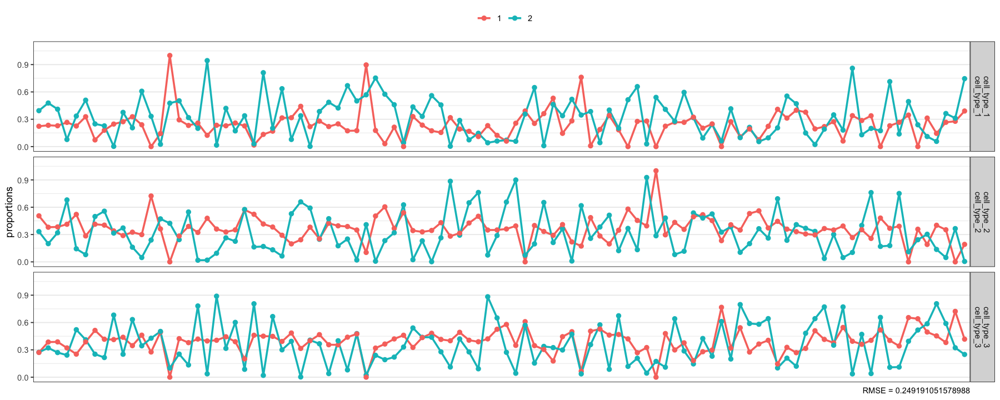

In [518]:
run_block(sim_100s_65_lo2, sim_100s_65$proportions, iterations = 6000, startWithInit = F)

In [520]:
sim_100s_65_lo2$filterByDistance(10000)


Scaling dataset [>---------------------------]   2% eta: 15s

Scaling dataset [>---------------------------]   3% eta: 20s

Scaling dataset [>---------------------------]   4% eta: 23s

Scaling dataset [>---------------------------]   5% eta: 25s

Scaling dataset [=>--------------------------]   6% eta: 25s

Scaling dataset [=>--------------------------]   7% eta: 26s

Scaling dataset [=>--------------------------]   8% eta: 26s

Scaling dataset [==>-------------------------]   9% eta: 26s

Scaling dataset [==>-------------------------]  10% eta: 26s

Scaling dataset [==>-------------------------]  11% eta: 26s

Scaling dataset [==>-------------------------]  12% eta: 26s

Scaling dataset [===>------------------------]  13% eta: 26s

Scaling dataset [===>------------------------]  14% eta: 25s

Scaling dataset [===>------------------------]  15% eta: 25s

Scaling dataset [===>------------------------]  16% eta: 25s

Scaling dataset [====>-----------------------]  17% eta: 25s

Scaling

In [521]:
sim_100s_65_lo2$calculateDistances()

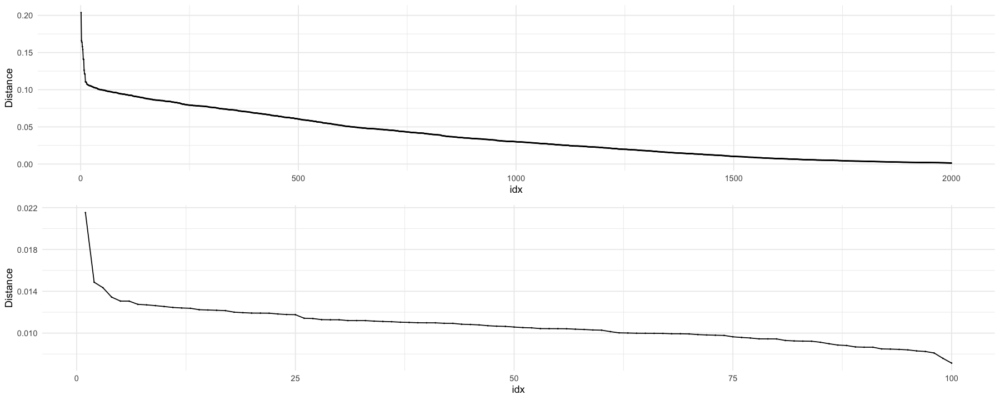

In [522]:
do.call("grid.arrange", c(sim_100s_65_lo2$plotDistances(), ncol = 1))

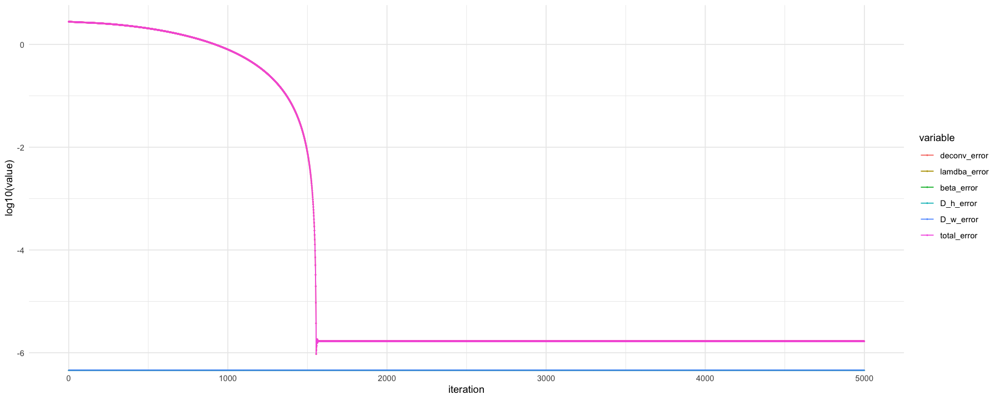

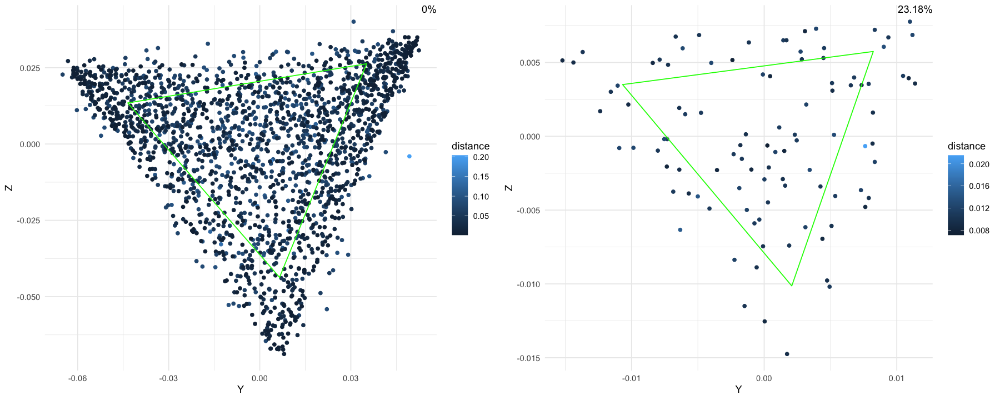

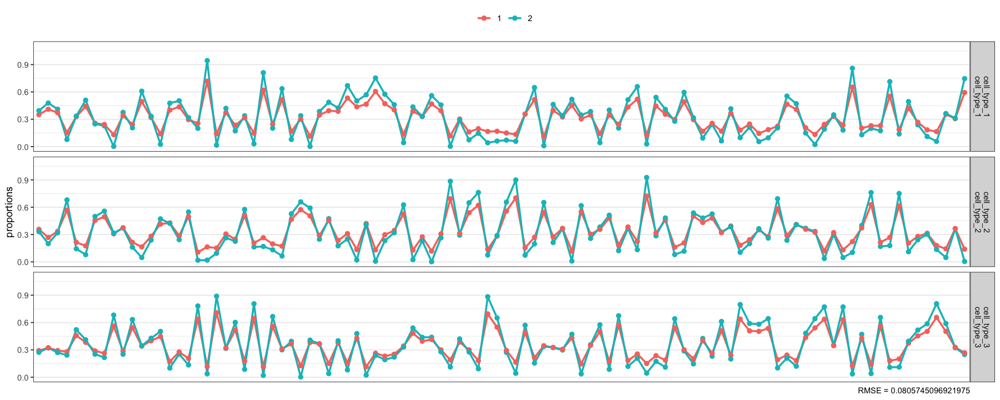

In [574]:
run_block(sim_100s_65_lo2, sim_100s_65$proportions, iterations = 5000, startWithInit = T, coef_hinge_W = 0)

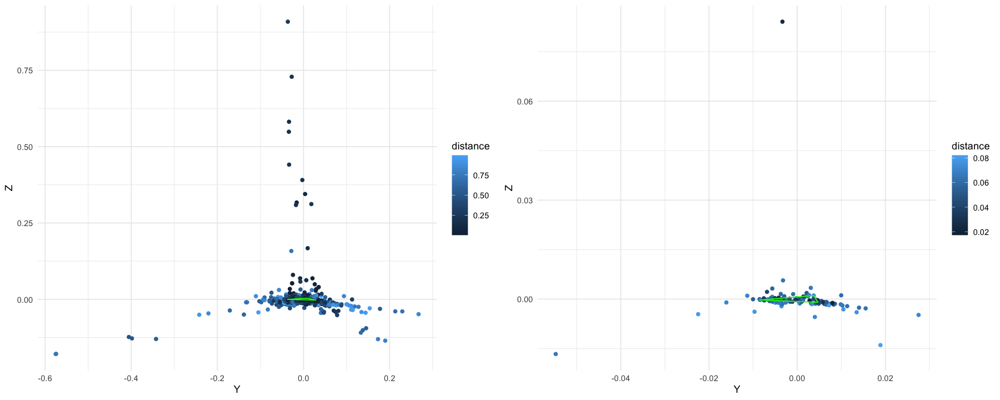

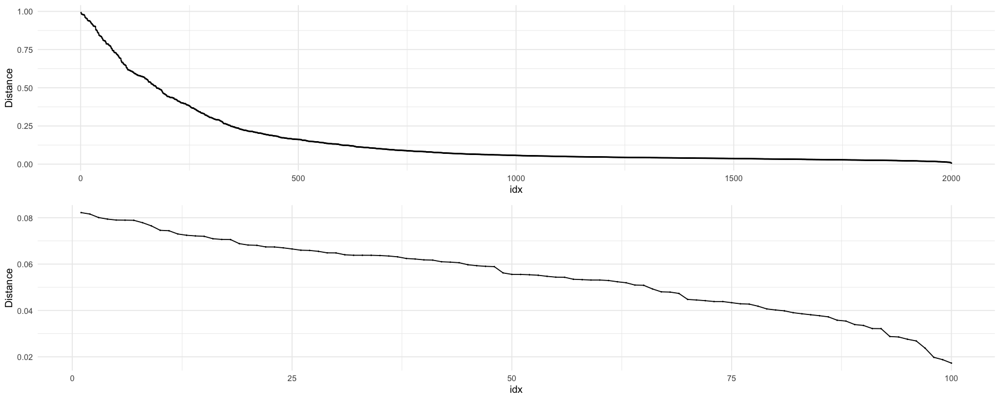

In [524]:
sim_100s_65_lo2_top_mad <- init_lo2(sim_100s_65$data, 2000)

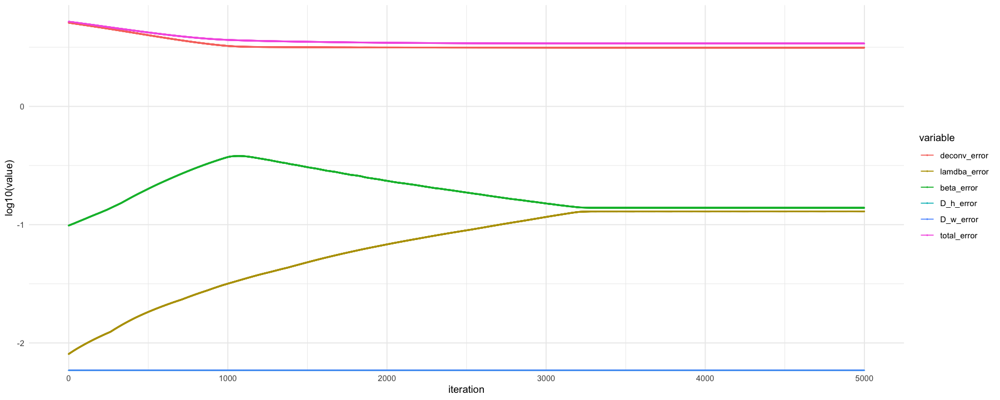

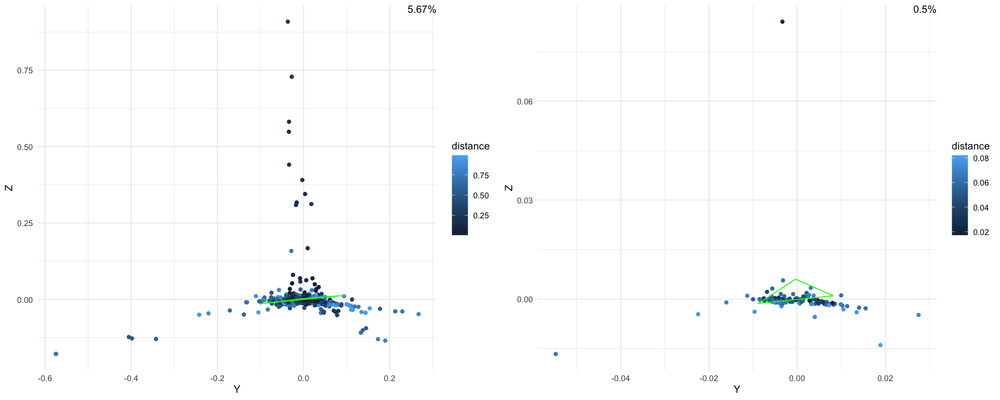

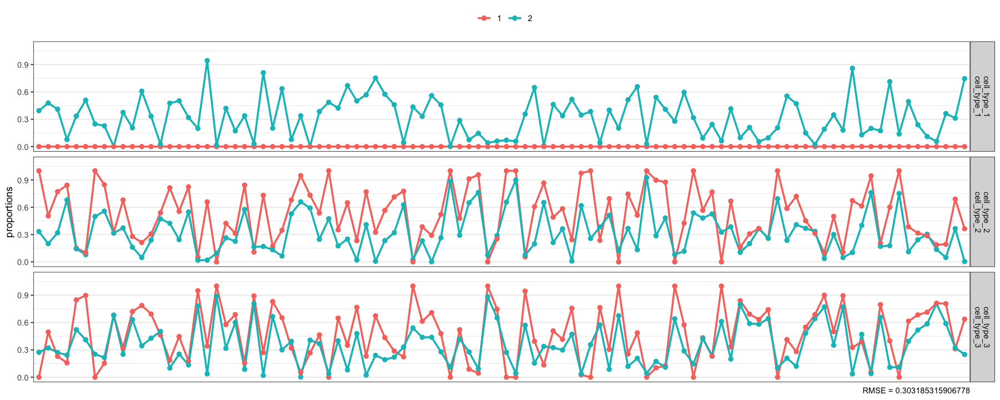

In [525]:
run_block(sim_100s_65_lo2_top_mad, sim_100s_65$proportions, iterations = 5000, startWithInit = F)

## GSE19830

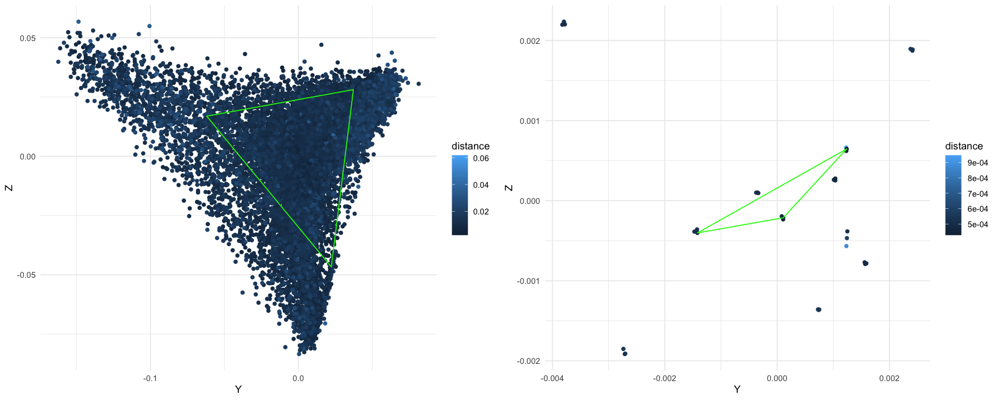

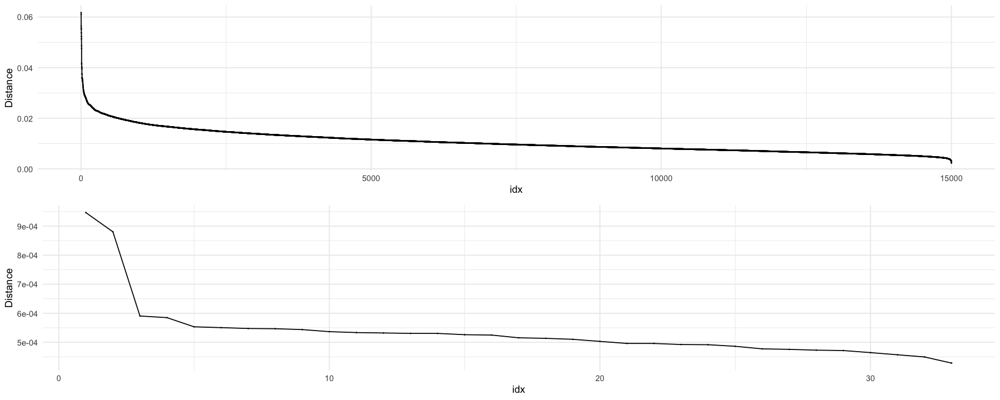

In [526]:
GSE19830_lo2_flt_dist <- init_lo2(GSE19830.data, 15000)

In [527]:
GSE19830_lo2_flt_dist$filterByDistance(12000)


Scaling dataset [>---------------------------]   2% eta: 12s

Scaling dataset [>---------------------------]   3% eta: 16s

Scaling dataset [>---------------------------]   4% eta: 18s

Scaling dataset [>---------------------------]   5% eta: 20s

Scaling dataset [=>--------------------------]   6% eta: 20s

Scaling dataset [=>--------------------------]   7% eta: 21s

Scaling dataset [=>--------------------------]   8% eta: 21s

Scaling dataset [==>-------------------------]   9% eta: 21s

Scaling dataset [==>-------------------------]  10% eta: 21s

Scaling dataset [==>-------------------------]  11% eta: 21s

Scaling dataset [==>-------------------------]  12% eta: 21s

Scaling dataset [===>------------------------]  13% eta: 21s

Scaling dataset [===>------------------------]  14% eta: 21s

Scaling dataset [===>------------------------]  15% eta: 21s

Scaling dataset [===>------------------------]  16% eta: 20s

Scaling dataset [====>-----------------------]  17% eta: 20s

Scaling

In [528]:
GSE19830_lo2_flt_dist$calculateDistances()

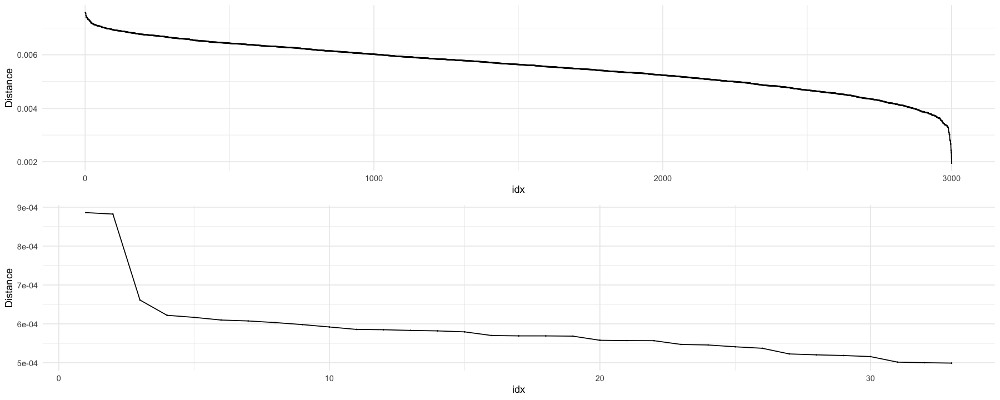

In [529]:
do.call("grid.arrange", c(GSE19830_lo2_flt_dist$plotDistances(), ncol = 1))

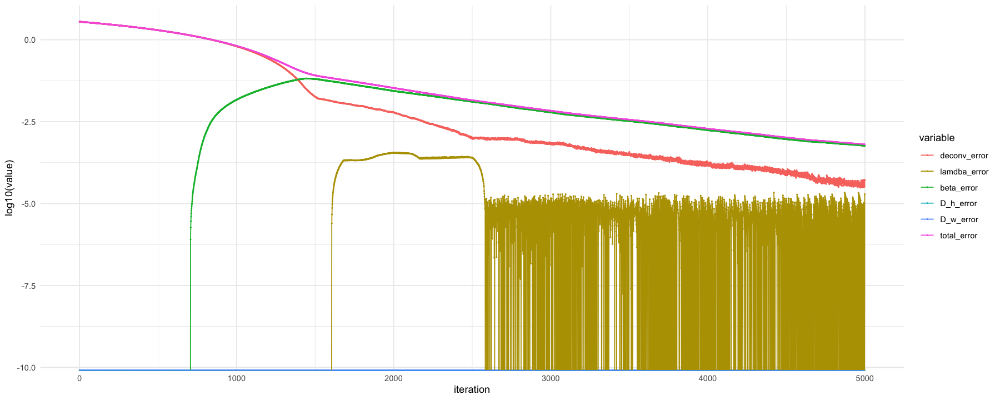

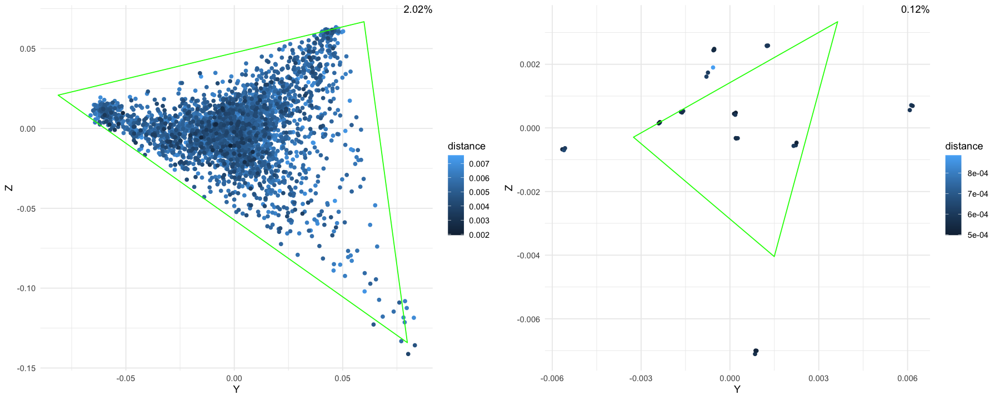

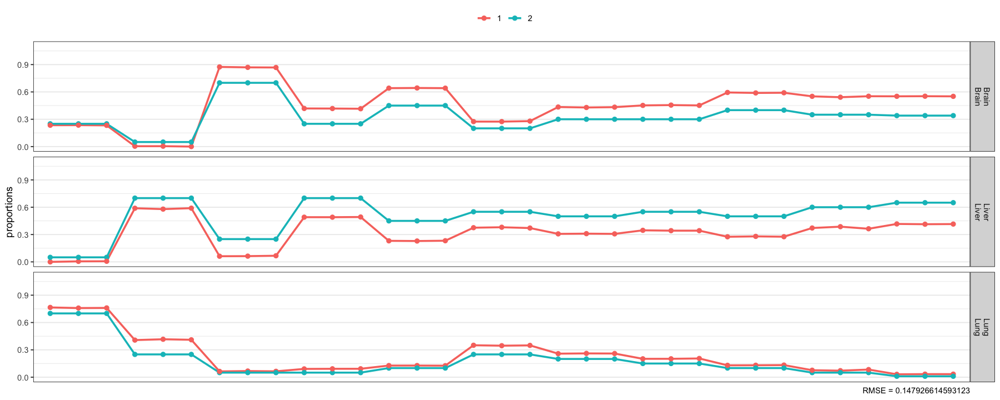

In [530]:
run_block(GSE19830_lo2_flt_dist, coef(GSE19830.mix), iterations = 5000, startWithInit = F)

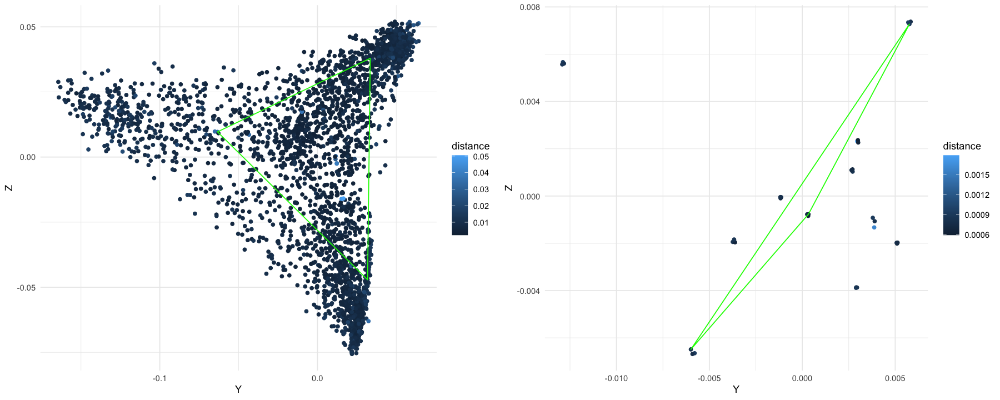

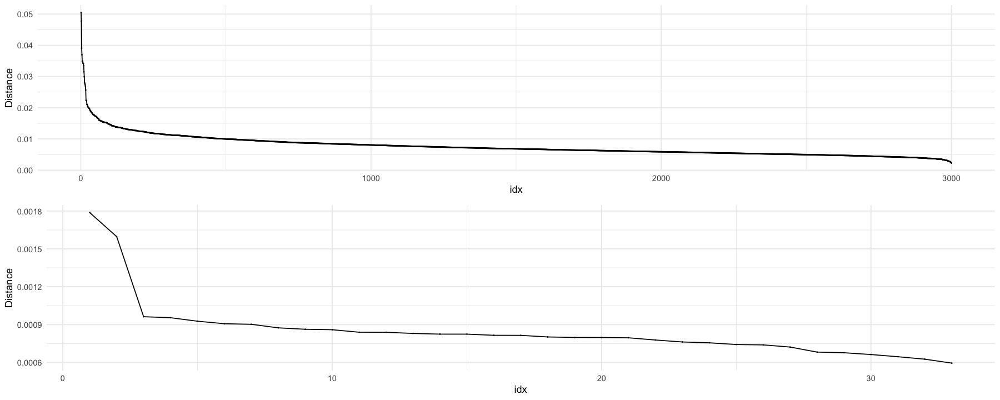

In [531]:
GSE19830_lo2_top_mad <- init_lo2(GSE19830.data, 3000)

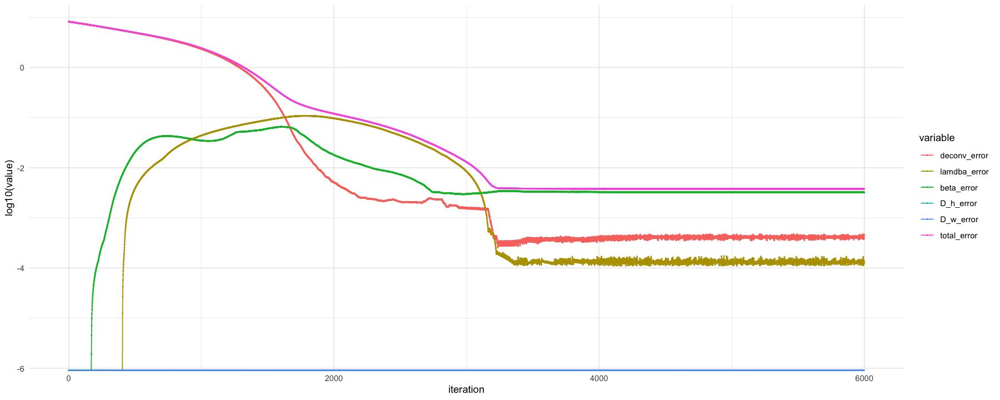

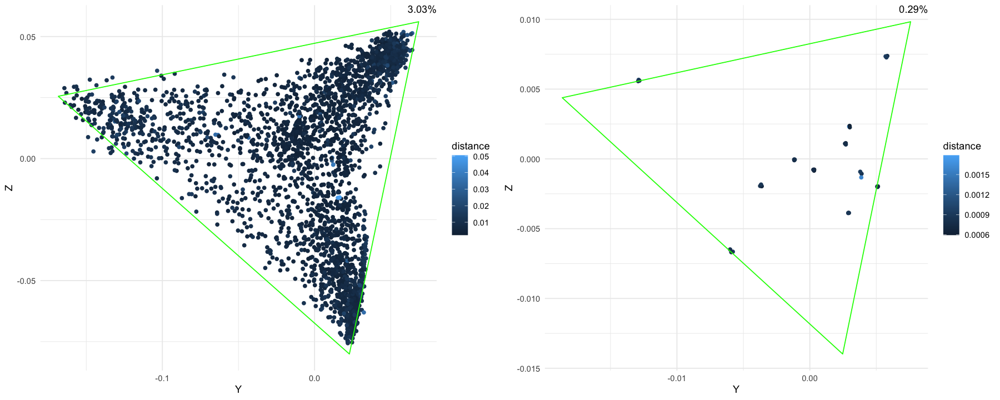

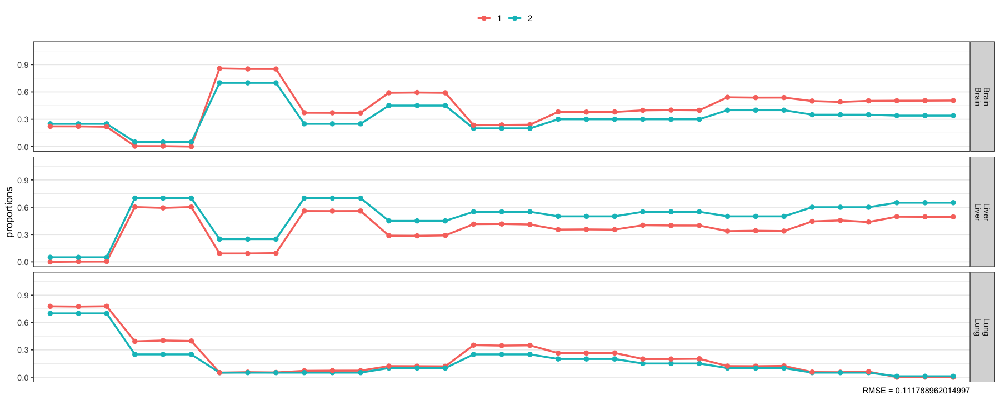

In [532]:
run_block(GSE19830_lo2_top_mad, coef(GSE19830.mix), iterations = 6000, startWithInit = T)

### Distance distribution

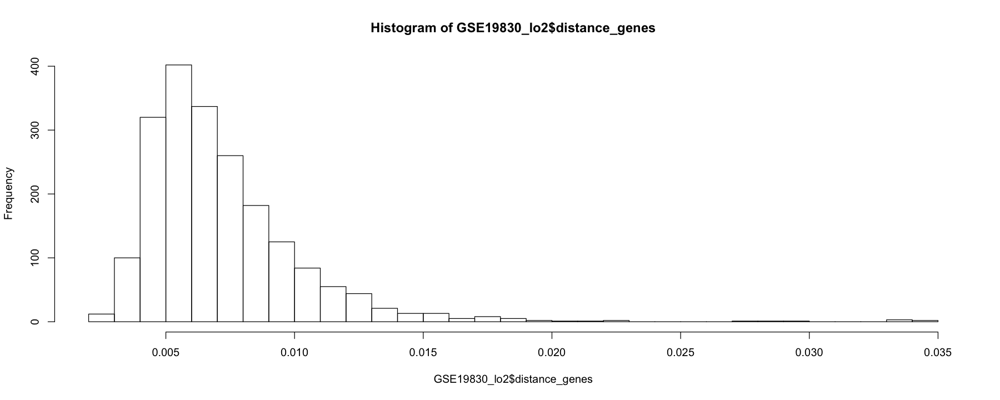

In [533]:
hist(GSE19830_lo2$distance_genes, breaks=40)

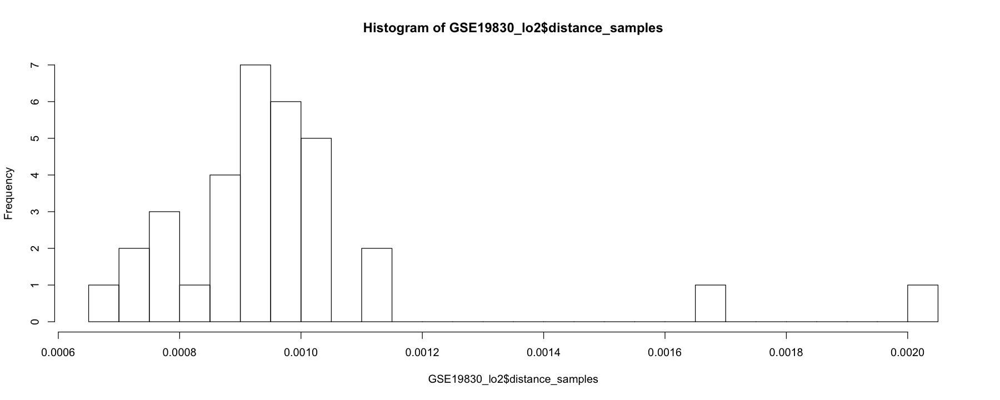

In [534]:
hist(GSE19830_lo2$distance_samples, breaks=20)

# 06 Jul 2022

## GSE19830

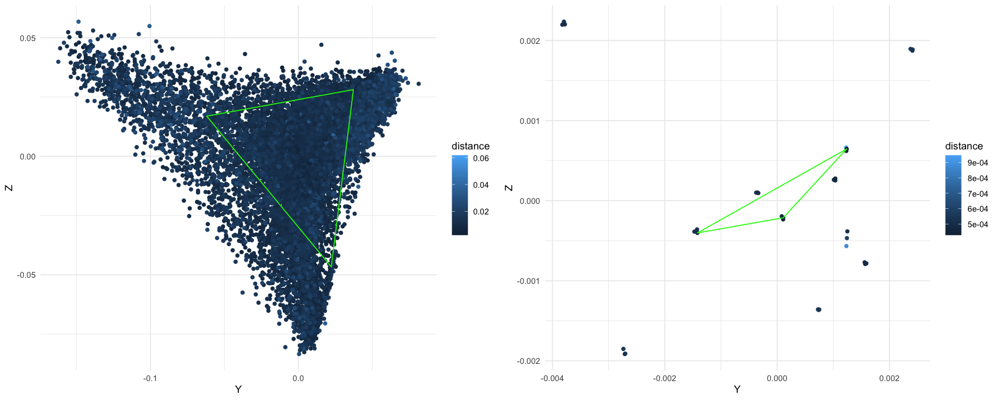

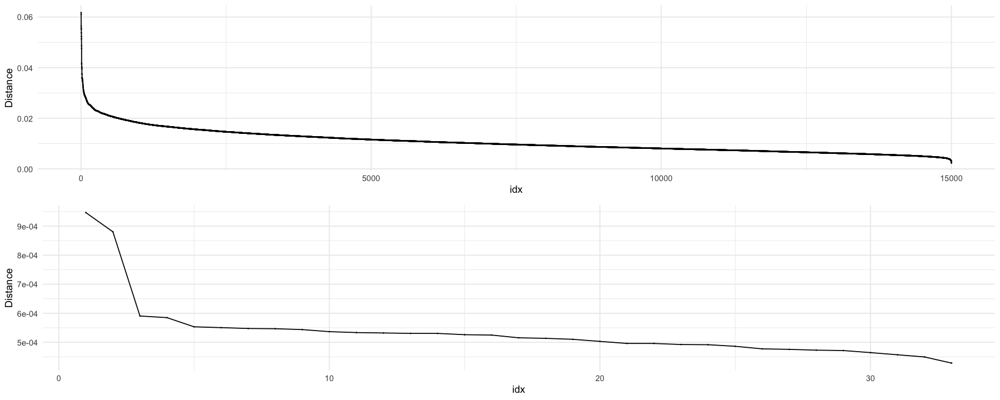

In [535]:
GSE19830_lo2 <- init_lo2(GSE19830.data, 15000)

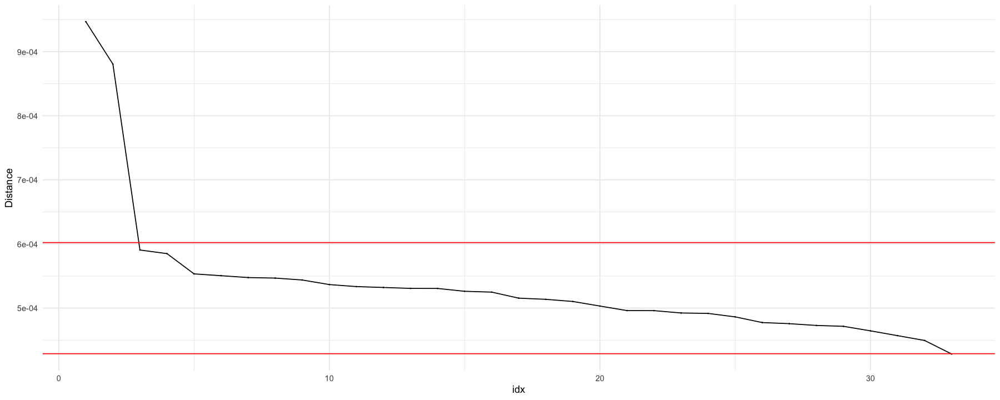

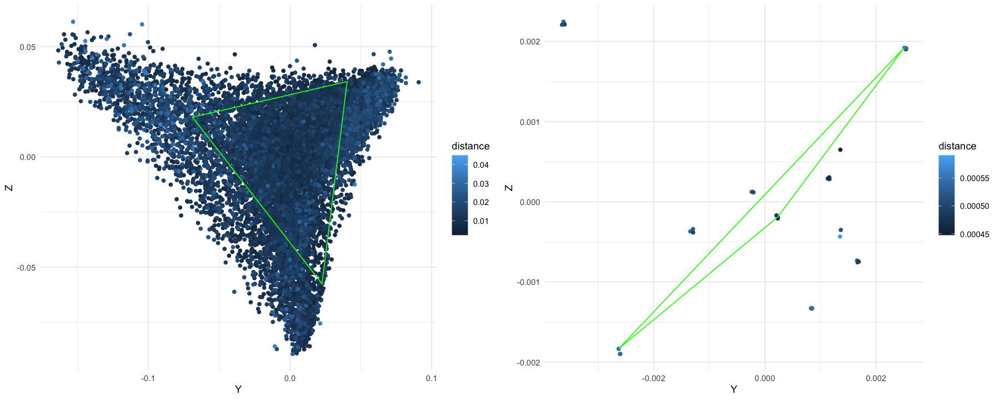

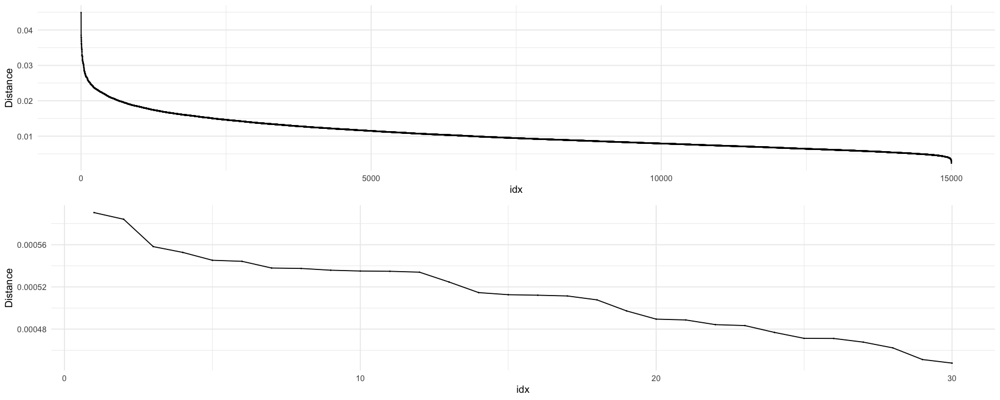

In [536]:
samples_flt1 <- mad_cutoff(GSE19830_lo2, samples = T)
GSE19830_data_flt1 <- GSE19830.data[, colnames(GSE19830.data) %in% samples_flt1]
GSE19830_lo2_flt1 <- init_lo2(GSE19830_data_flt1, 15000)

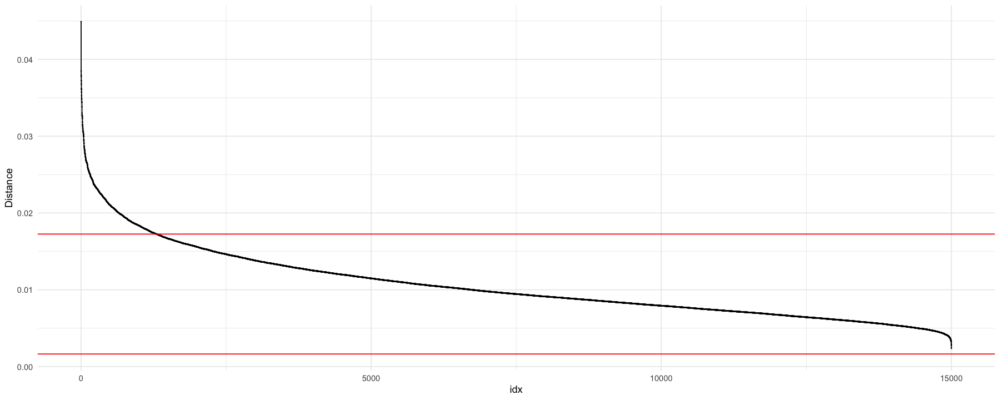

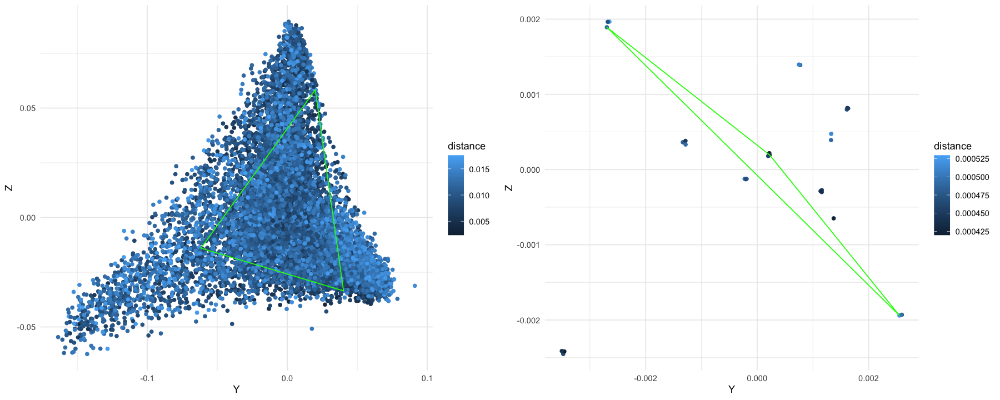

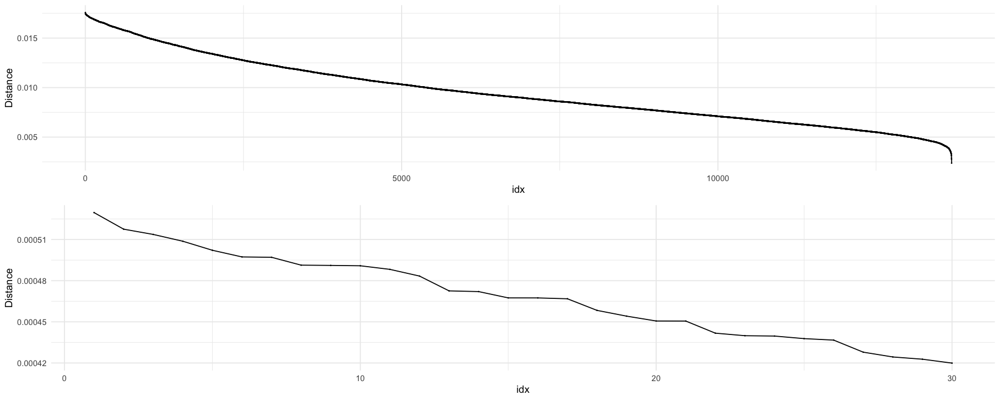

In [537]:
genes_flt2 <- mad_cutoff(GSE19830_lo2_flt1, samples = F)
GSE19830_data_flt2 <- GSE19830_data_flt1[rownames(GSE19830_data_flt1) %in% genes_flt2,]
GSE19830_lo2_flt2 <- init_lo2(GSE19830_data_flt2, nrow(GSE19830_data_flt2))

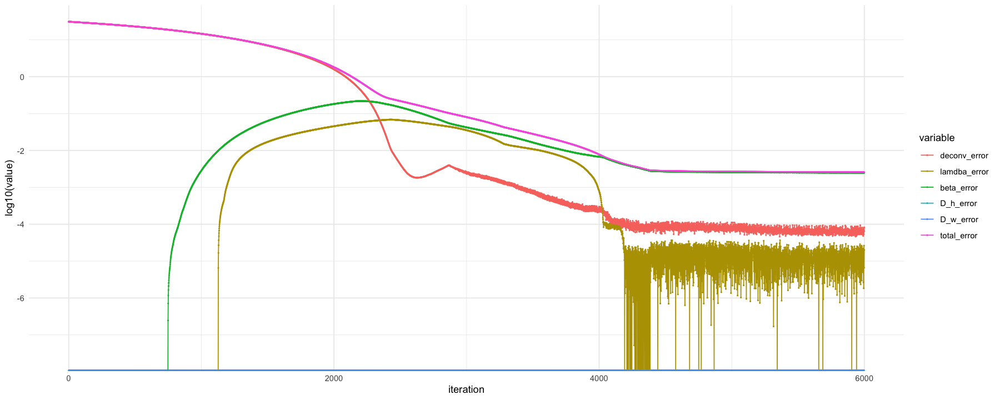

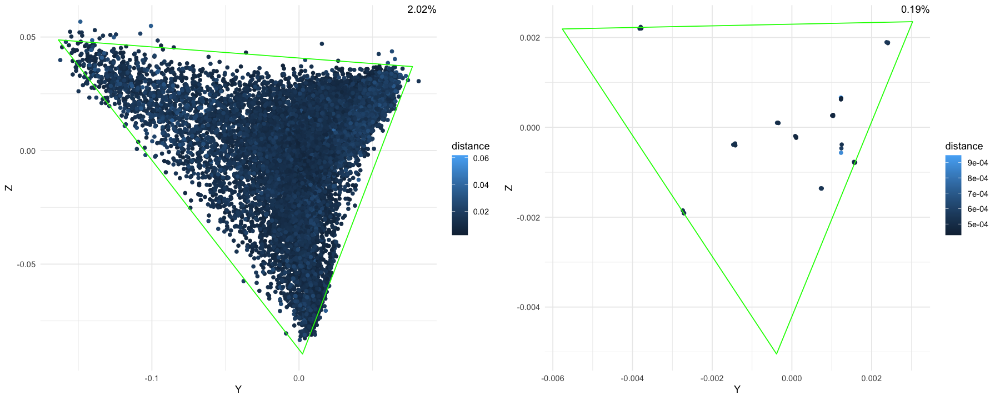

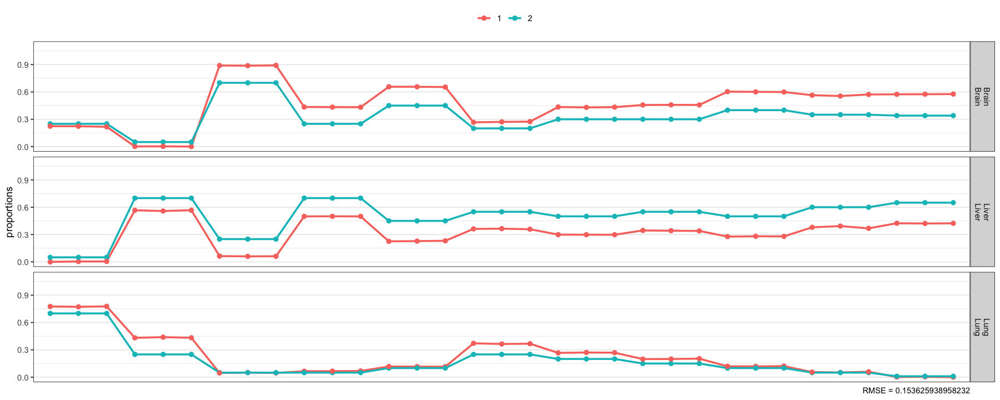

In [538]:
run_block(GSE19830_lo2, coef(GSE19830.mix), iterations = 6000, startWithInit = T)

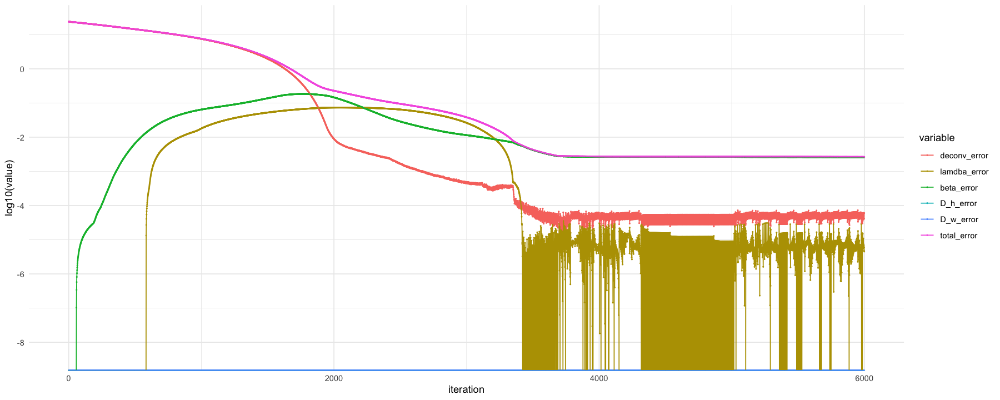

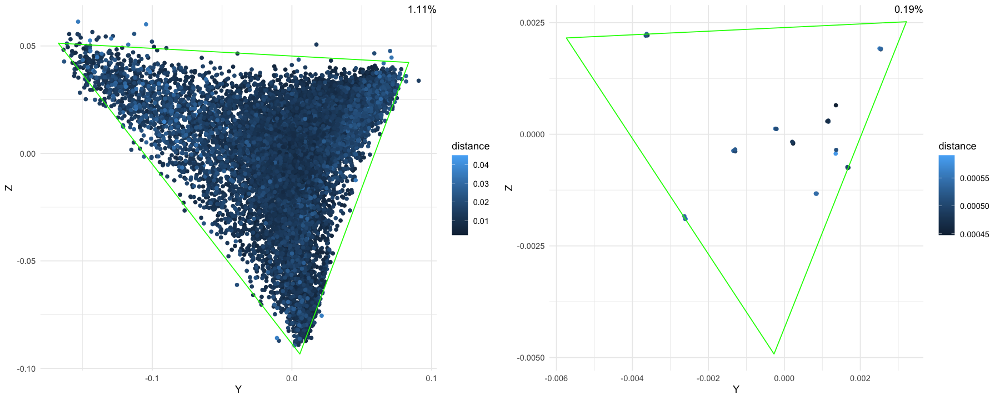

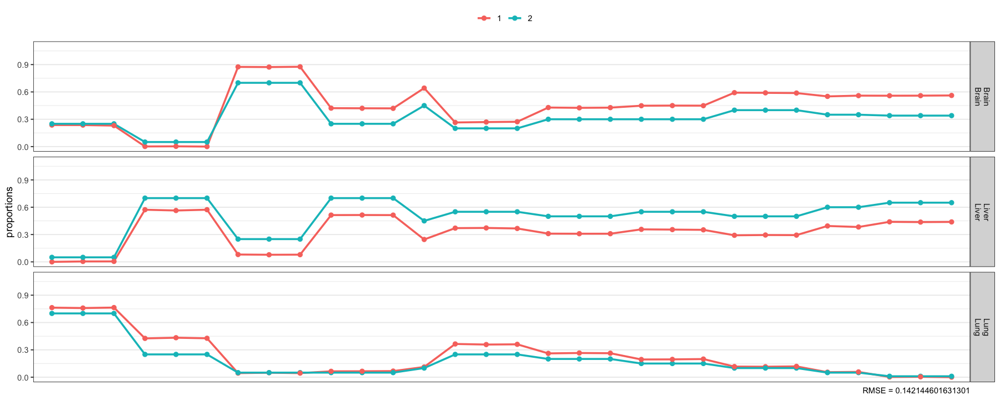

In [539]:
run_block(GSE19830_lo2_flt1, coef(GSE19830.mix)[, colnames(GSE19830_data_flt1)], iterations = 6000, startWithInit = T)

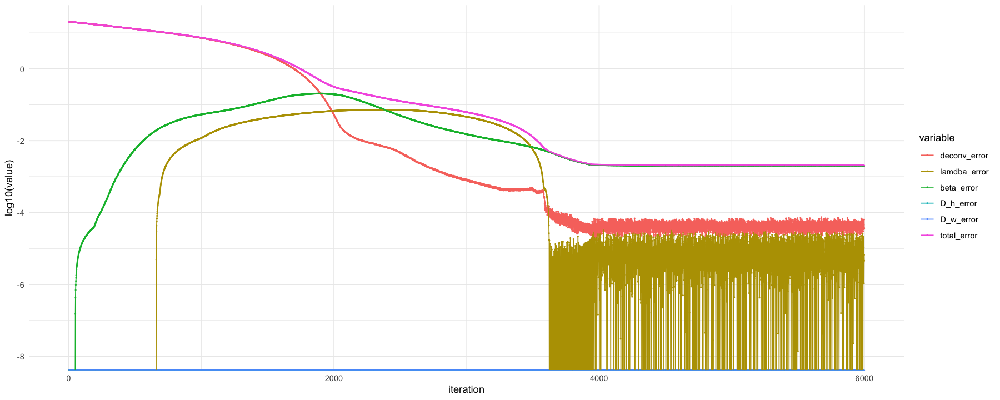

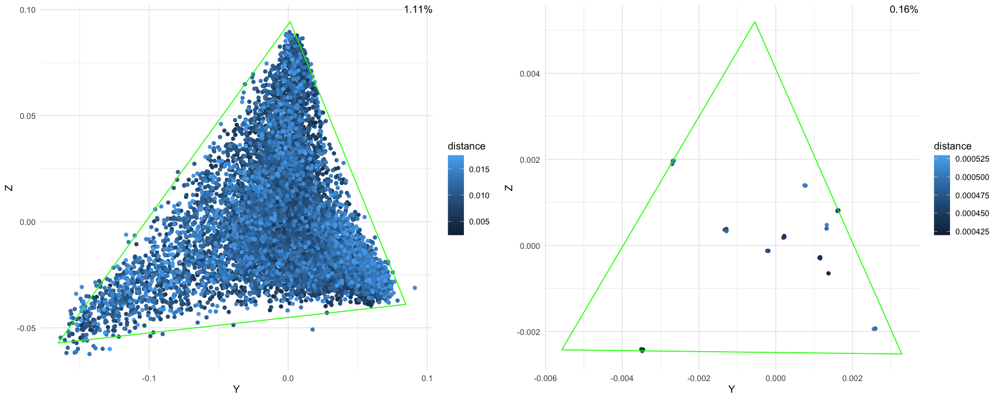

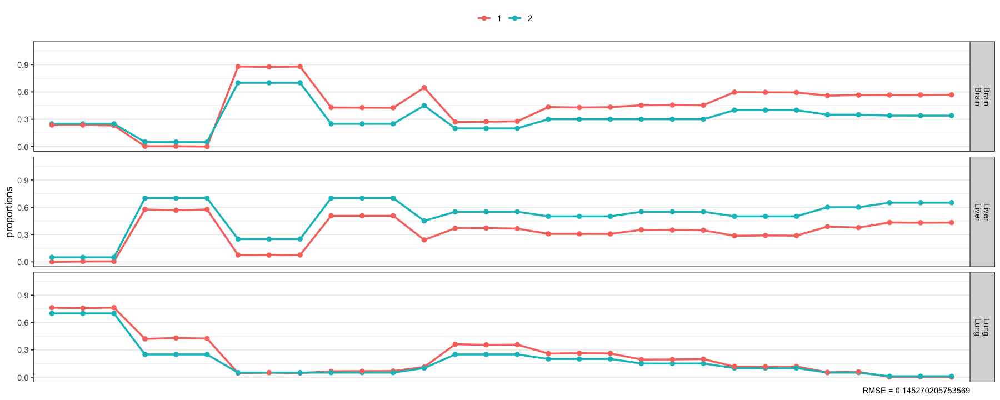

In [540]:
run_block(GSE19830_lo2_flt2, coef(GSE19830.mix)[, colnames(GSE19830_data_flt2)], iterations = 6000, startWithInit = T)

# Simulation

## Noise 3

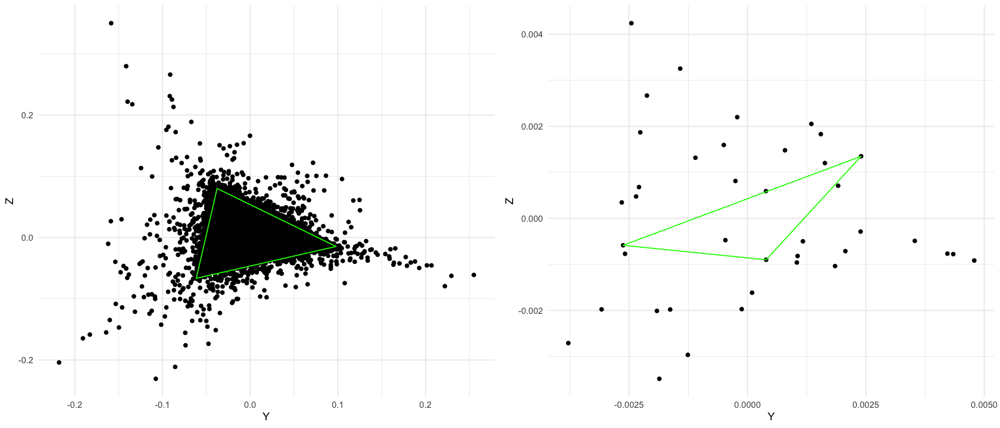

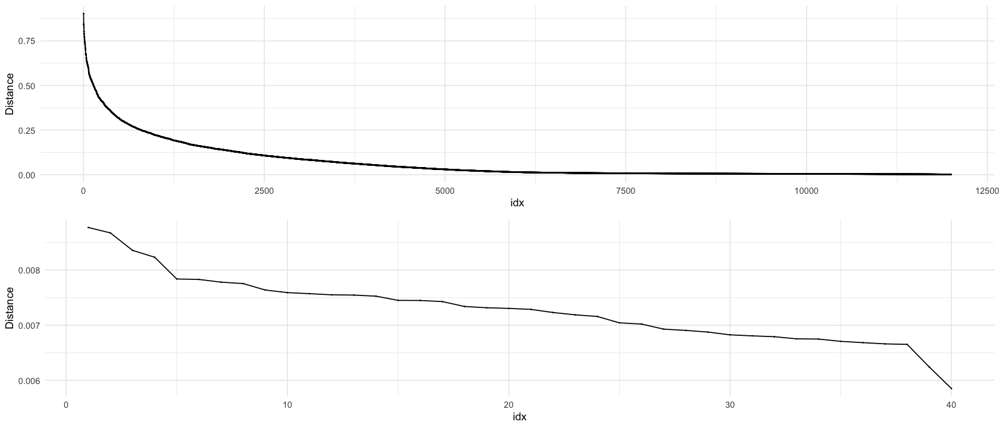

In [170]:
sim_3_lo2 <- init_lo2(sim_3$data, top_genes = 12000)

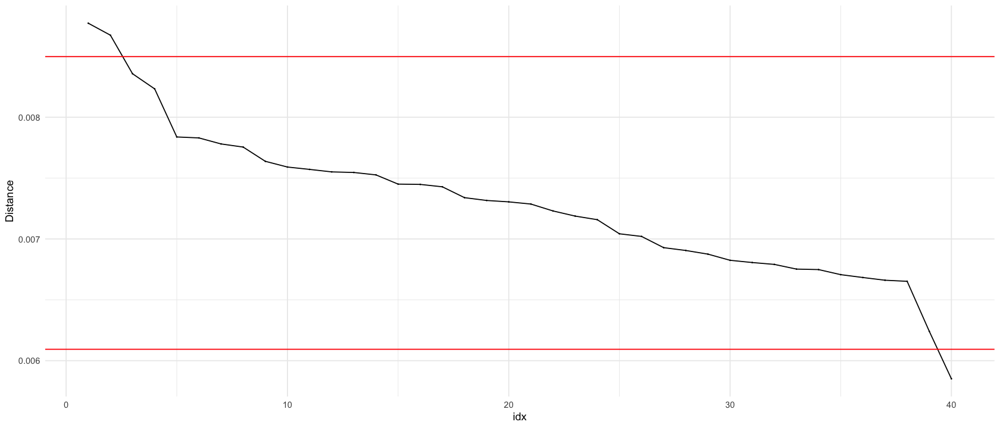

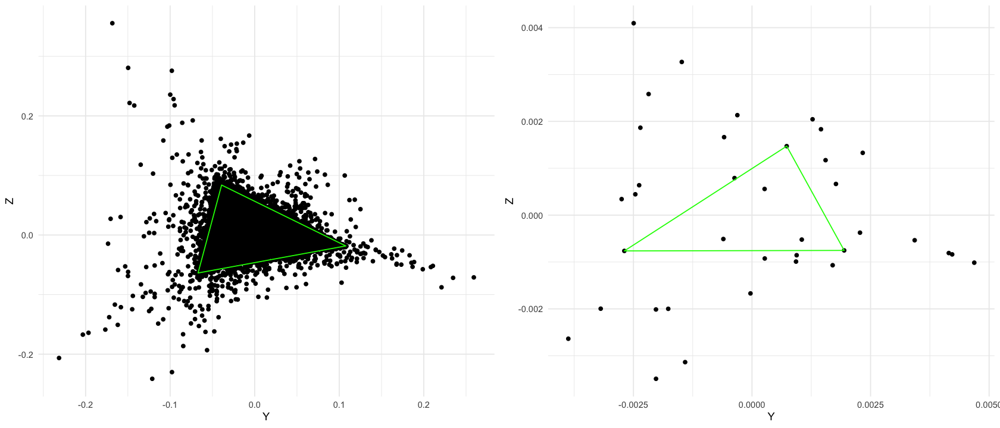

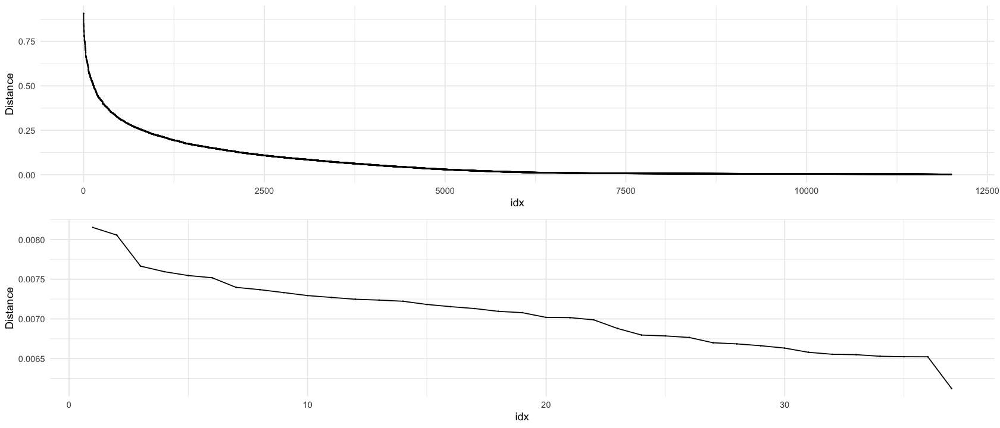

In [174]:
sim_3_samples_flt1 <- mad_cutoff(sim_3_lo2, samples = T)
sim_3_data_flt1 <- sim_3_data[, colnames(sim_3_data) %in% sim_3_samples_flt1]
sim_3_lo2_flt1 <- init_lo2(sim_3_data_flt1, 12000)

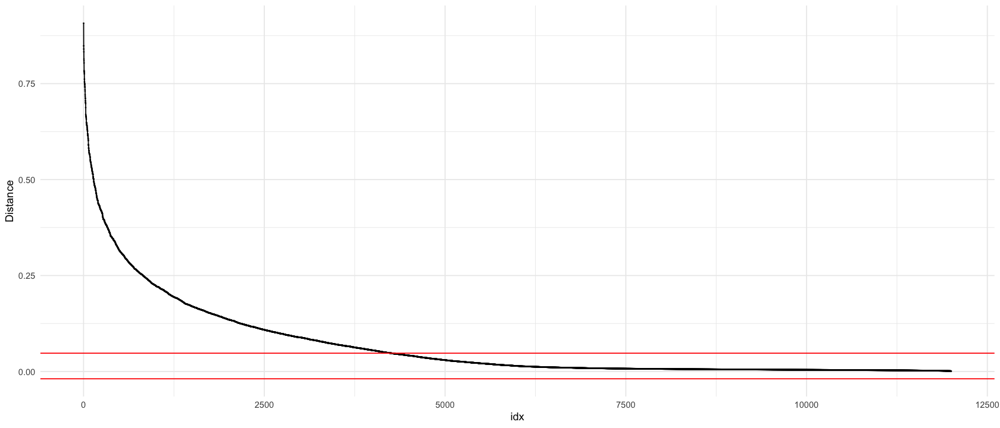

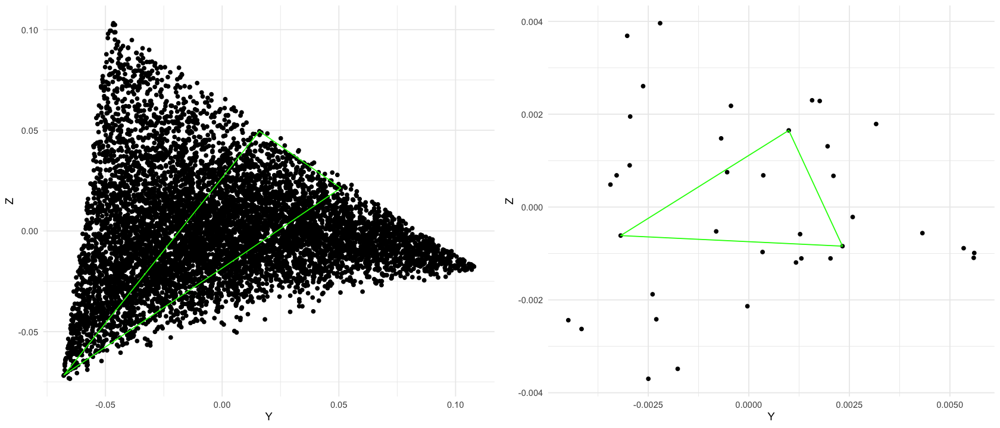

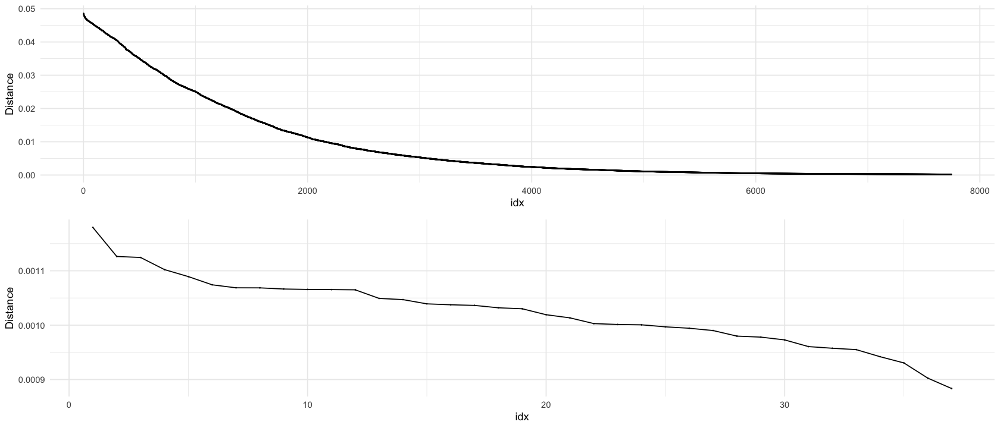

In [175]:
sim_3_genes_flt2 <- mad_cutoff(sim_3_lo2_flt1, samples = F)
sim_3_data_flt2 <- sim_3_data_flt1[rownames(sim_3_data_flt1) %in% sim_3_genes_flt2,]
sim_3_lo2_flt2 <- init_lo2(sim_3_data_flt2, nrow(sim_3_data_flt2))

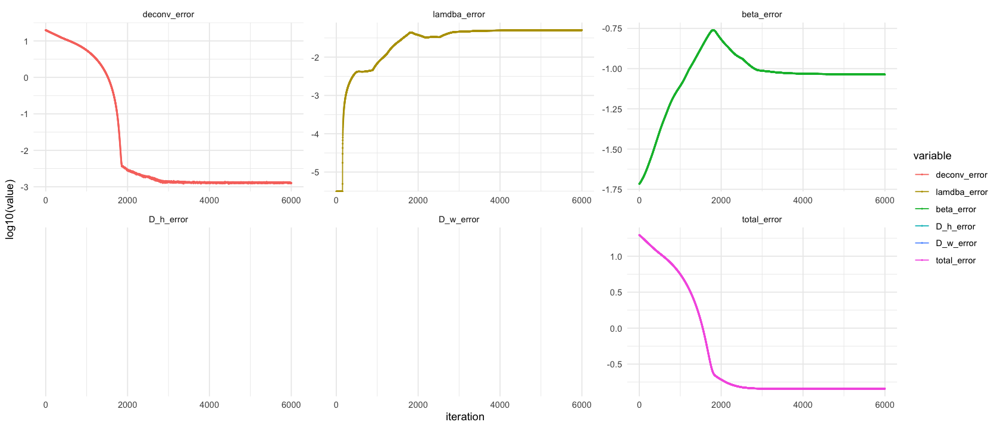

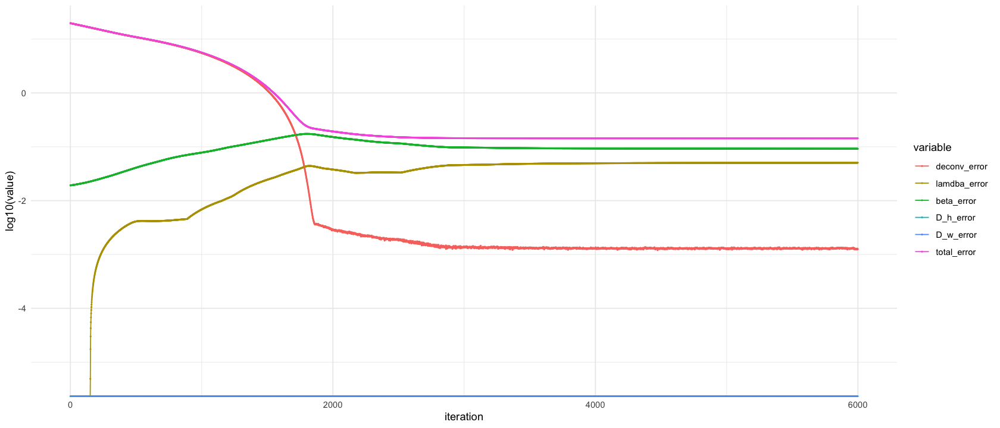

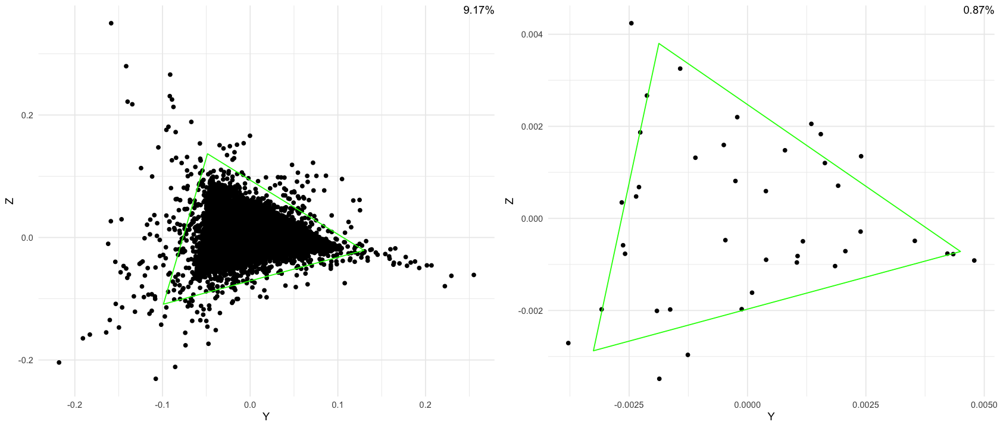

In [196]:
run_block(sim_3_lo2, iterations = 6000, startWithInit = T)

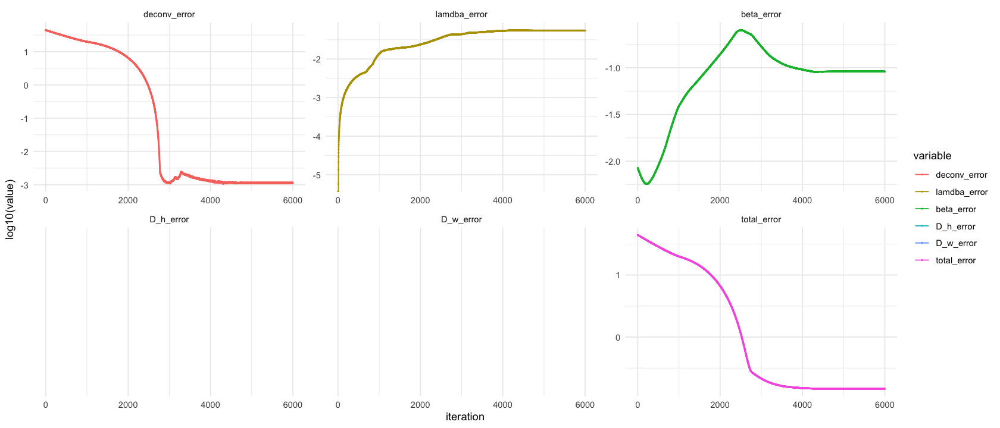

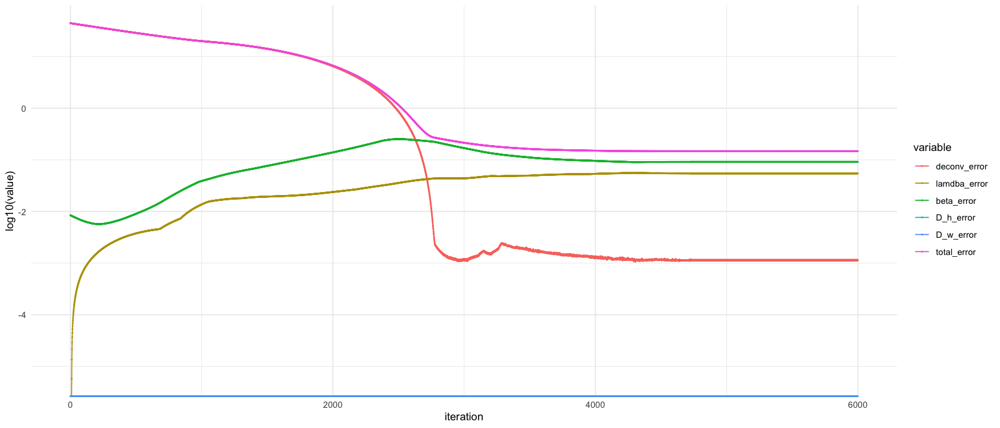

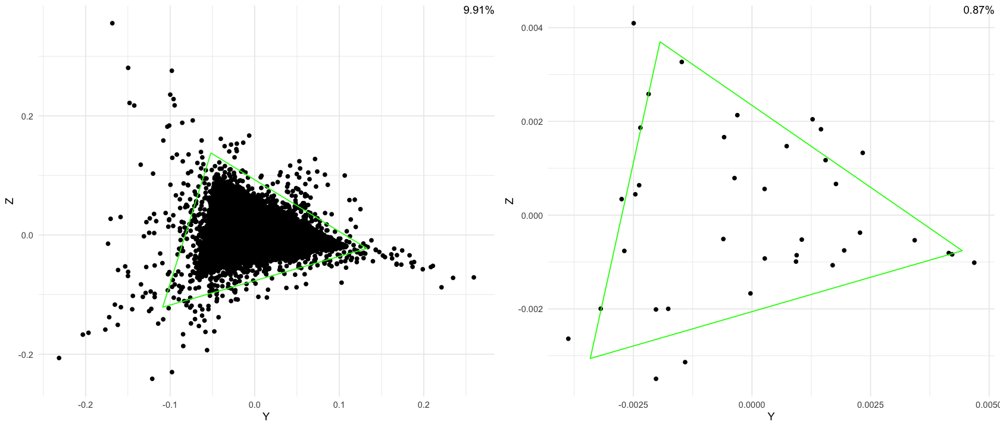

In [197]:
run_block(sim_3_lo2_flt1, iterations = 6000, startWithInit = T)

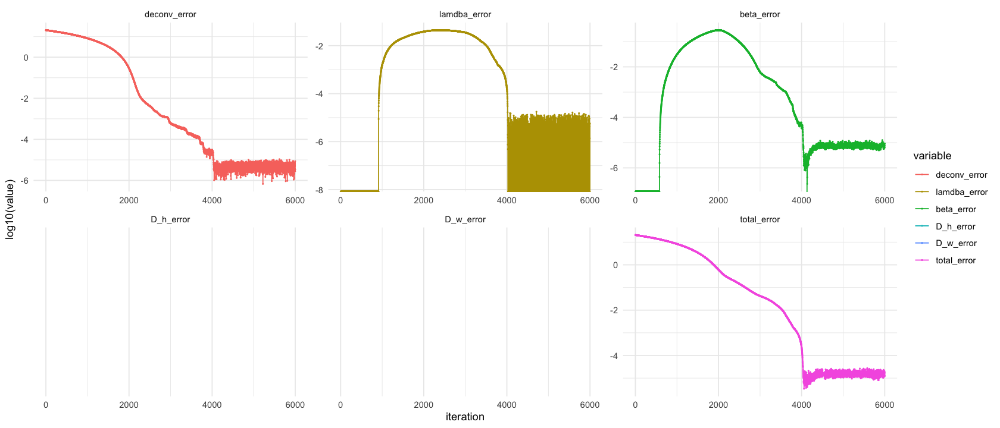

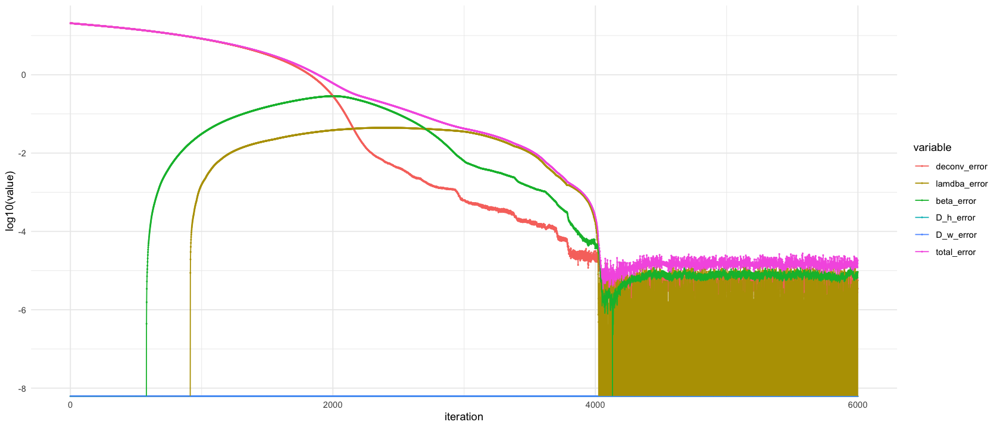

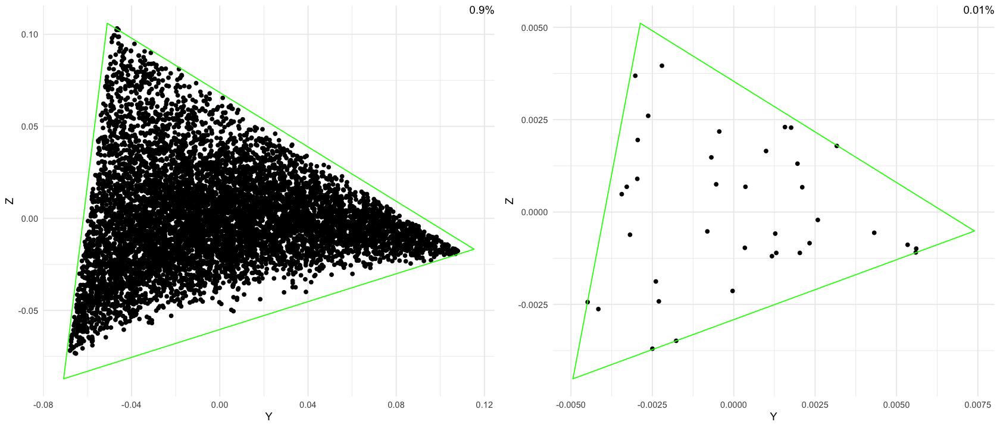

In [198]:
run_block(sim_3_lo2_flt2, iterations = 6000, startWithInit = T)

## Noise 5

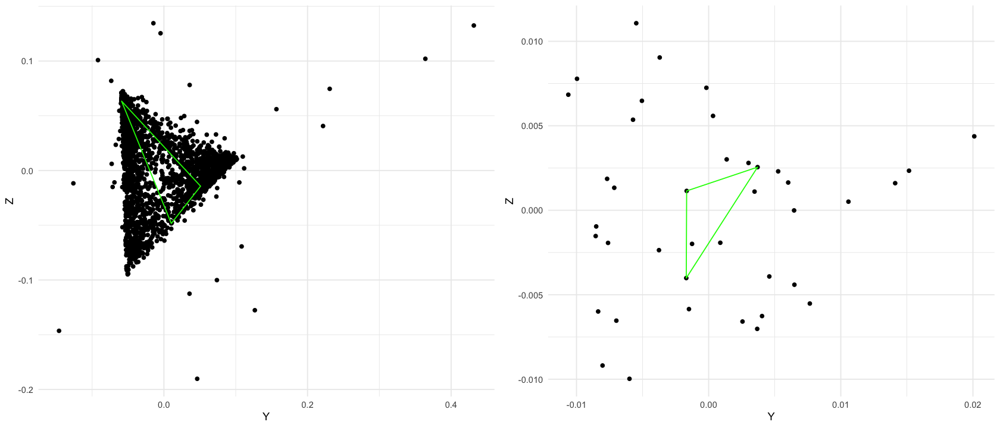

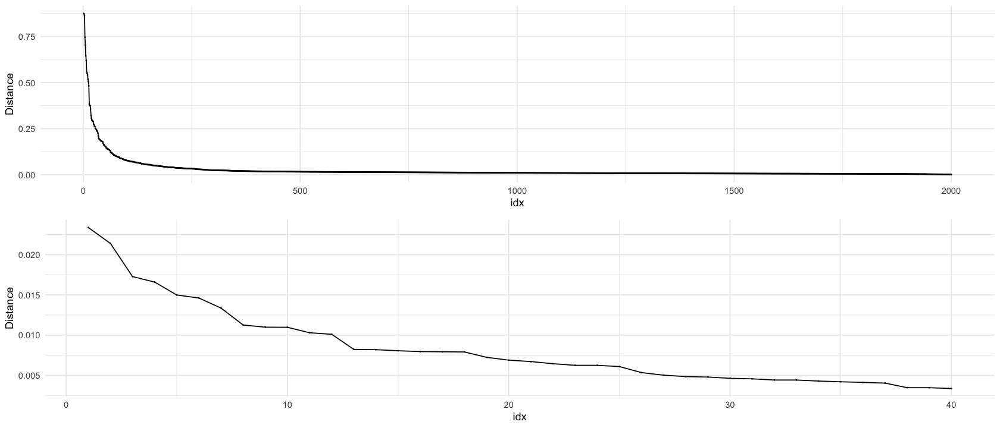

In [224]:
sim_5_lo2_2000 <- init_lo2(sim_5$data, top_genes = 2000)

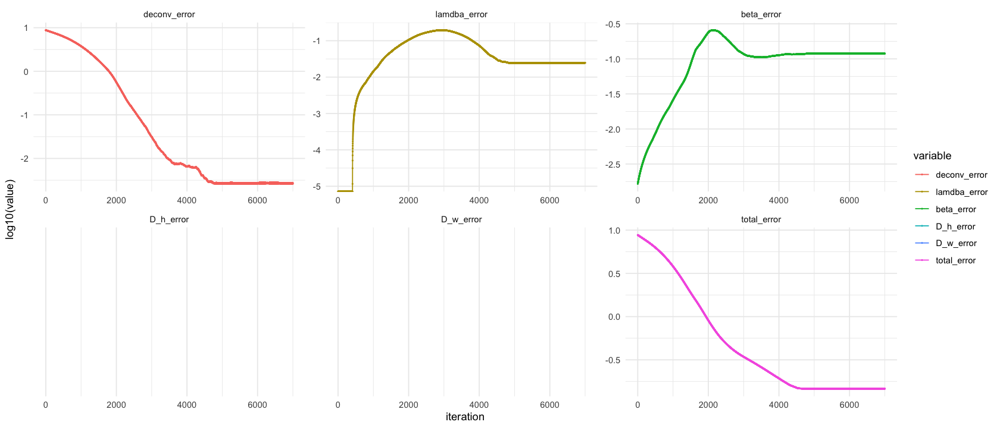

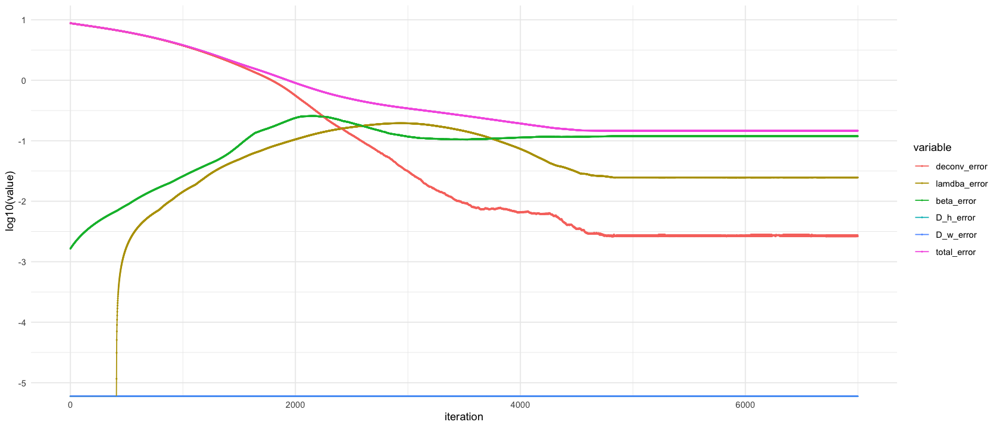

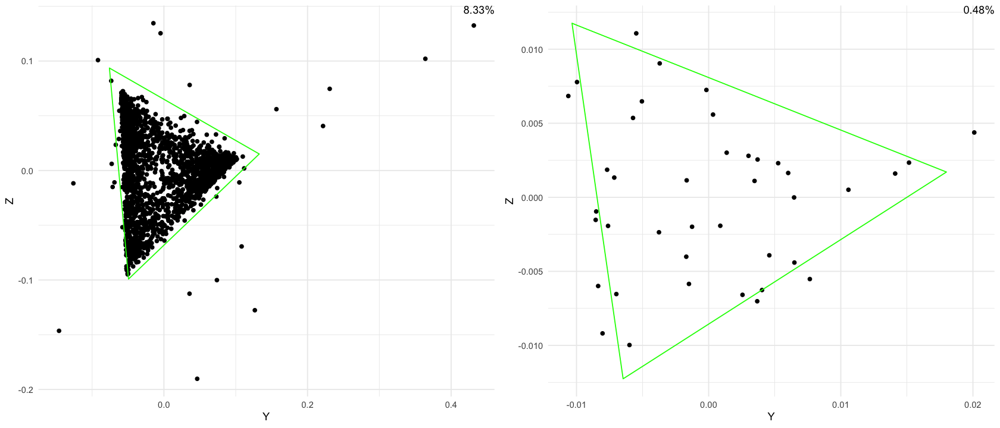

In [231]:
run_block(sim_5_lo2_2000, startWithInit = F)

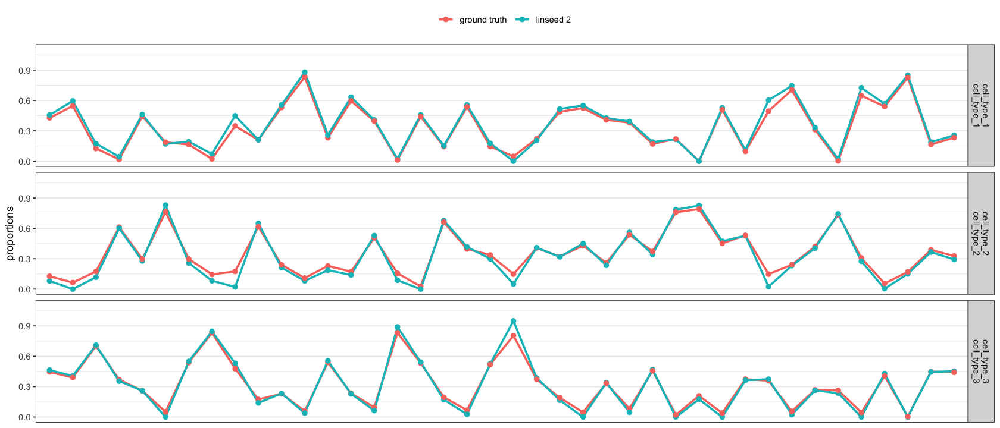

In [236]:
plotProps(sim_5_lo2_2000, sim_5)

In [235]:
plotProps <- function(lo2, sim) {
    tmp <- lo2$full_proportions
    pred_props <- tmp[guessOrder(tmp, sim$proportions),]
    colnames(pred_props) <- colnames(sim$proportions)
    rownames(pred_props) <- rownames(sim$proportions)
    show(plotProportions(sim$proportions, pred_props, pnames = c("ground truth", "linseed 2")))
}

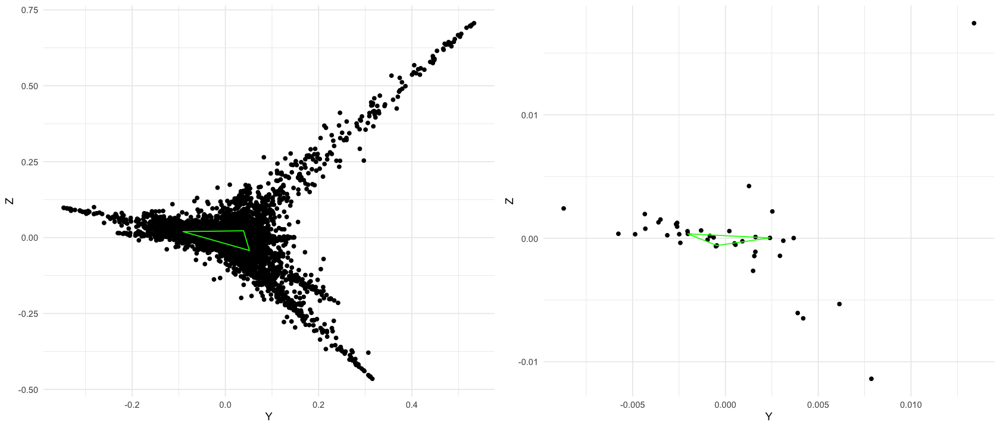

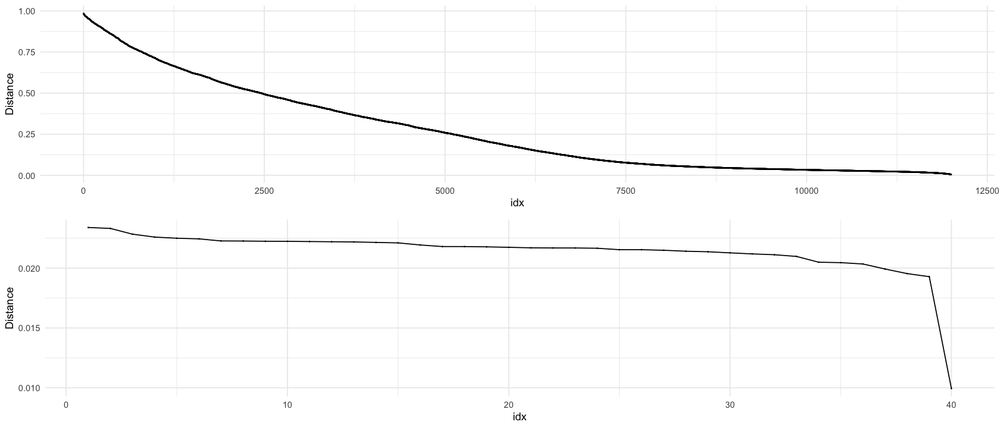

In [177]:
sim_5_lo2 <- init_lo2(sim_5$data, top_genes = 12000)

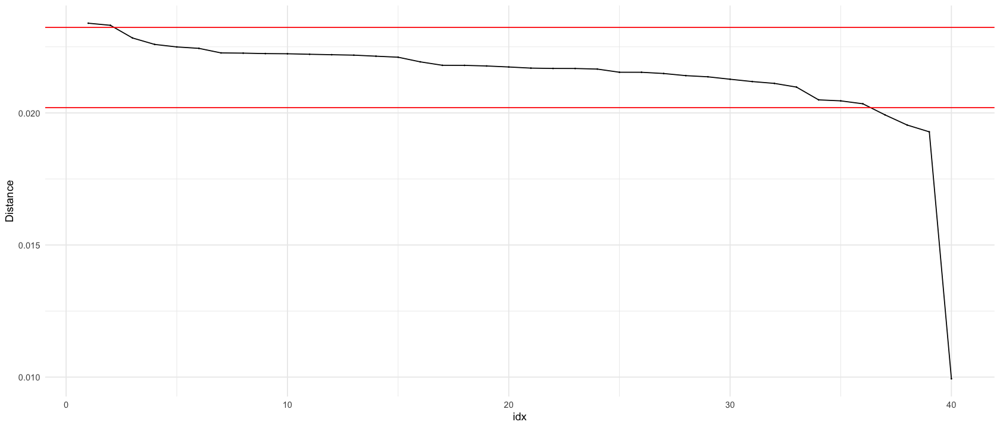

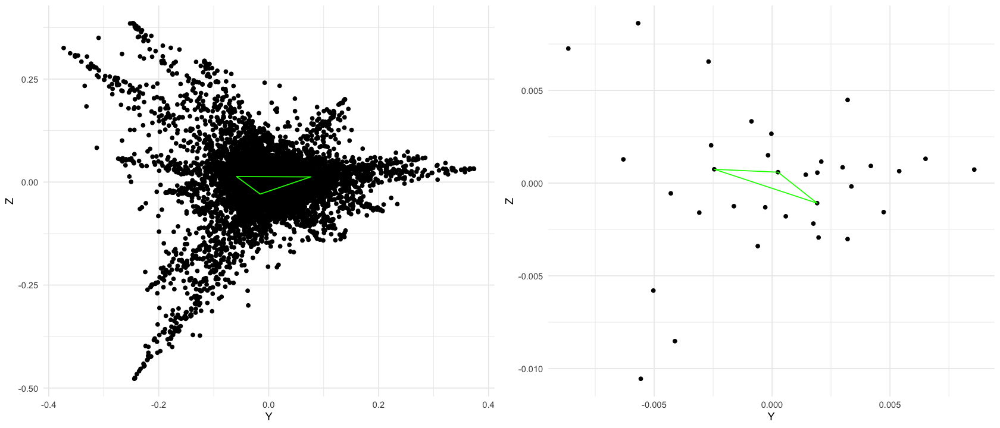

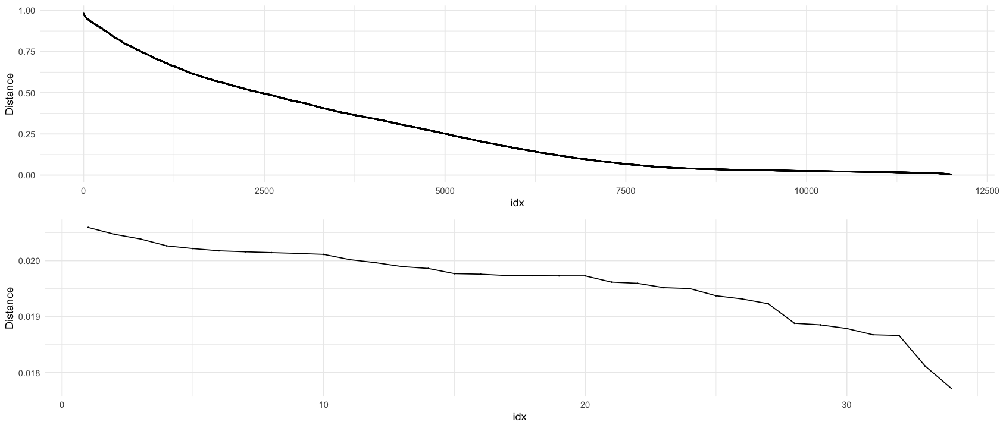

In [180]:
sim_5_samples_flt1 <- mad_cutoff(sim_5_lo2, samples = T)
sim_5_data_flt1 <- sim_5_data[, colnames(sim_5_data) %in% sim_5_samples_flt1]
sim_5_lo2_flt1 <- init_lo2(sim_5_data_flt1, 12000)

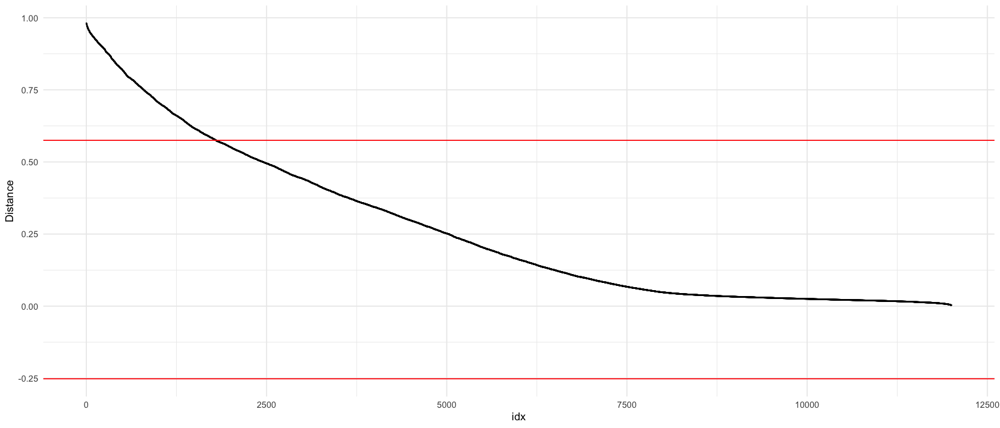

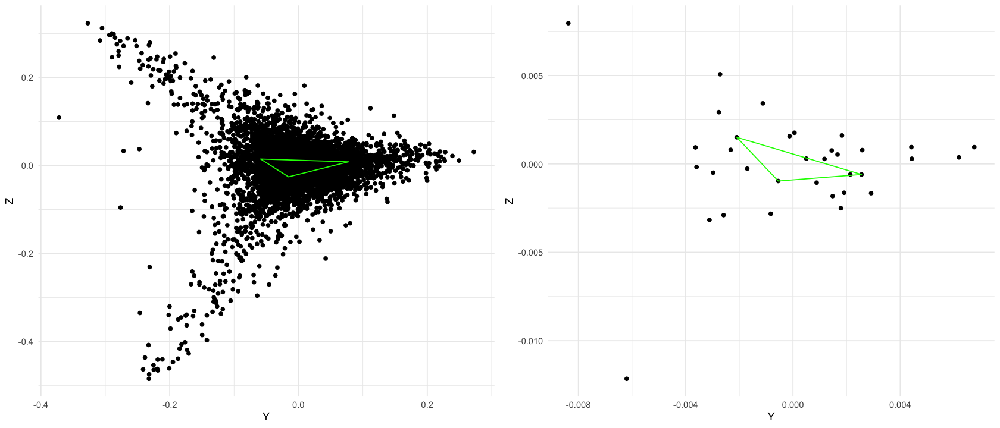

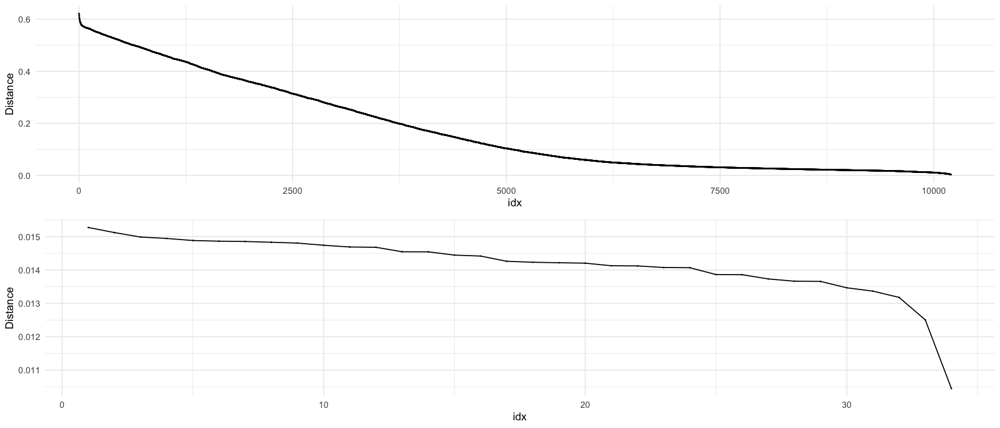

In [192]:
sim_5_genes_flt2 <- mad_cutoff(sim_5_lo2_flt1, samples = F)
sim_5_data_flt2 <- sim_5_data_flt1[rownames(sim_5_data_flt1) %in% sim_5_genes_flt2,]
sim_5_lo2_flt2 <- init_lo2(sim_5_data_flt2, nrow(sim_5_data_flt2))

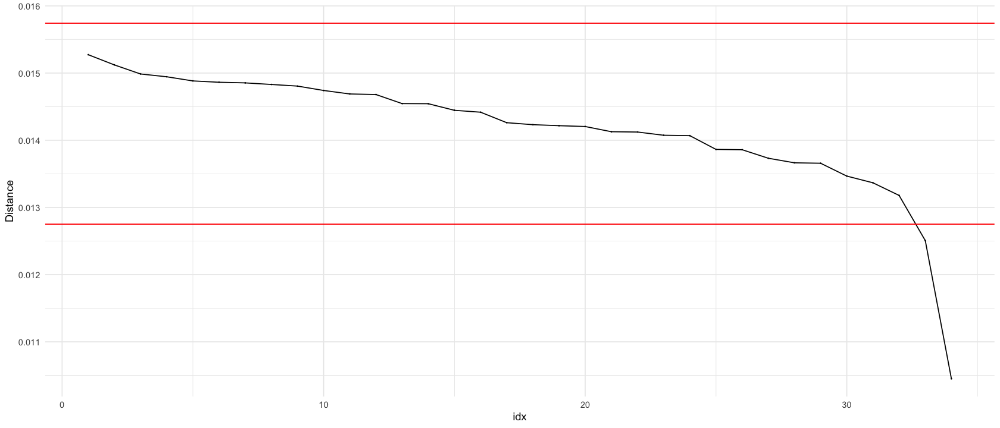

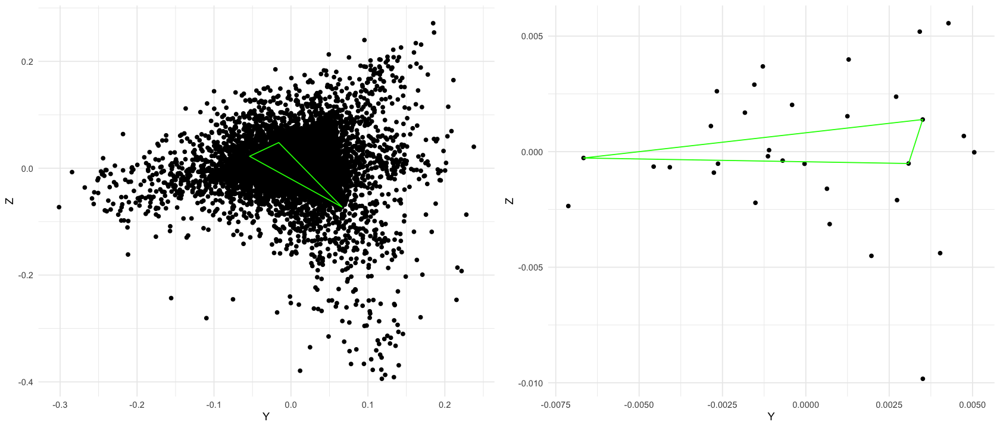

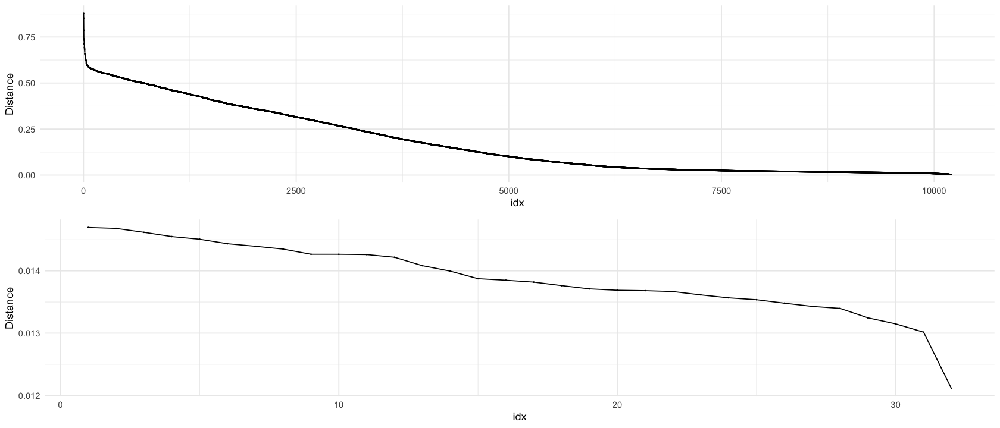

In [193]:
sim_5_samples_flt3 <- mad_cutoff(sim_5_lo2_flt2, samples = T)
sim_5_data_flt3 <- sim_5_data_flt2[, colnames(sim_5_data_flt2) %in% sim_5_samples_flt3]
sim_5_lo2_flt3 <- init_lo2(sim_5_data_flt3, nrow(sim_5_data_flt3))

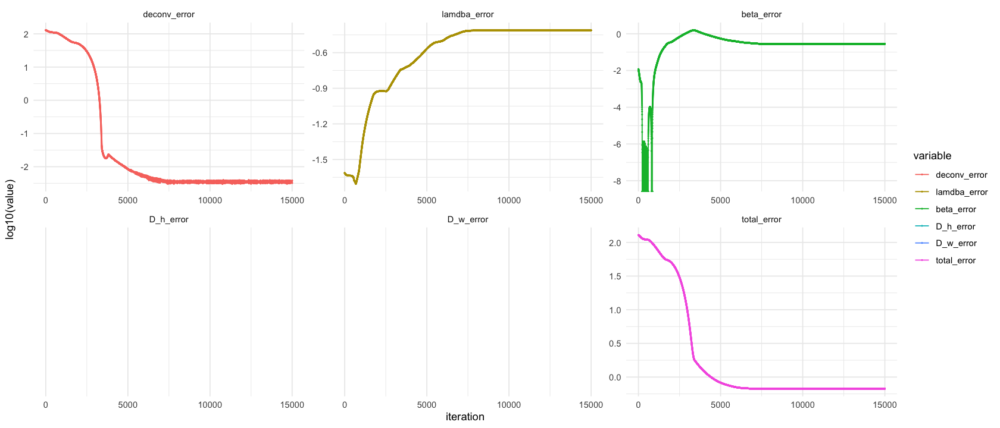

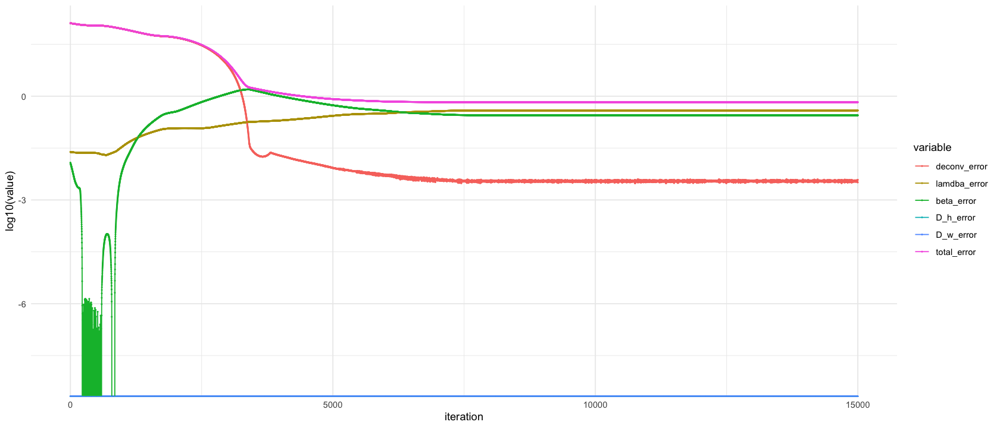

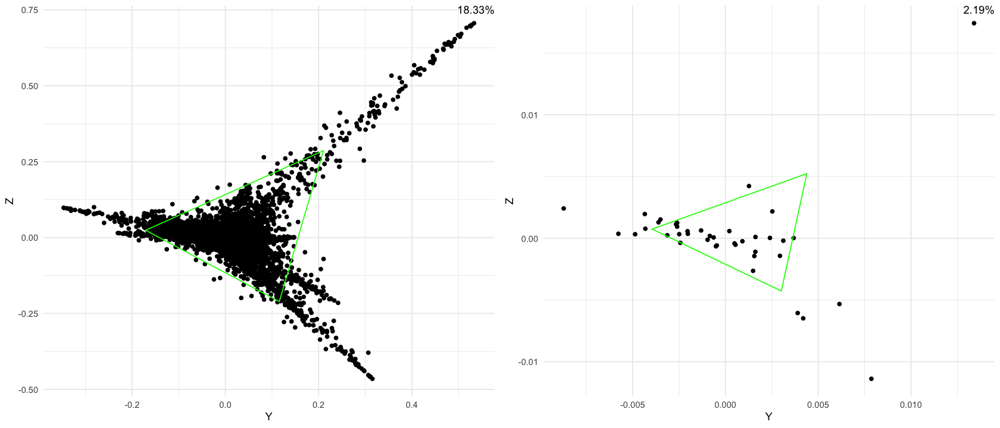

In [211]:
run_block(sim_5_lo2, iterations = 15000, startWithInit = T)

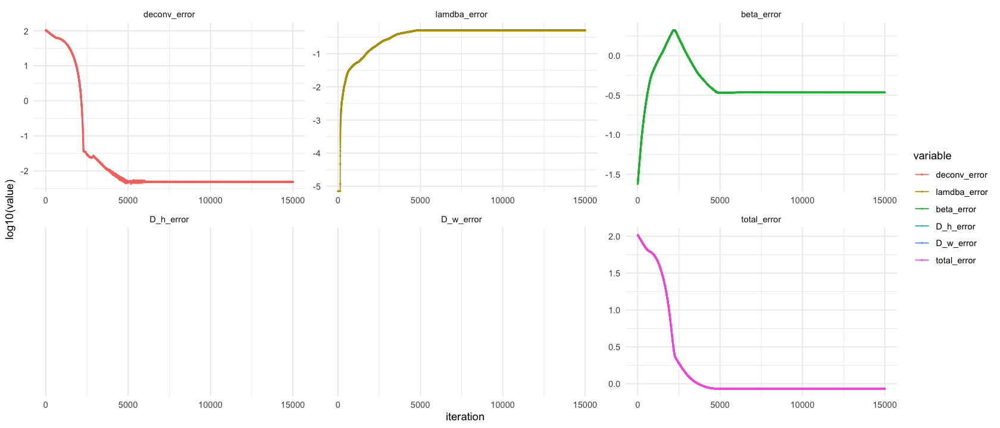

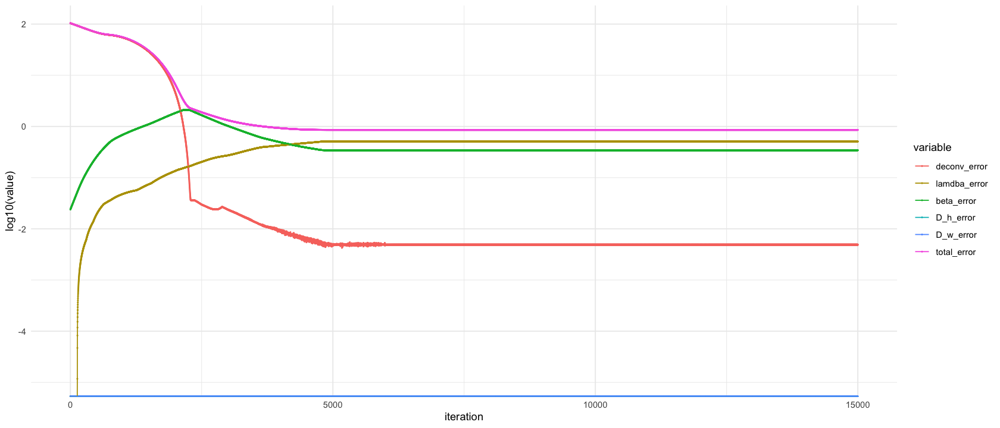

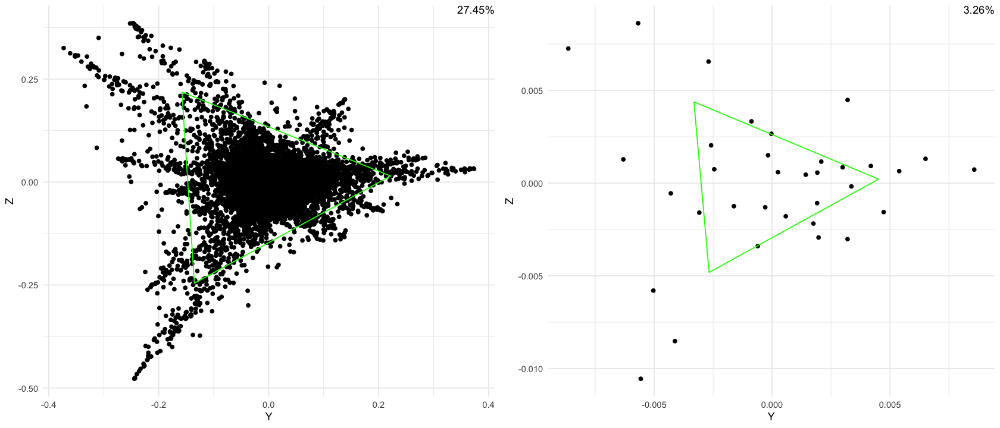

In [212]:
run_block(sim_5_lo2_flt1, iterations = 15000, startWithInit = T)

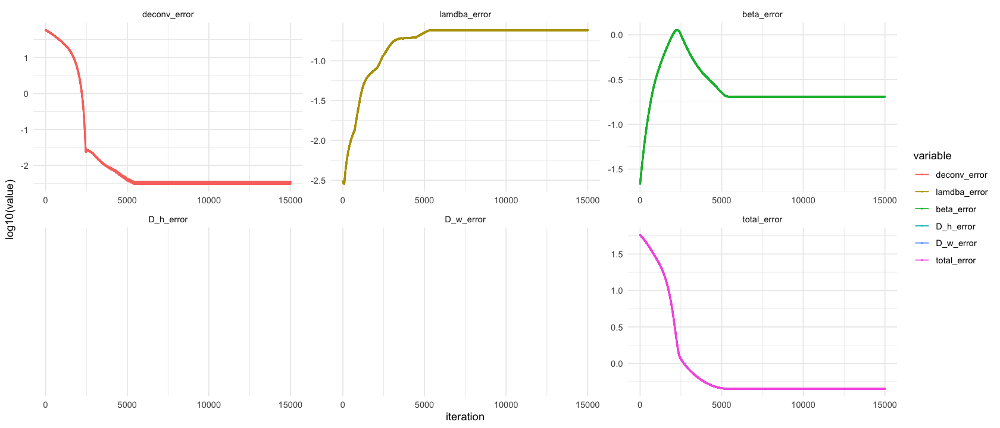

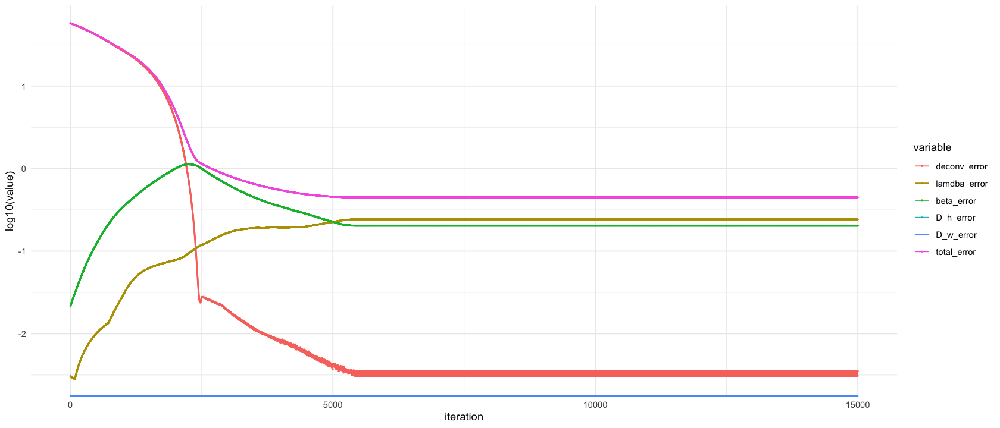

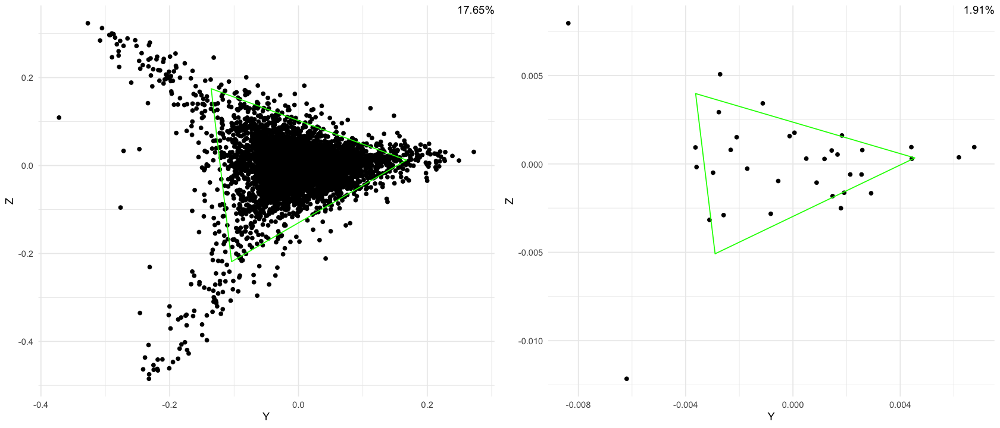

In [213]:
run_block(sim_5_lo2_flt2, iterations = 15000, startWithInit = T)

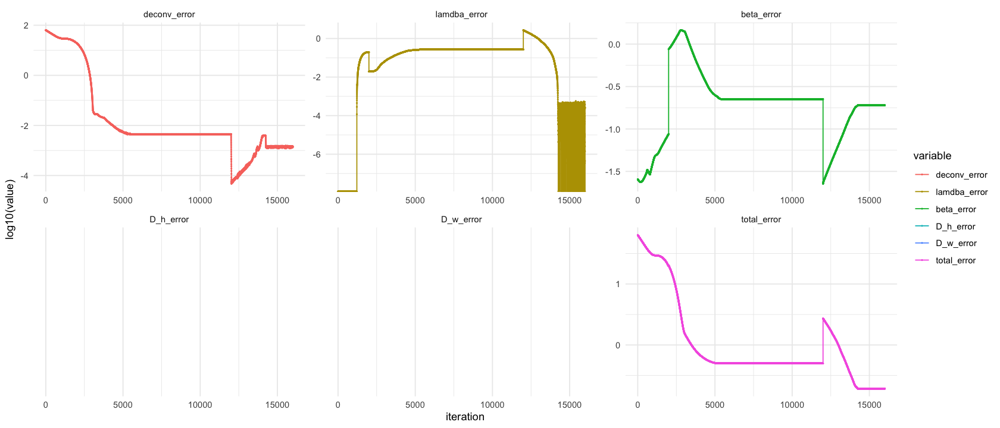

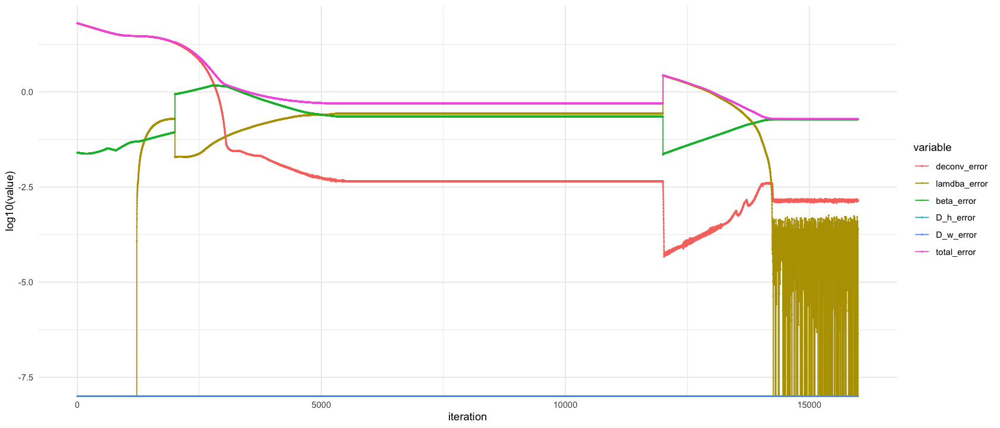

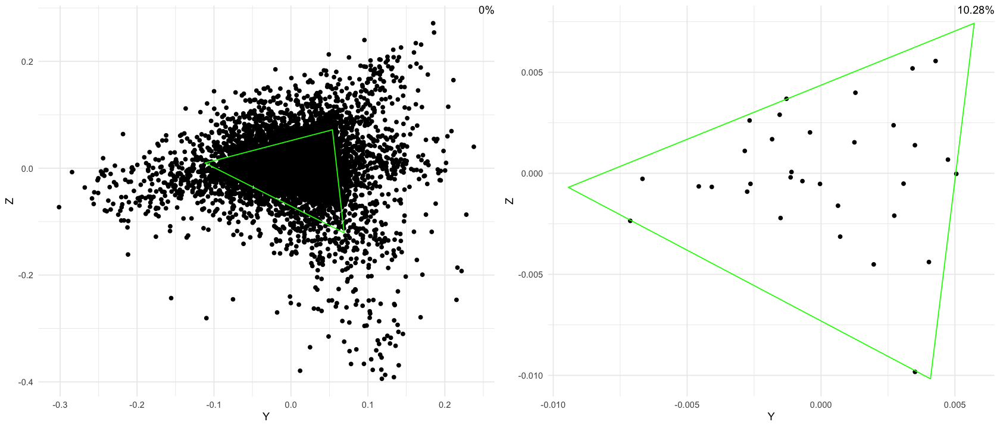

In [219]:
run_block(sim_5_lo2_flt3, iterations = 2000, startWithInit = F, coef_hinge_H = 10, coef_hinge_W = 1)

In [ ]:
tmp <- GSE19830.lo2$full_proportions
    GSE19830.props.lo2 <- tmp[guessOrder(tmp, GSE19830.props.true),]
    colnames(GSE19830.props.lo2) <- colnames(GSE19830.props.true)
    rownames(GSE19830.props.lo2) <- rownames(GSE19830.props.true)

## Noise 6.5

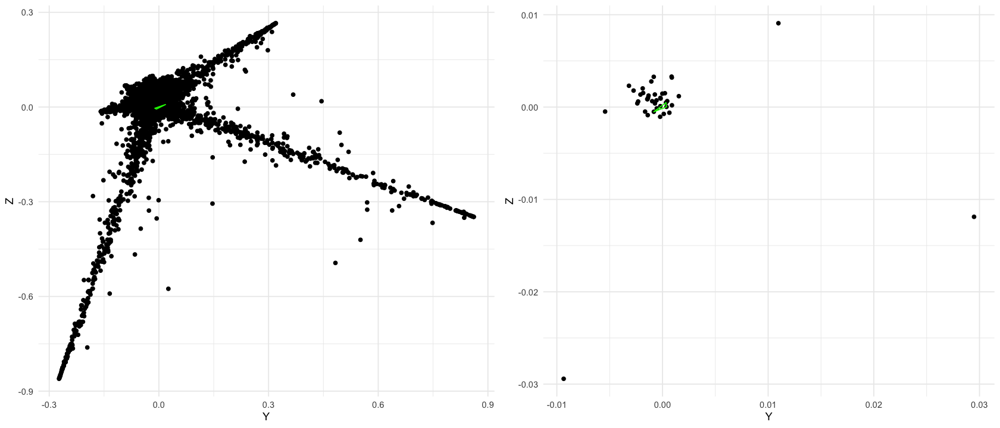

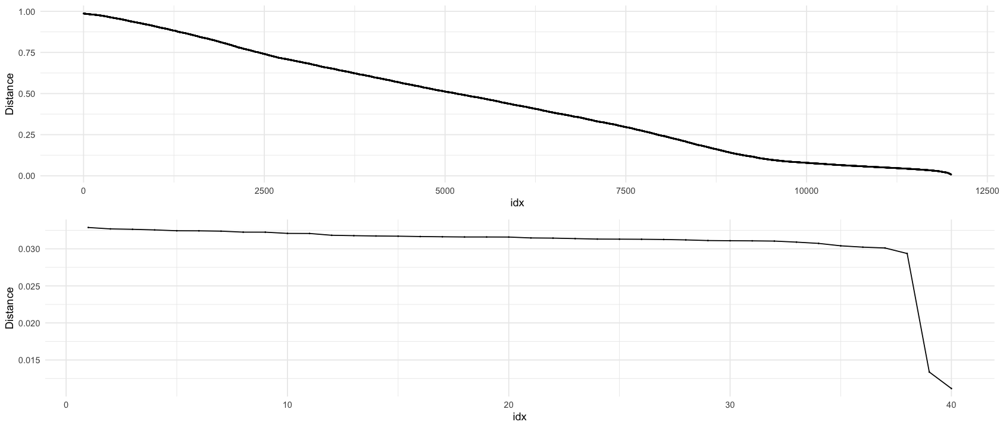

In [203]:
sim_65_lo2 <- init_lo2(sim_65$data, top_genes = 12000)

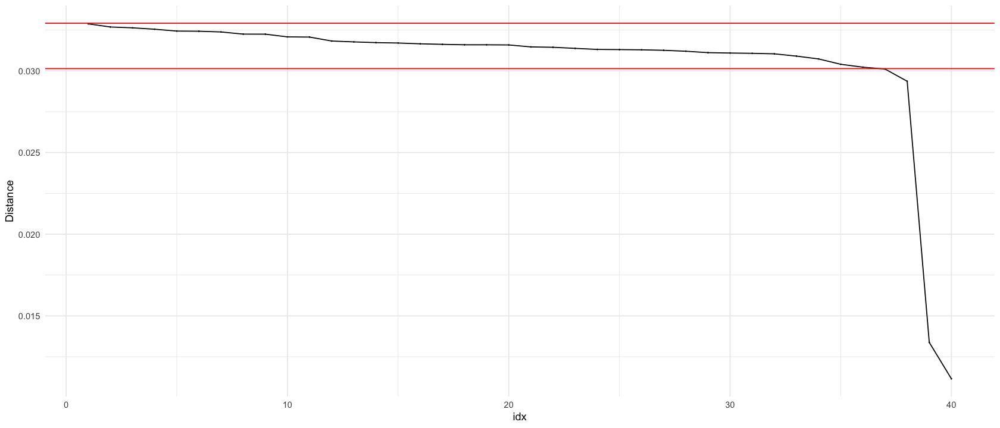

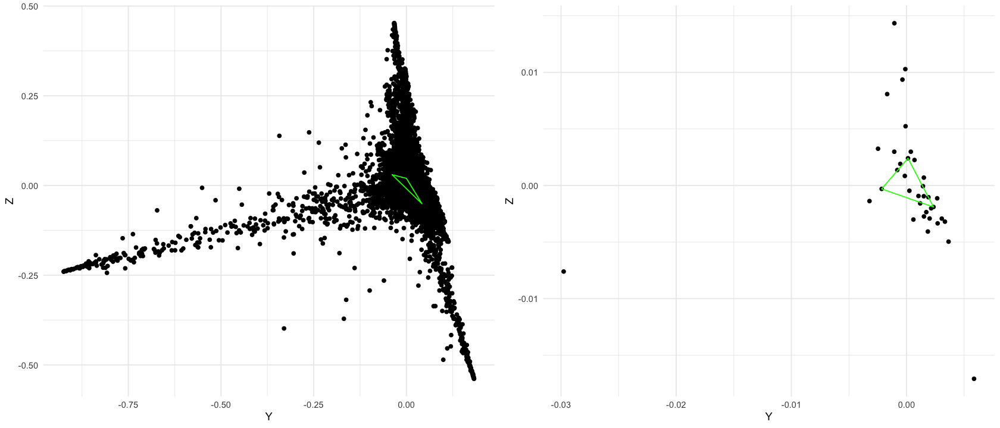

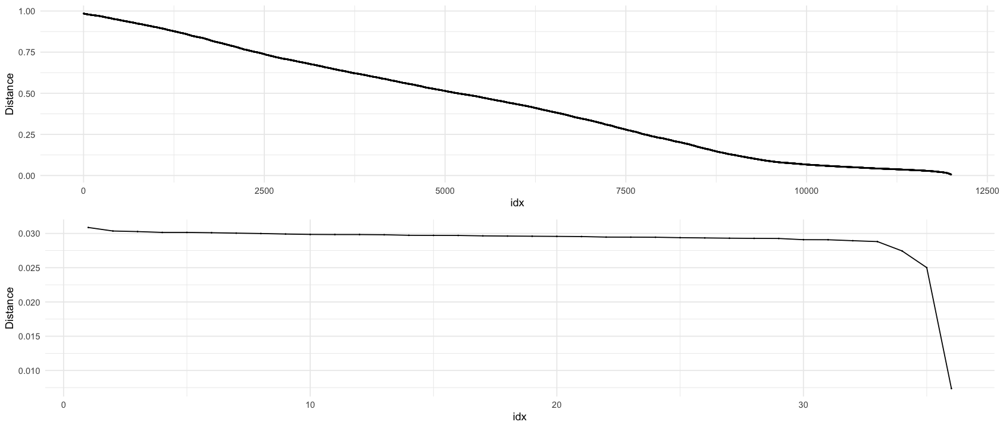

In [204]:
sim_65_samples_flt1 <- mad_cutoff(sim_65_lo2, samples = T)
sim_65_data_flt1 <- sim_65_data[, colnames(sim_65_data) %in% sim_65_samples_flt1]
sim_65_lo2_flt1 <- init_lo2(sim_65_data_flt1, 12000)

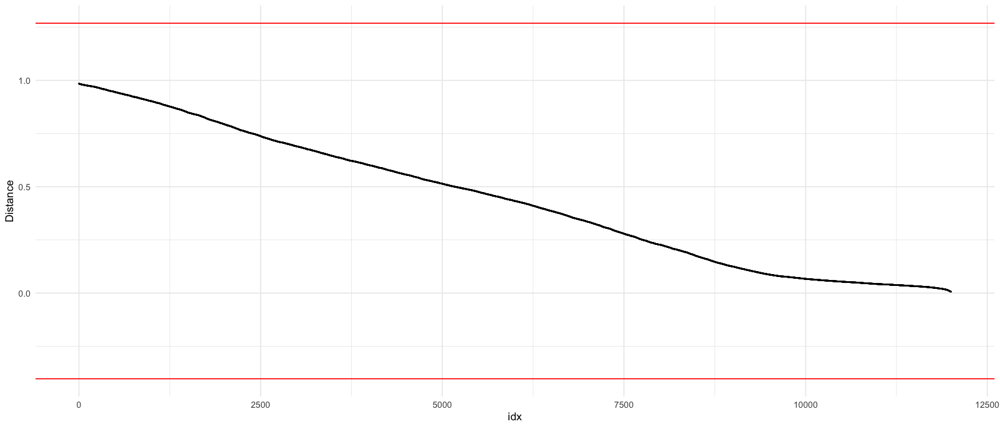

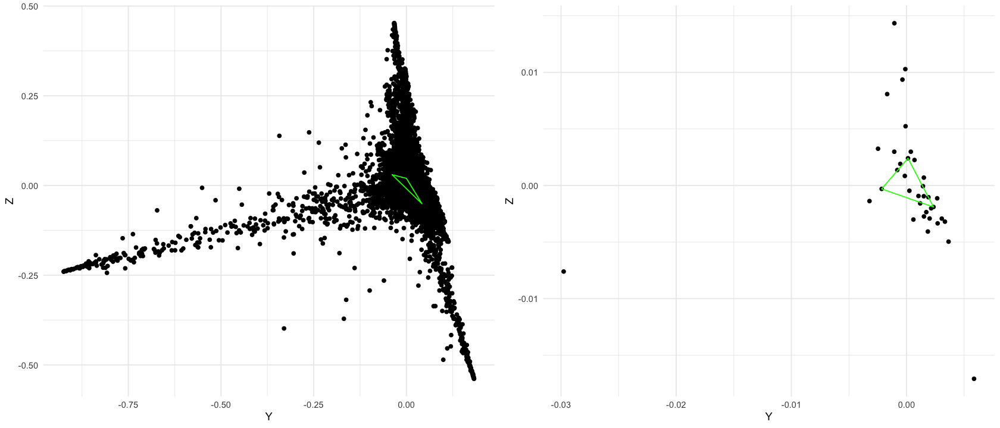

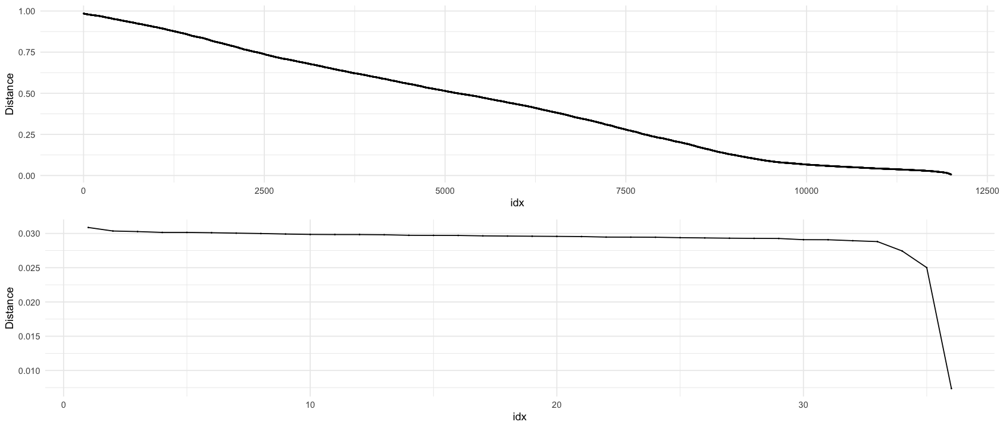

In [205]:
sim_65_genes_flt2 <- mad_cutoff(sim_65_lo2_flt1, samples = F)
sim_65_data_flt2 <- sim_65_data_flt1[rownames(sim_65_data) %in% sim_65_genes_flt2,]
sim_65_lo2_flt2 <- init_lo2(sim_65_data_flt2, nrow(sim_65_data_flt2))

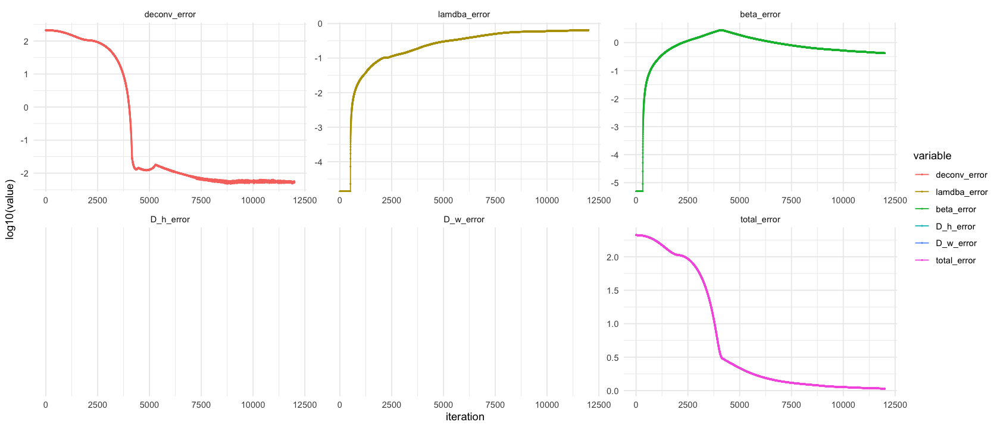

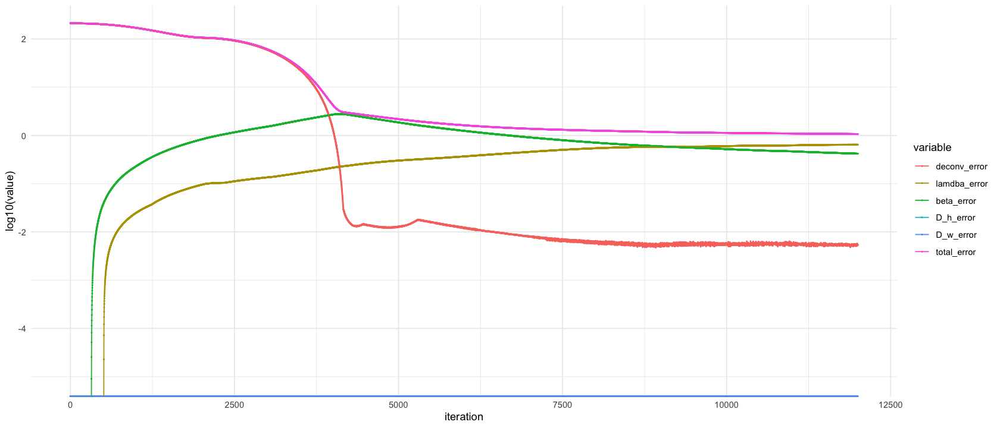

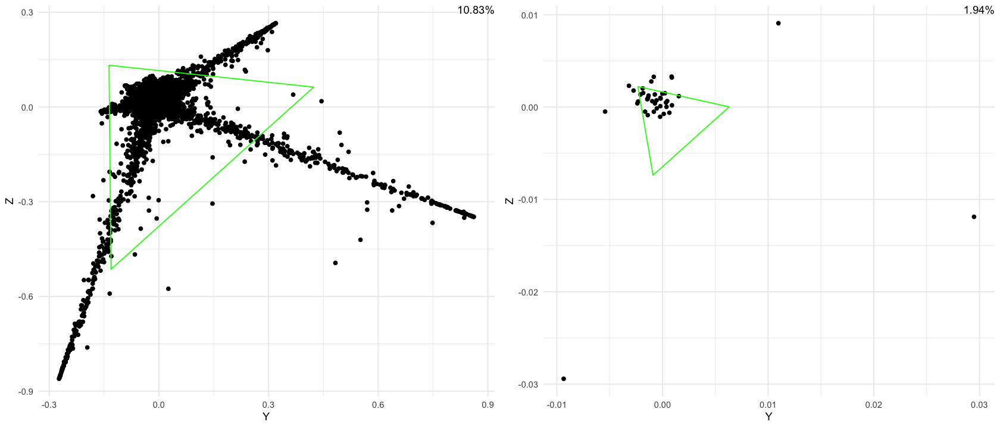

In [220]:
run_block(sim_65_lo2, iterations = 6000, startWithInit = F)

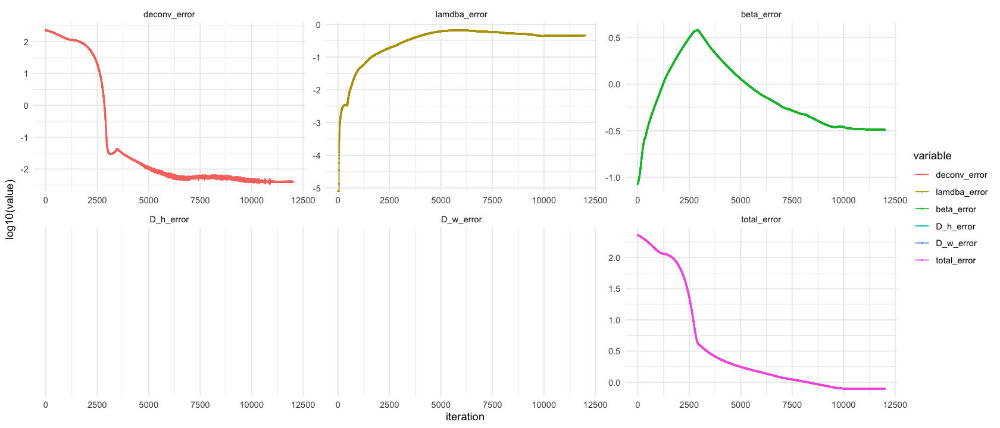

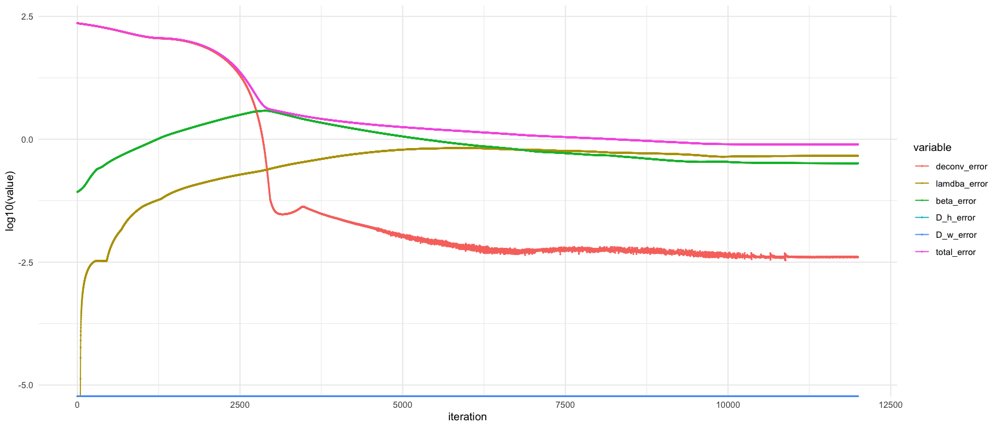

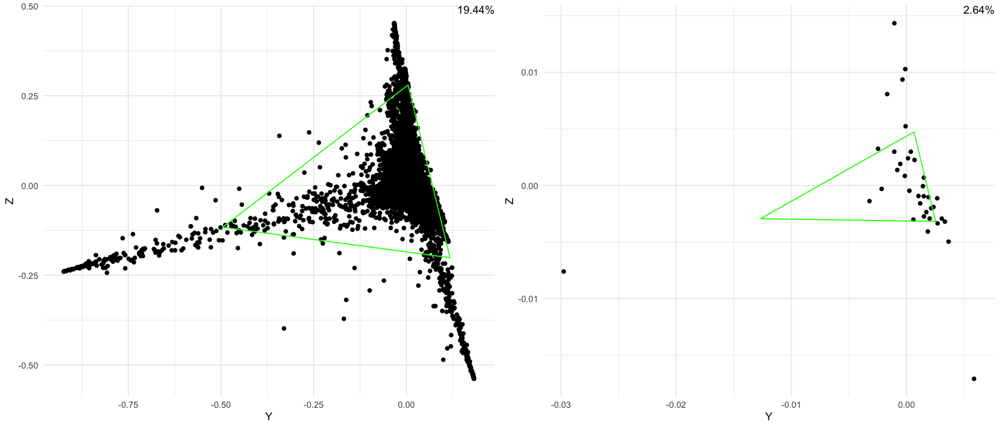

In [221]:
run_block(sim_65_lo2_flt1, iterations = 6000, startWithInit = F)

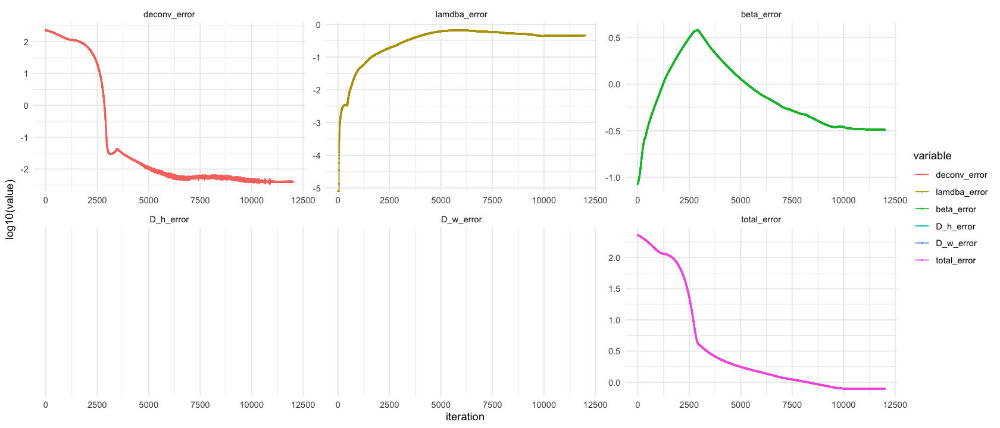

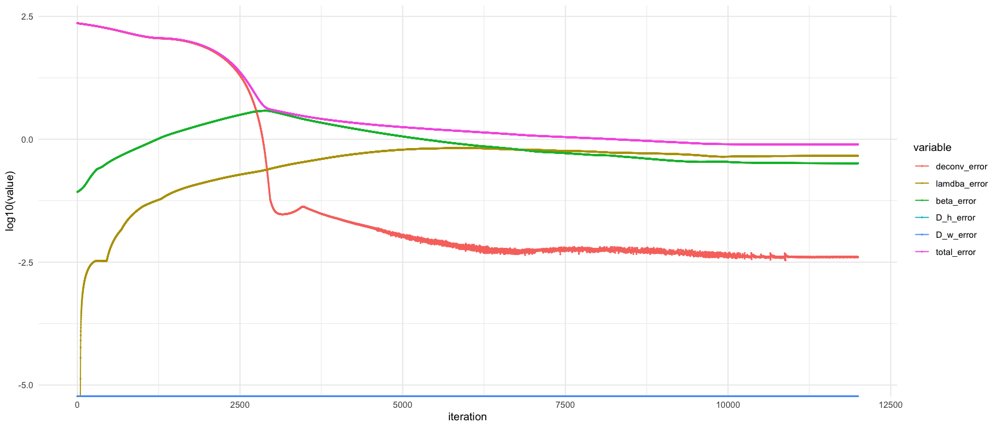

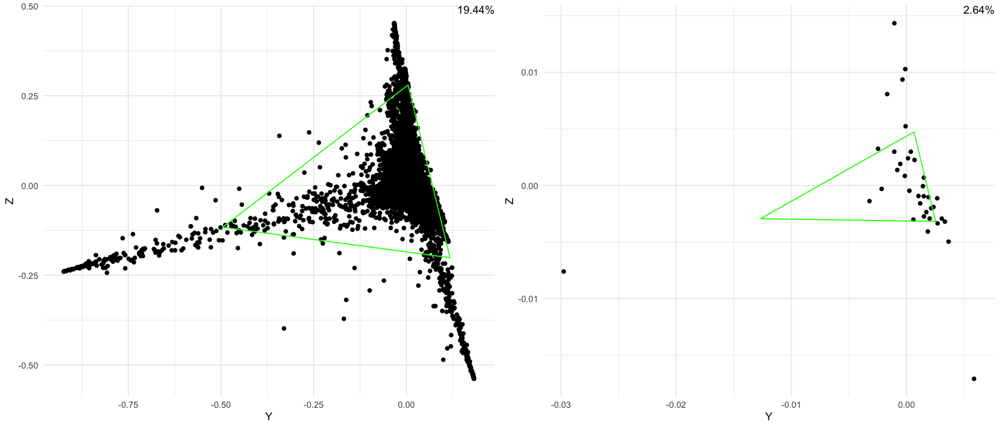

In [222]:
run_block(sim_65_lo2_flt2, iterations = 6000, startWithInit = F)